- load data
- build labeled iterator
- build validation iterator
- build networks
- load pretrained network
- build PUMAP
- for each epoch
  - build umap graph
  - create data iterator
  - train epoch

In [1]:
# reload packages
%load_ext autoreload
%autoreload 2

### Choose GPU

In [2]:
%env CUDA_DEVICE_ORDER=PCI_BUS_ID
%env CUDA_VISIBLE_DEVICES=1

env: CUDA_DEVICE_ORDER=PCI_BUS_ID
env: CUDA_VISIBLE_DEVICES=1


In [3]:
import tensorflow as tf
gpu_devices = tf.config.experimental.list_physical_devices('GPU')
if len(gpu_devices)>0:
    tf.config.experimental.set_memory_growth(gpu_devices[0], True)
print(gpu_devices)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [4]:
tf.keras.backend.clear_session()

### dataset information

In [5]:
from datetime import datetime

dataset = "cifar10"
dims = (32, 32, 3)
umap_prop = 1.0
num_classes = 10
PROJECTION_DIMS = 1024
labels_per_class = 1024  #'full'
datestring = datetime.now().strftime("%Y_%m_%d_%H_%M_%S_%f")
datestring = (
    str(dataset)
    + "_"
    + str(umap_prop)
    + "_"
    + str(PROJECTION_DIMS)
    + "_"
    + str(labels_per_class)
    + "____"
    + datestring
    + "__learned-metric"
)
print(datestring)

cifar10_1.0_1024_1024____2020_08_06_23_12_19_608880__learned-metric


### Load packages

In [6]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm
from IPython import display
import pandas as pd
import umap
import copy
import os, tempfile

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


### Load dataset

In [7]:
from tfumap.load_datasets import load_CIFAR10, mask_labels

In [8]:
X_train, X_test, X_valid, Y_train, Y_test, Y_valid = load_CIFAR10(flatten=False)
X_train.shape

(40000, 32, 32, 3)

In [9]:
if labels_per_class == "full":
    X_labeled = X_train
    Y_masked = Y_labeled = Y_train
else:
    X_labeled, Y_labeled, Y_masked = mask_labels(
        X_train, Y_train, labels_per_class=labels_per_class
    )

### Build data iterators

In [56]:
from tfumap.umap import compute_cross_entropy, get_graph_elements
from tfumap.semisupervised import create_edge_iterator, create_validation_iterator, create_classification_iterator

In [11]:
batch_size = 256

In [16]:
labeled_batch_size = 128
labeled_iter = create_classification_iterator(X_labeled, Y_labeled, labeled_batch_size)

In [17]:
X, y = next(iter(labeled_iter))

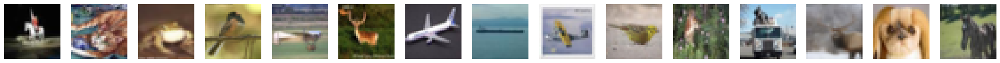

In [18]:
# view augmentations
nex = 15
fig, axs = plt.subplots(ncols=nex, figsize=(nex*2, 2))
for i in range(nex):
    axs[i].imshow(X[i])
    axs[i].axis('off')

In [19]:
data_valid, n_valid_samp = create_validation_iterator(X_valid, Y_valid, batch_size, repeat=True)

### Build network

In [20]:

from tensorflow.keras import layers
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import MaxPool2D
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Activation
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

block_layers_num = 3
weight_decay = 1e-4
name = 'resnet20'
def conv2d_bn(x, filters, kernel_size, weight_decay=.0, strides=(1, 1)):
    layer = Conv2D(filters=filters,
                   kernel_size=kernel_size,
                   strides=strides,
                   padding='same',
                   use_bias=False,
                   kernel_regularizer=l2(weight_decay)
                   )(x)
    layer = BatchNormalization()(layer)
    return layer


def conv2d_bn_relu(x, filters, kernel_size, weight_decay=.0, strides=(1, 1)):
    layer = conv2d_bn(x, filters, kernel_size, weight_decay, strides)
    layer = Activation('relu')(layer)
    return layer


def ResidualBlock(x, filters, kernel_size, weight_decay, downsample=True):
    if downsample:
        # residual_x = conv2d_bn_relu(x, filters, kernel_size=1, strides=2)
        residual_x = conv2d_bn(x, filters, kernel_size=1, strides=2)
        stride = 2
    else:
        residual_x = x
        stride = 1
    residual = conv2d_bn_relu(x,
                              filters=filters,
                              kernel_size=kernel_size,
                              weight_decay=weight_decay,
                              strides=stride,
                              )
    residual = conv2d_bn(residual,
                         filters=filters,
                         kernel_size=kernel_size,
                         weight_decay=weight_decay,
                         strides=1,
                         )
    out = layers.add([residual_x, residual])
    out = Activation('relu')(out)
    return out



input_ = Input(shape=dims)
x =input_
x = conv2d_bn_relu(x, filters=16, kernel_size=(3, 3), weight_decay=weight_decay, strides=(1, 1))

# # conv 2
for i in range(block_layers_num):
    x = ResidualBlock(x, filters=16, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
# # conv 3
x = ResidualBlock(x, filters=32, kernel_size=(3, 3), weight_decay=weight_decay, downsample=True)
for i in range(block_layers_num - 1):
    x = ResidualBlock(x, filters=32, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
# # conv 4
x = ResidualBlock(x, filters=64, kernel_size=(3, 3), weight_decay=weight_decay, downsample=True)
for i in range(block_layers_num - 1):
    x = ResidualBlock(x, filters=64, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
x = AveragePooling2D(pool_size=(8, 8), padding='valid')(x)
x = Flatten()(x)
encoder = Model(input_, x, name=name)

In [21]:
classifier = tf.keras.Sequential()
classifier.add(tf.keras.layers.InputLayer(input_shape=64))
classifier.add(tf.keras.layers.Dense(units=256, activation="relu"))
classifier.add(tf.keras.layers.Dense(units=256, activation="relu"))
classifier.add(tf.keras.layers.Dense(num_classes, activation='softmax', name="predictions"))

In [22]:
encoder.summary()

Model: "resnet20"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 32, 32, 16)   432         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 32, 32, 16)   64          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 32, 32, 16)   0           batch_normalization[0][0]        
___________________________________________________________________________________________

### load weights

In [25]:
from umap import UMAP

In [26]:
from tfumap.paths import MODEL_DIR

In [27]:
load_loc = "cifar10_0.0_1024_1024____2020_07_31_16_09_01_387660"
encoder.load_weights((MODEL_DIR / 'semisupervised' / dataset / load_loc / "encoder").as_posix())
classifier.load_weights((MODEL_DIR / 'semisupervised' / dataset / load_loc / "classifier").as_posix())

### Look at pretrained state

In [28]:
def model_data(X, batch_size, model):
    """ embed a set of points in X to Z
    """
    n_batch = int(np.ceil(len(X) / batch_size))
    return np.vstack(
        [
                model(np.array(X[(i) * batch_size : (i + 1) * batch_size, :]))
            for i in tqdm(range(n_batch), leave=False)
        ]
    )

In [29]:
pred_model = tf.keras.models.Model(classifier.input,[classifier.get_layer(name="dense_1").get_output_at(0)])

In [30]:
z_enc = model_data(X_valid, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)

In [31]:
valid_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_valid, z_pred
).numpy()
print(np.mean(valid_acc))

0.5769


In [32]:
umap_class = UMAP(verbose=True).fit_transform(last_layer_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Thu Aug  6 23:13:55 2020 Finding Nearest Neighbors
Thu Aug  6 23:13:55 2020 Building RP forest with 10 trees
Thu Aug  6 23:13:56 2020 parallel NN descent for 13 iterations
	 0  /  13
	 1  /  13
	 2  /  13
Thu Aug  6 23:14:05 2020 Finished Nearest Neighbor Search
Thu Aug  6 23:14:07 2020 Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Thu Aug  6 23:14:23 2020 Finished embedding


In [33]:
conf_thresh =  0.99
conf_mask = confidence > conf_thresh
umap_class_conf = UMAP(verbose=True).fit_transform(last_layer_class[conf_mask])

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Thu Aug  6 23:14:23 2020 Finding Nearest Neighbors
Thu Aug  6 23:14:23 2020 Building RP forest with 10 trees
Thu Aug  6 23:14:24 2020 parallel NN descent for 13 iterations
	 0  /  13
	 1  /  13
	 2  /  13
Thu Aug  6 23:14:24 2020 Finished Nearest Neighbor Search
Thu Aug  6 23:14:24 2020 Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Thu Aug  6 23:14:40 2020 Finished embedding


In [34]:
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_valid

Text(0.5, 1.0, 'Confidence')

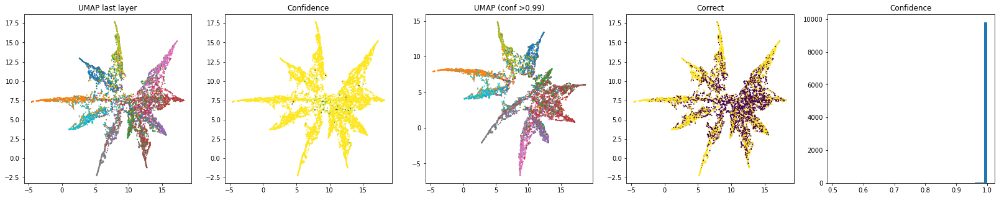

In [35]:
fig, axs = plt.subplots(ncols = 5, figsize=(28,5))
axs[0].scatter(umap_class[:,0], umap_class[:,1], s=1, c = Y_valid, cmap = plt.cm.tab10)
axs[0].set_title('UMAP last layer')
axs[1].scatter(umap_class[:,0], umap_class[:,1], s=1, c = confidence, cmap = plt.cm.viridis)
axs[1].set_title('Confidence')
axs[2].scatter(umap_class_conf[:,0], umap_class_conf[:,1], s=1, c = Y_valid[conf_mask], cmap = plt.cm.tab10)
axs[2].set_title('UMAP (conf >{})'.format(conf_thresh) )
axs[3].scatter(umap_class[:,0], umap_class[:,1], s=1, c = correctness, cmap = plt.cm.viridis)
axs[3].set_title('Correct')
axs[4].hist((confidence), bins = 50);
axs[4].set_title('Confidence')

In [36]:
len(z_pred[Y_valid])

10000

In [37]:
correct_pred =[i[j] for i,j in zip(z_pred, Y_valid)]

Text(0, 0.5, 'correct_pred')

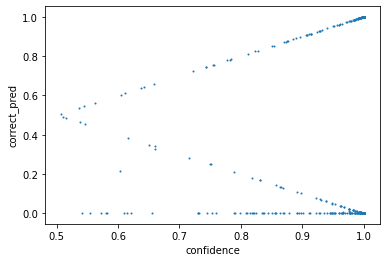

In [38]:
plt.scatter(confidence, correct_pred, s=1)
plt.xlabel('confidence')
plt.ylabel('correct_pred')

### Create UMAP object

In [39]:
from tfumap.semisupervised_model import PUMAP, compute_classifier_loss

In [40]:
def compute_umap_loss(
    batch_to,
    batch_from,
    encoder,
    _a,
    _b,
    negative_sample_rate=5,
    repulsion_strength=1,
):
    """
        compute the cross entropy loss for learning embeddings

        Parameters
        ----------
        batch_to : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (to)
        batch_from : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (from)

        Returns
        -------
        ce_loss : tf.float
            cross entropy loss for UMAP
        embedding_to : tf.float
            embeddings for verticies (to)
        embedding_from : tf.float
            embeddings for verticies (from)
        """

    # encode
    embedding_to = encoder(batch_to)
    embedding_from = encoder(batch_from)

    # get negative samples
    embedding_neg_to = tf.repeat(embedding_to, negative_sample_rate, axis=0)
    repeat_neg = tf.repeat(embedding_from, negative_sample_rate, axis=0)
    embedding_neg_from = tf.gather(
        repeat_neg, tf.random.shuffle(tf.range(tf.shape(repeat_neg)[0]))
    )

    #  distances between samples
    distance_embedding = tf.concat(
        [
            tf.norm(embedding_to - embedding_from, axis=1),
            tf.norm(embedding_neg_to - embedding_neg_from, axis=1),
        ],
        axis=0,
    )

    # convert probabilities to distances
    probabilities_distance = convert_distance_to_probability(distance_embedding, _a, _b)

    # treat positive samples as p=1, and negative samples as p=0
    probabilities_graph = tf.concat(
        [tf.ones(embedding_to.shape[0]), tf.zeros(embedding_neg_to.shape[0])], axis=0,
    )

    # cross entropy loss
    (attraction_loss, repellant_loss, ce_loss) = compute_cross_entropy(
        probabilities_graph,
        probabilities_distance,
        repulsion_strength=repulsion_strength,
    )

    return (
        attraction_loss,
        repellant_loss,
        ce_loss,
    )


In [41]:
import tensorflow as tf
from tfumap.umap import compute_cross_entropy, convert_distance_to_probability
from tfumap.semisupervised import (
    find_a_b,
    #compute_umap_loss,
    # compute_classifier_loss,
    batch_data,
)
import numpy as np
import os, tempfile
from tqdm.autonotebook import tqdm
from datetime import datetime


@tf.function
def compute_classifier_loss(X, y, encoder, classifier, sparse_ce, acc_func):
    """ compute the cross entropy loss for classification
        """
    d = classifier(encoder(X))
    loss = sparse_ce(y, d)
    acc = acc_func(y, d)
    #acc = tf.keras.metrics.sparse_categorical_accuracy(y, d)
    return loss, acc


class PUMAP(tf.keras.Model):
    def __init__(
        self,
        encoder,
        classifier,
        tensorboard_logdir=None,  # directory for tensorboard log
        min_dist=0.1,
        negative_sample_rate=5.0,
        optimizer=tf.keras.optimizers.SGD(0.1),
        repulsion_strength=1.0,
        # ** kwargs,
    ):
        super(PUMAP, self).__init__()
        # self.__dict__.update(kwargs)

        # subnetworks
        self.encoder = encoder
        self.classifier = classifier


        # optimizer for cross entropy minimization
        self.optimizer = optimizer
        self.repulsion_strength = repulsion_strength
        self.negative_sample_rate = negative_sample_rate

        # get a,b for current min_dist
        self._a, self._b = find_a_b(min_dist)

        # create summary writer to log loss information during training
        if tensorboard_logdir is None:
            self.tensorboard_logdir = os.path.join(
                tempfile.gettempdir(),
                "tensorboard",
                datetime.now().strftime("%Y%m%d-%H%M%S"),
            )
        else:
            self.tensorboard_logdir = tensorboard_logdir
        self.summary_writer_train = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/train"
        )
        self.summary_writer_valid = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/valid"
        )

        # sparse categorical cross entropy
        self.sparse_ce = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
        self.class_acc = tf.keras.metrics.SparseCategoricalAccuracy()
        self.class_acc_val = tf.keras.metrics.SparseCategoricalAccuracy()

        # self.create_summary_metrics()

    @tf.function
    def train(self, batch_to, batch_from, X, y, umap_prop = 1.0, save_loss=False):
        """ One training step 
        Input are points and weights for positive and negative 
        samples for training. 
            
        """
        if umap_prop > 0:
            with tf.GradientTape() as tape:

                (attraction_loss, repellant_loss, umap_loss) = compute_umap_loss(
                    batch_to,
                    batch_from,
                    self.encoder,
                    self._a,
                    self._b,
                    self.negative_sample_rate,
                    self.repulsion_strength,
                )
            
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = (
                    tf.reduce_mean(classifier_loss)
                    + tf.reduce_mean(umap_loss) * umap_prop
                )

            train_vars = (
                self.encoder.trainable_variables
                + self.classifier.trainable_variables
            )
        else:  # ignore running costly UMAP computations if not training on UMAP loss
            with tf.GradientTape() as tape:
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = classifier_loss
            train_vars = (
                self.encoder.trainable_variables + self.classifier.trainable_variables
            )
            attraction_loss = repellant_loss = umap_loss = 0

        # compute gradient for umap
        grad = tape.gradient(loss, train_vars)

        # gradients are cliped in UMAP implementation. Any effect here?
        grad = [tf.clip_by_value(grad, -4.0, 4.0) for grad in grad]

        self.optimizer.apply_gradients(zip(grad, train_vars))

        return (
            attraction_loss,
            repellant_loss,
            tf.reduce_mean(umap_loss),
            classifier_loss,
            classifier_acc,
        )

    @tf.function
    def write_losses(
        self,
        step,
        classifier_acc,
        classifier_loss,
        umap_loss,
        classifier_loss_val,
        classifier_acc_val,
    ):
        # write train loss
        with self.summary_writer_train.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss, step=step,
            )
            tf.summary.scalar(
                "umap_loss", umap_loss, step=step,
            )
            self.summary_writer_train.flush()
        # write valid loss
        with self.summary_writer_valid.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc_val, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss_val, step=step,
            )
            self.summary_writer_valid.flush()



In [42]:
### Initialize model
model = PUMAP(
    min_dist = 0.0,
    negative_sample_rate = 5, # how many negative samples per positive
    optimizer=tf.keras.optimizers.Adam(1e-3), # cross-entropy optimizer
    encoder=encoder,
    classifier=classifier,    
)

### plotting results

In [43]:
from tfumap.umap import retrieve_tensors
from sklearn.decomposition import PCA
import seaborn as sns
from umap import UMAP 

def plot_umap_classif_results(
    model,
    X_valid,
    Y_valid,
    X_train,
    X_labeled,
    Y_labeled,
    batch_size,
    dralg = PCA, #umap
    cmap="coolwarm",
    cmap2="bwr",
):
    # get loss dataframe from tensorboard
    try:
        loss_df = retrieve_tensors(model.tensorboard_logdir)
        losses_exist = True
    except ValueError as e:
        print(e)
        losses_exist = False

    pred_model = tf.keras.models.Model(model.classifier.input,[model.classifier.get_layer(name="dense_1").get_output_at(0)])

    # embed data
    enc_valid = model_data(X_valid, batch_size, model.encoder)
    class_valid = model_data(enc_valid, batch_size, pred_model)
    pred_valid = model_data(enc_valid, batch_size, model.classifier)

    enc_lab = model_data(X_labeled, batch_size, model.encoder)
    class_lab = model_data(enc_lab, batch_size, pred_model)
    pred_lab = model_data(enc_lab, batch_size, model.classifier)

    # get classifications and correctness
    classifications_valid = np.argmax(pred_valid, axis=1)
    correctness_valid = classifications_valid == Y_valid

    classifications_lab = np.argmax(pred_lab, axis=1)
    correctness_lab = classifications_lab == np.array(Y_labeled)

    confidence_lab  = np.max(pred_lab, axis=1)
    confidence_valid = np.max(pred_valid, axis=1)

    thresh = 0.0 #0.8
    mask_valid = confidence_valid > thresh
    mask_lab = confidence_lab > thresh

    # embed into 2D 
    dr = dralg()
    enc_valid_2 = dr.fit_transform(enc_valid[mask_valid])
    enc_lab_2 = dr.transform(enc_lab[mask_lab])



    dr = dralg()
    class_valid_2 = dr.fit_transform(class_valid[mask_valid])
    class_lab_2 = dr.transform(class_lab[mask_lab])
    
    fig, axs = plt.subplots(ncols=4, nrows=3, figsize=(14, 10), gridspec_kw = {'wspace':0, 'hspace':0})
    for row, (z_val, z_lab, z_title) in enumerate([
        [enc_valid_2, enc_lab_2, 'encoder'], 
        [class_valid_2, class_lab_2, 'last_layer_classifier'], 

    ]):
        for col, (y_valid, y_labeled, label_name) in enumerate([
            [Y_valid, Y_labeled, 'ground_truth'],
            [classifications_valid, classifications_lab, 'predictions'],
            [correctness_valid, correctness_lab, 'correctness'],
            [confidence_valid, confidence_lab, 'confidence'],
        ]):
            ax = axs[row, col]
            #ax.axis('off')
            if col == 0:
                ax.set_ylabel(z_title)
            if row == 0:
                ax.set_title(label_name)
            #ax.set_title(z_title + '_' + label_name)
            ax.scatter(
                z_val[:, 0],
                z_val[:, 1],
                c=y_valid[mask_valid],
                cmap=cmap if label_name not in ["correctness", "confidence"]  else 'viridis',  # "tab10"
                s=2,
                alpha=0.25,
                rasterized=True,
            )
            if False:
                ax.scatter(
                    z_lab[:, 0],
                    z_lab[:, 1],
                    c=y_labeled[mask_lab],
                    cmap=cmap if label_name not in ["correctness", "confidence"] else 'viridis',  # "tab10"
                    s=20,
                    alpha=0.25,
                    rasterized=True,
                )
            ax.set_xticks([])
            ax.set_yticks([])
        
    plt.show()
    
    fig, axs = plt.subplots(ncols=3, figsize=(13.4,3))
    if losses_exist:
        ax = axs[0]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "umap_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.legend(loc="upper right")
        ax.set_xscale("log")
        ax.set_title("UMAP loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[1]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="upper right")
        # ax.set_yscale("log")
        ax.set_title("Classif loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[2]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_acc"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="lower right")
        ax.set_title("Classif acc", fontsize=24)
        ax.set_ylabel("Acc")
    plt.show()

No objects to concatenate


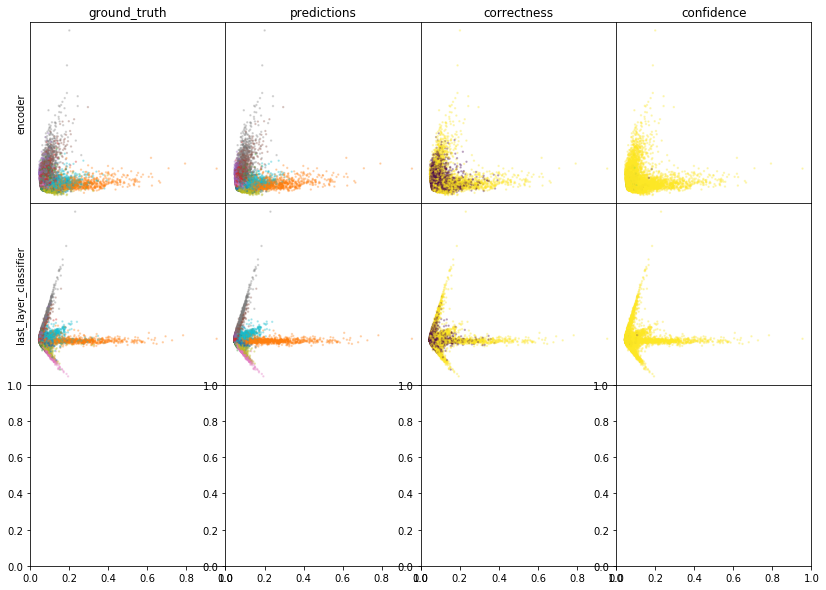

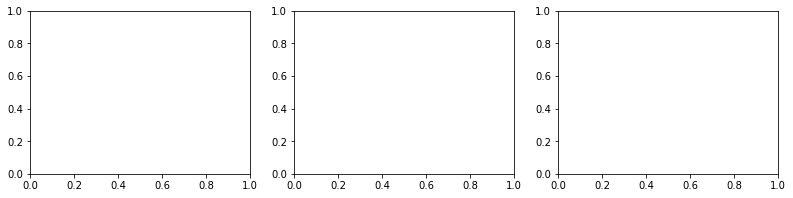

In [44]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=PCA, cmap='tab10', cmap2='tab10')

In [46]:
pred_model = tf.keras.models.Model(
        model.classifier.input,
        [model.classifier.get_layer(name="dense_1").get_output_at(0)],
    )

In [47]:
N_EPOCHS = 50
n_neighbors=15
batch_size = 256 # 500
max_sample_repeats_per_epoch = 25
max_save_delta = 0.005

In [48]:
from tfumap.semisupervised import build_fuzzy_simplicial_set

In [49]:
from tfumap.paths import MODEL_DIR

In [50]:
# where to save checkpoints
cpt_path = MODEL_DIR / 'semisupervised' / dataset / datestring

In [51]:
patience = 10000 # wait this many batches without improvement before early stopping
min_delta = 0.0001 # threshold for what counts as an improvement
best_acc = 0 # the best current accuracy score
best_saved_acc = 0 # best accuracy on valid data that has been checkpointed
best_saved_batch = 0 # batch number for last good batch
max_reinitialize_delta = .01 # minimum loss in accuracy resulting in reinitialized weights
plot_frequency = 1000 # how frequently to plot
max_reloads = 10 # how often can we reload weights?
batch = 0; epoch = 0
batches_since_last_reload = 0

In [52]:
epochs_without_improvement = 0
max_epochs_without_improvement = 5 # allow the network 
reload_tolerance = 100 # allow the network at least reload_tolerance batches before reloading last weights

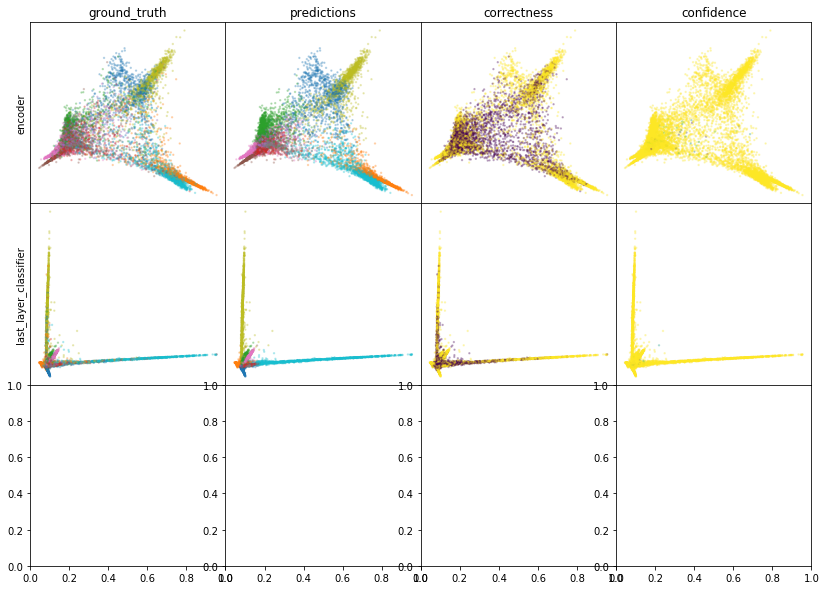

W0807 15:18:03.094779 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:18:04.027945 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:18:04.894248 140001524946752 legend.py:1282] No handles with labels found to put in legend.


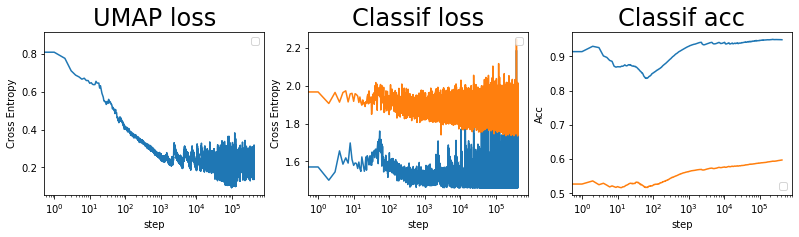

batch: 420000 | train acc: 0.9488 | val acc: 0.5976


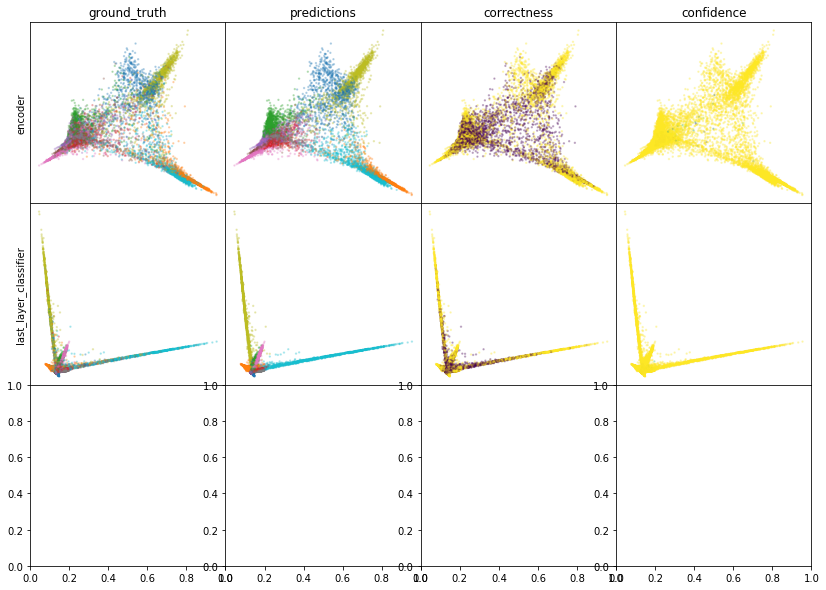

W0807 15:20:35.945275 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:20:36.876313 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:20:37.741818 140001524946752 legend.py:1282] No handles with labels found to put in legend.


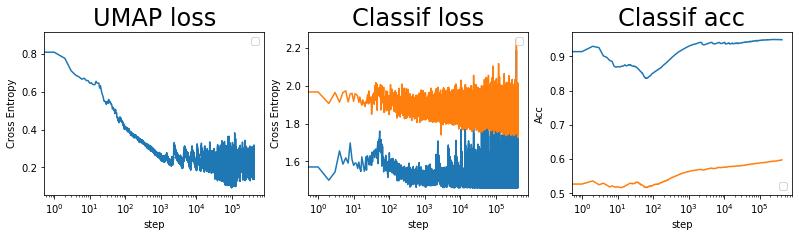

batch: 421000 | train acc: 0.9488 | val acc: 0.5976


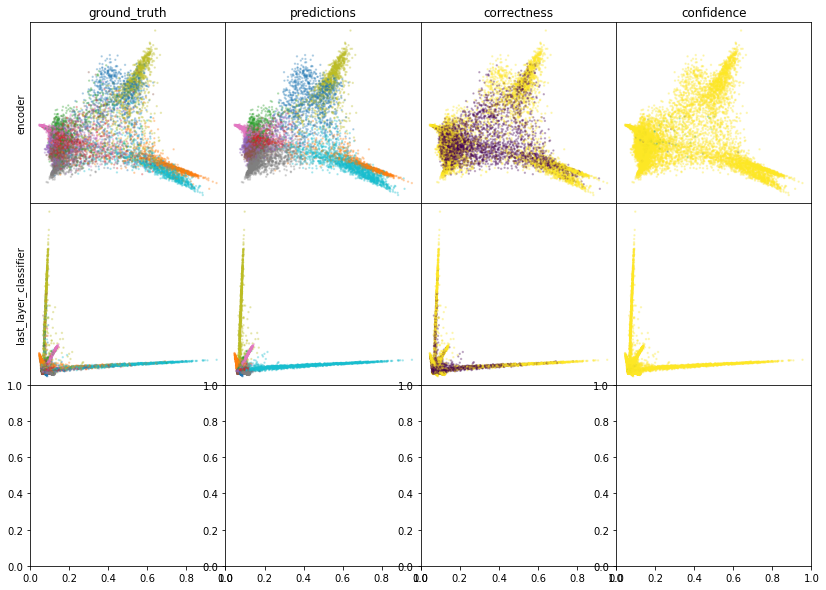

W0807 15:23:09.083476 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:23:10.015398 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:23:10.883956 140001524946752 legend.py:1282] No handles with labels found to put in legend.


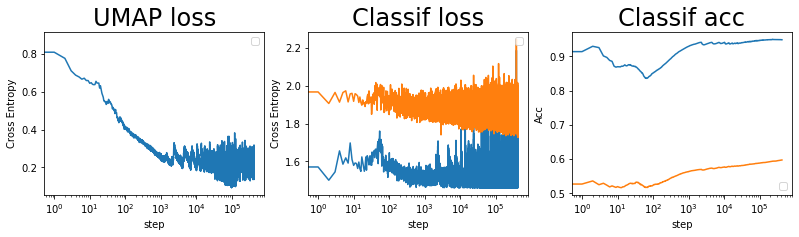

batch: 422000 | train acc: 0.9488 | val acc: 0.5977


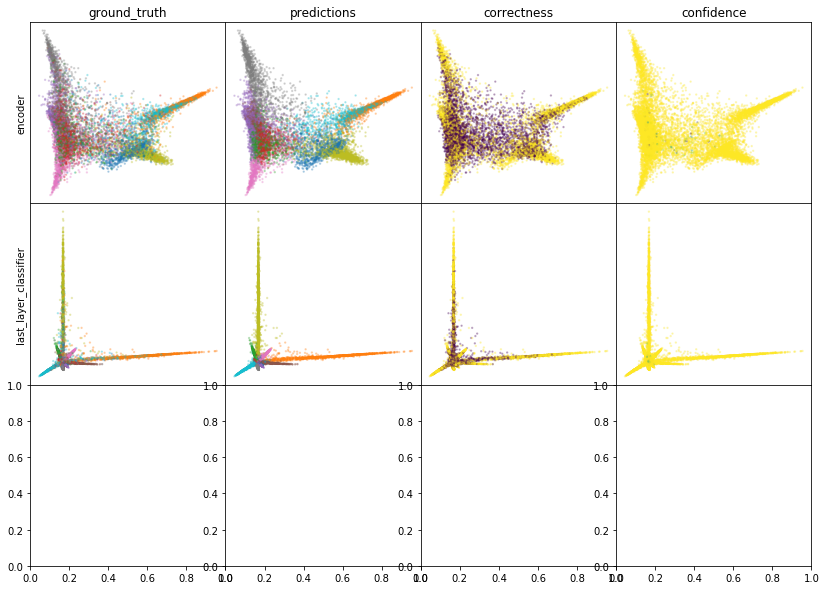

W0807 15:25:43.997047 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:25:44.929006 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:25:45.794739 140001524946752 legend.py:1282] No handles with labels found to put in legend.


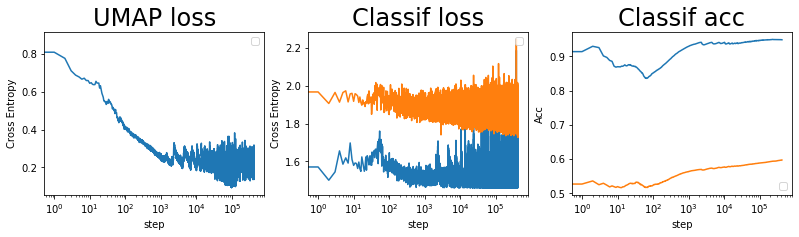

batch: 423000 | train acc: 0.9487 | val acc: 0.5976


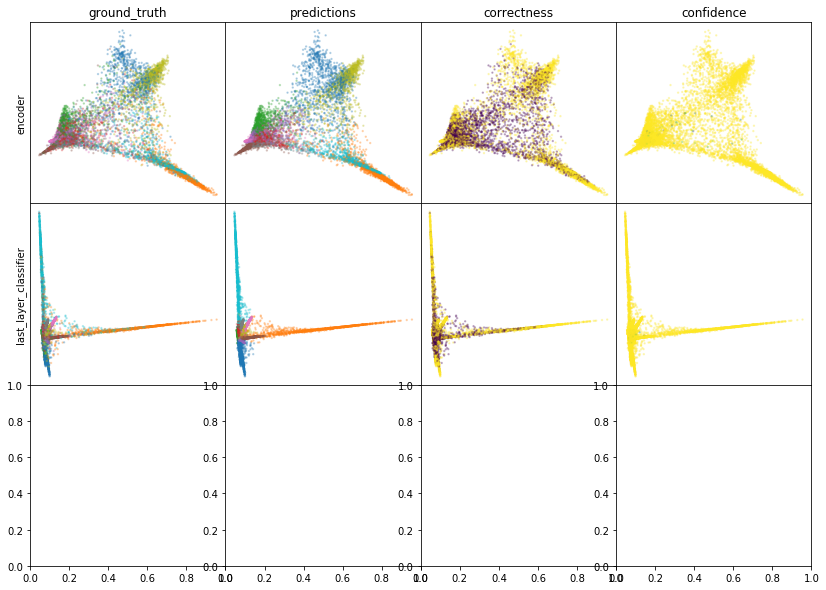

W0807 15:28:16.789424 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:28:17.720854 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:28:18.596923 140001524946752 legend.py:1282] No handles with labels found to put in legend.


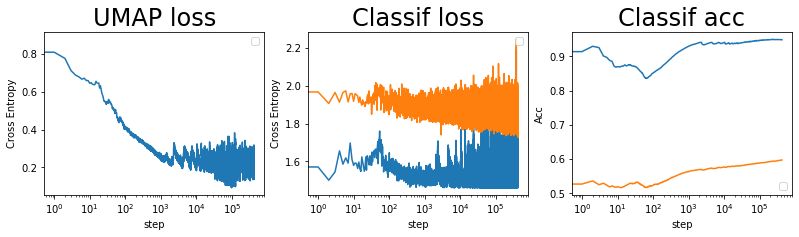

batch: 424000 | train acc: 0.9487 | val acc: 0.5977


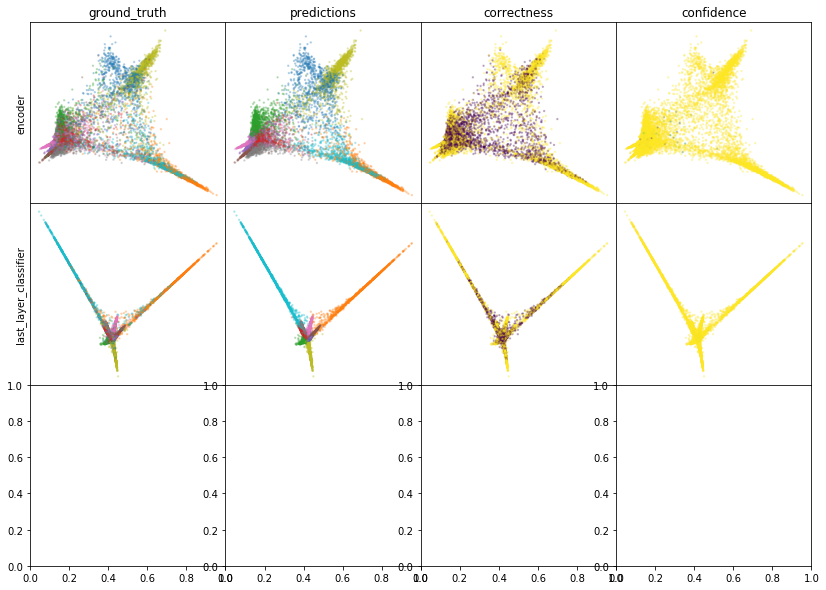

W0807 15:31:00.696934 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:31:01.634358 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:31:02.507108 140001524946752 legend.py:1282] No handles with labels found to put in legend.


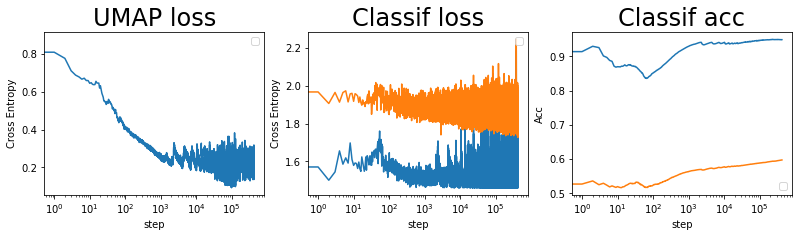

batch: 425000 | train acc: 0.9487 | val acc: 0.5977


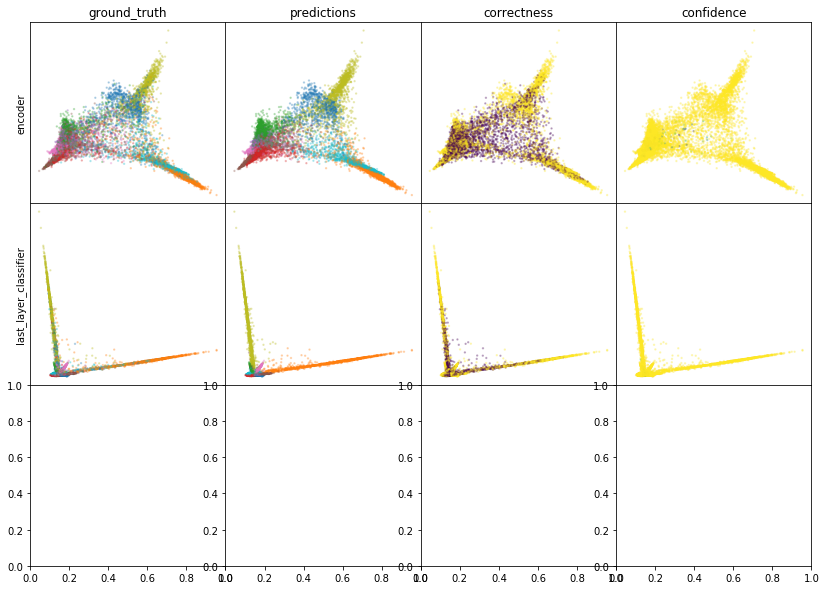

W0807 15:33:56.911659 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:33:58.050726 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:33:59.123769 140001524946752 legend.py:1282] No handles with labels found to put in legend.


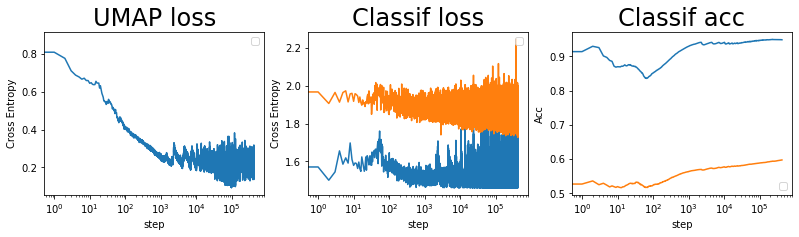

batch: 426000 | train acc: 0.9487 | val acc: 0.5977


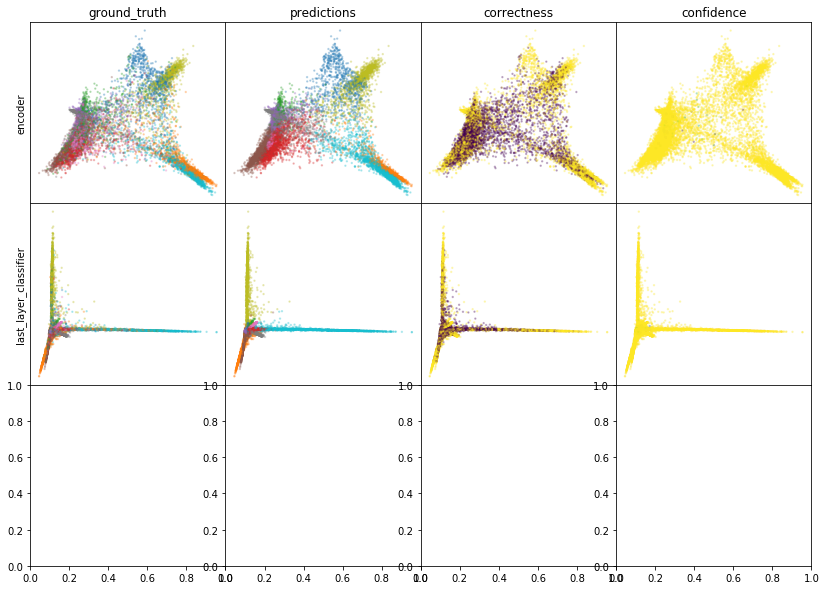

W0807 15:37:22.340925 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:37:23.527304 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:37:24.688179 140001524946752 legend.py:1282] No handles with labels found to put in legend.


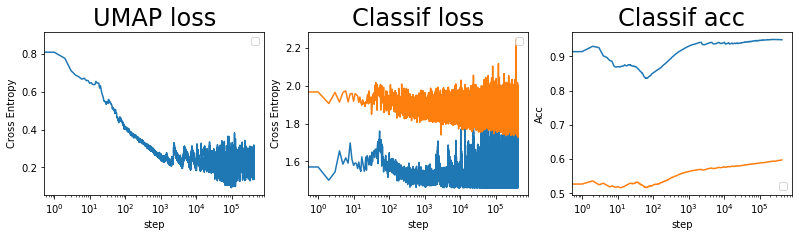

batch: 427000 | train acc: 0.9487 | val acc: 0.5978


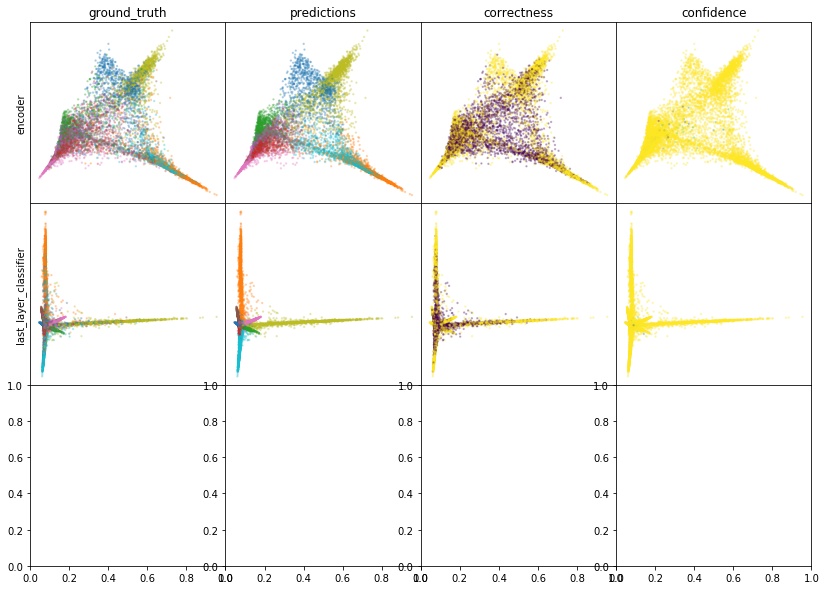

W0807 15:40:17.464562 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:40:18.624840 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:40:19.705359 140001524946752 legend.py:1282] No handles with labels found to put in legend.


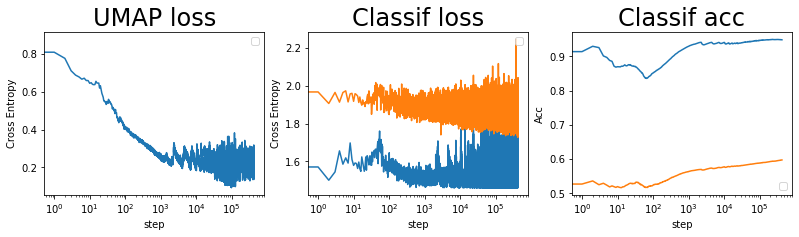

batch: 428000 | train acc: 0.9486 | val acc: 0.5978


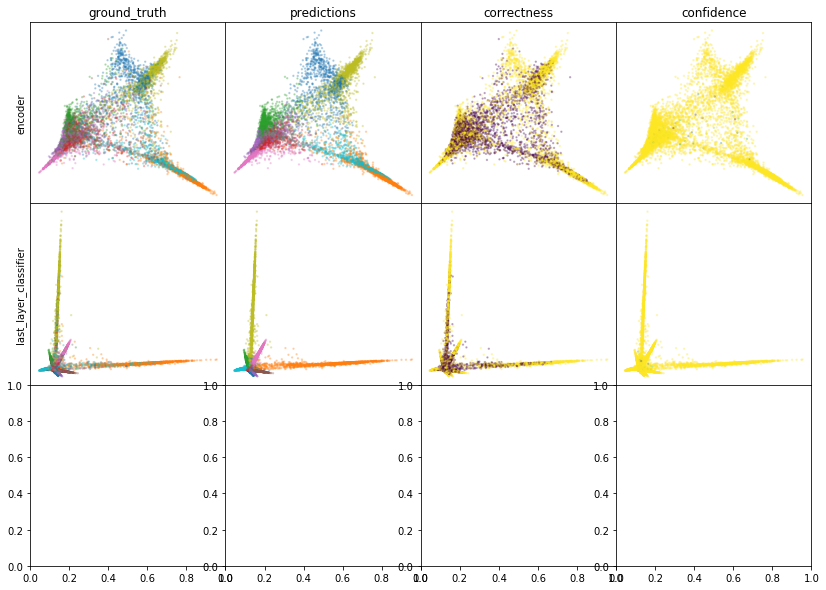

W0807 15:42:59.368610 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:43:00.318762 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:43:01.204670 140001524946752 legend.py:1282] No handles with labels found to put in legend.


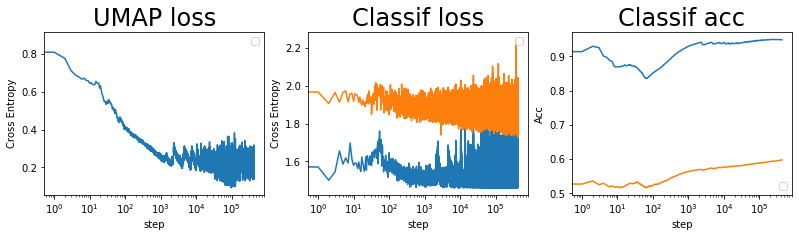

batch: 429000 | train acc: 0.9486 | val acc: 0.5978


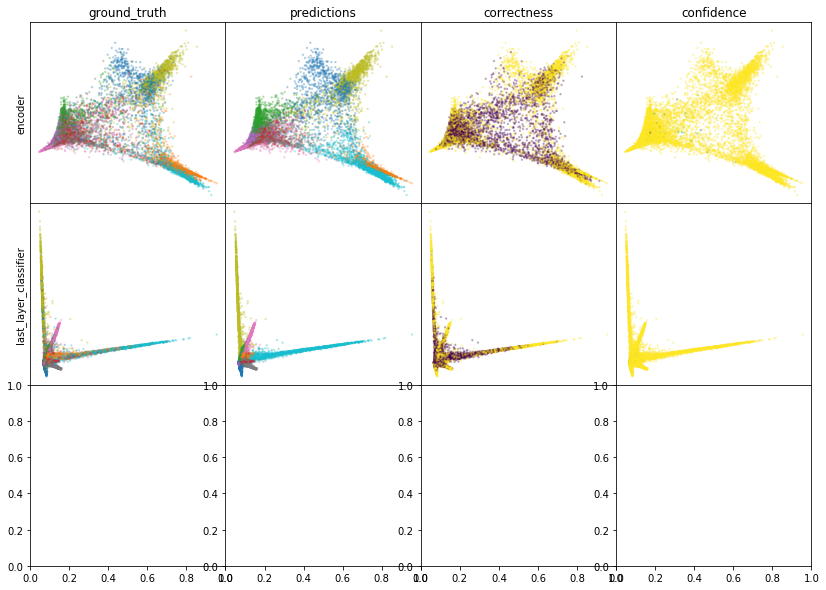

W0807 15:46:31.404875 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:46:32.799627 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:46:33.886152 140001524946752 legend.py:1282] No handles with labels found to put in legend.


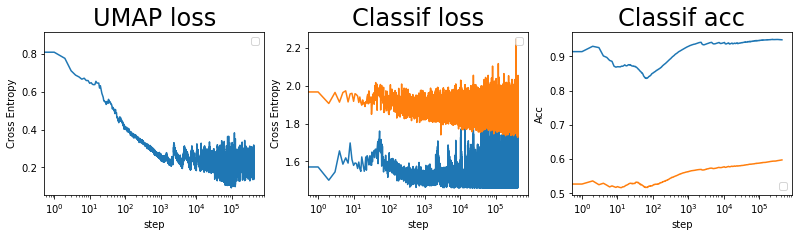

batch: 430000 | train acc: 0.9486 | val acc: 0.5978


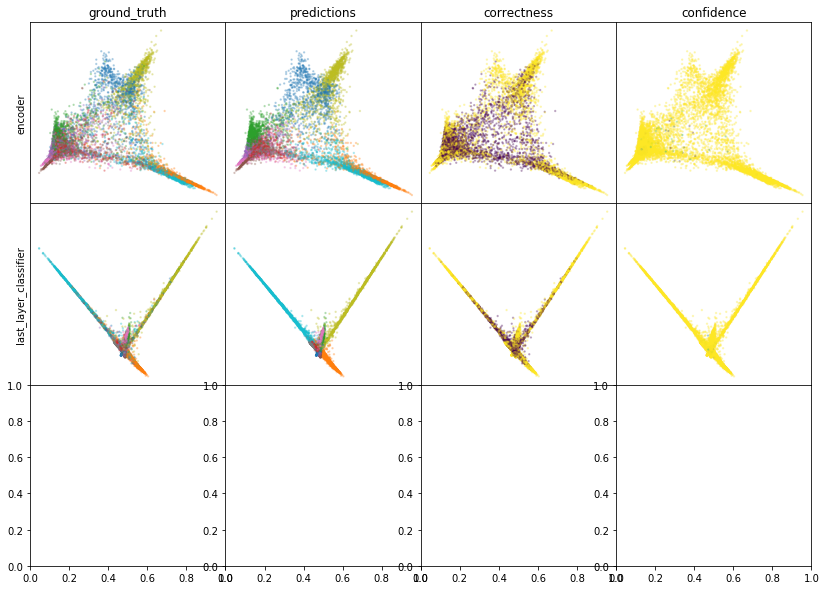

W0807 15:49:59.687434 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:50:00.862075 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:50:02.106973 140001524946752 legend.py:1282] No handles with labels found to put in legend.


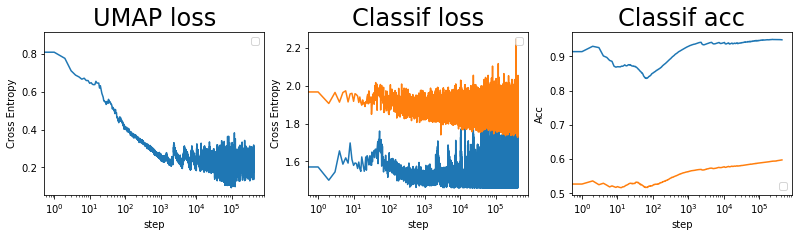

batch: 431000 | train acc: 0.9486 | val acc: 0.5978


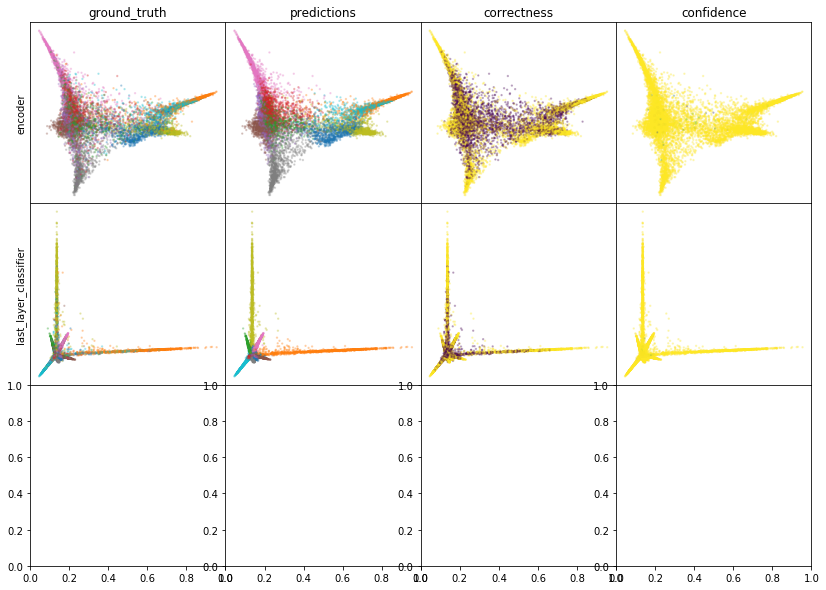

W0807 15:52:36.403387 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:52:37.361826 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:52:38.251657 140001524946752 legend.py:1282] No handles with labels found to put in legend.


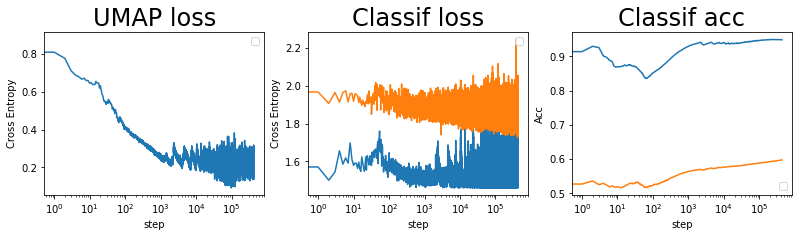

batch: 432000 | train acc: 0.9486 | val acc: 0.5978


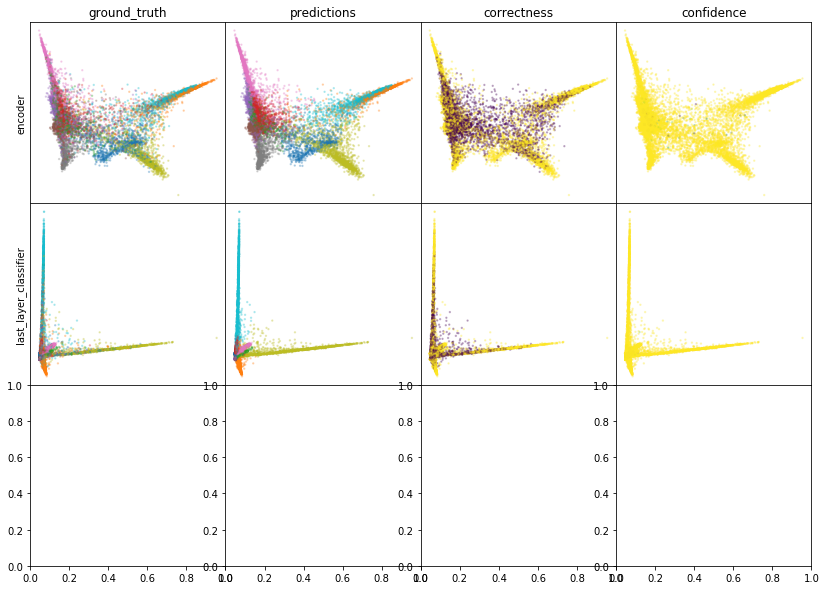

W0807 15:55:21.426298 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:55:22.401798 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:55:23.359369 140001524946752 legend.py:1282] No handles with labels found to put in legend.


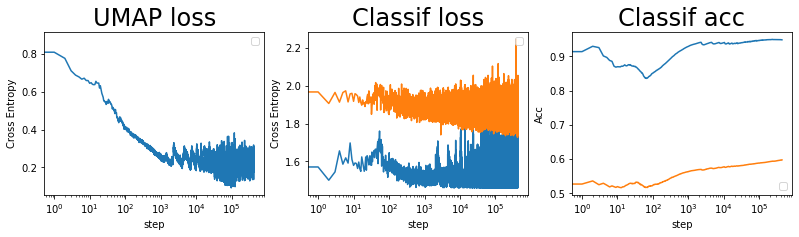

batch: 433000 | train acc: 0.9486 | val acc: 0.5979


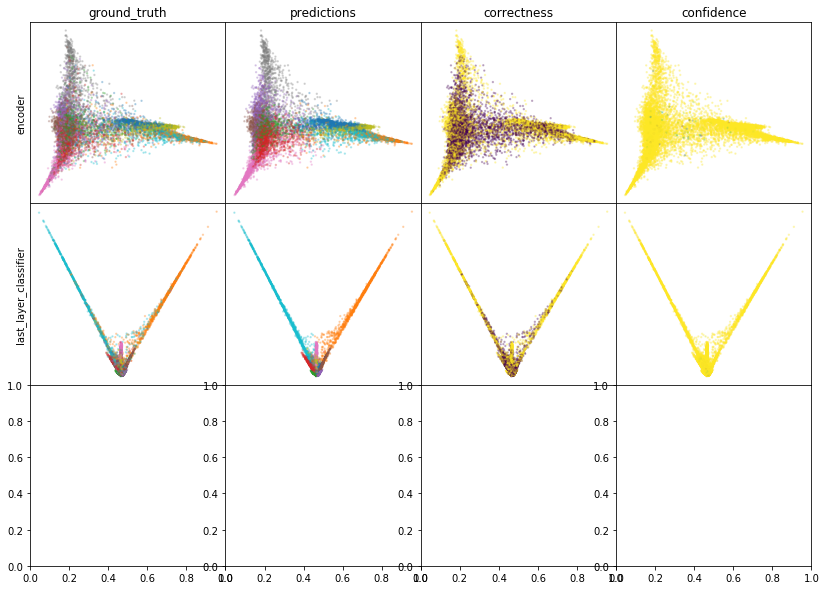

W0807 15:58:13.903837 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:58:14.955307 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 15:58:15.942664 140001524946752 legend.py:1282] No handles with labels found to put in legend.


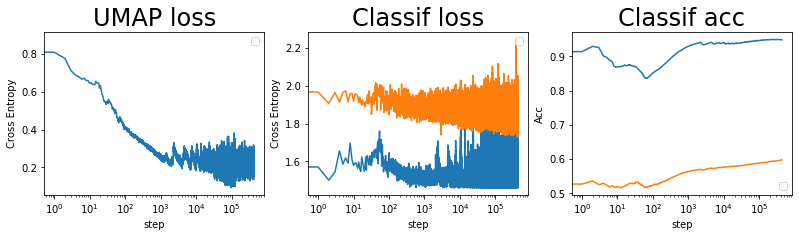

batch: 434000 | train acc: 0.9486 | val acc: 0.5979


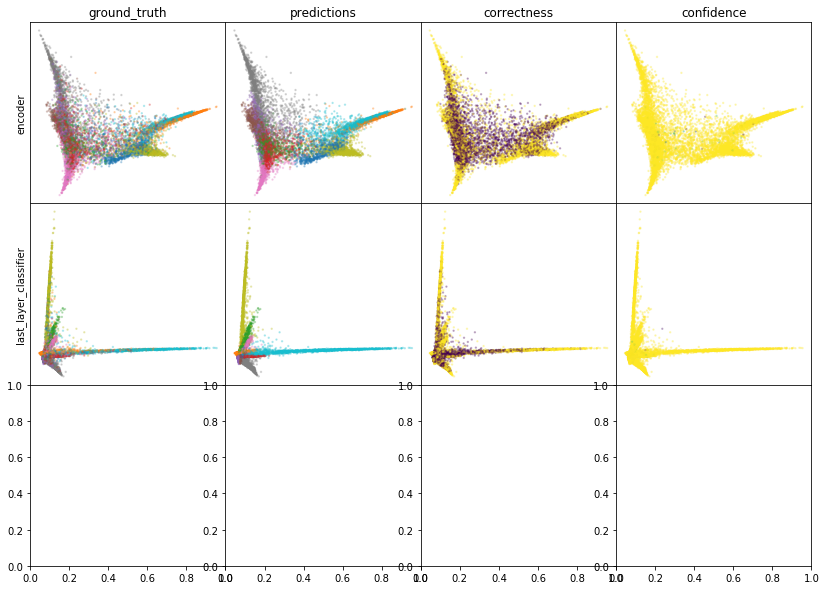

W0807 16:01:02.233990 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:01:03.306838 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:01:04.329778 140001524946752 legend.py:1282] No handles with labels found to put in legend.


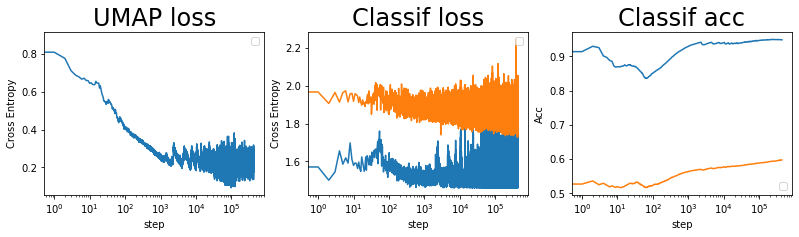

batch: 435000 | train acc: 0.9485 | val acc: 0.5979


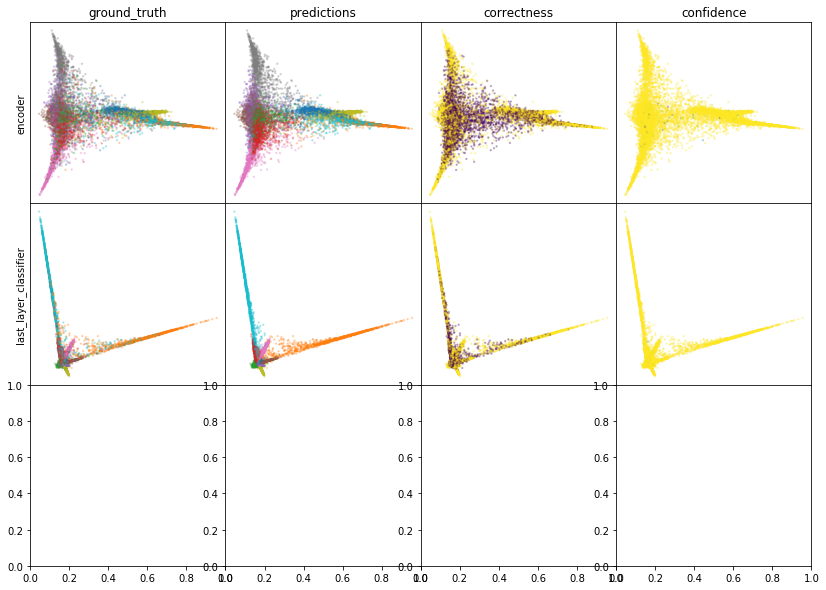

W0807 16:03:59.577527 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:04:00.596175 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:04:01.553504 140001524946752 legend.py:1282] No handles with labels found to put in legend.


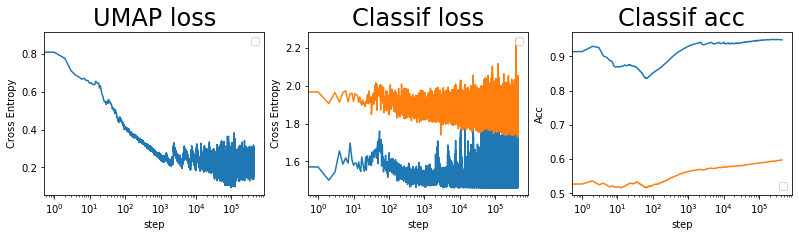

batch: 436000 | train acc: 0.9485 | val acc: 0.5979


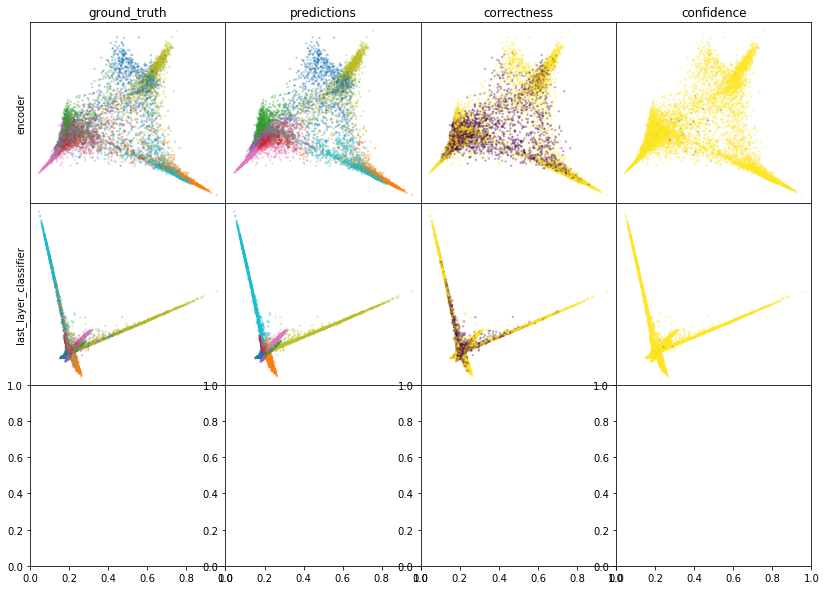

W0807 16:06:53.470176 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:06:54.550387 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:06:55.587827 140001524946752 legend.py:1282] No handles with labels found to put in legend.


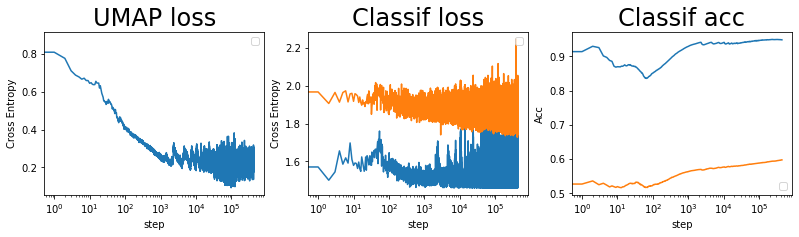

batch: 437000 | train acc: 0.9485 | val acc: 0.5979


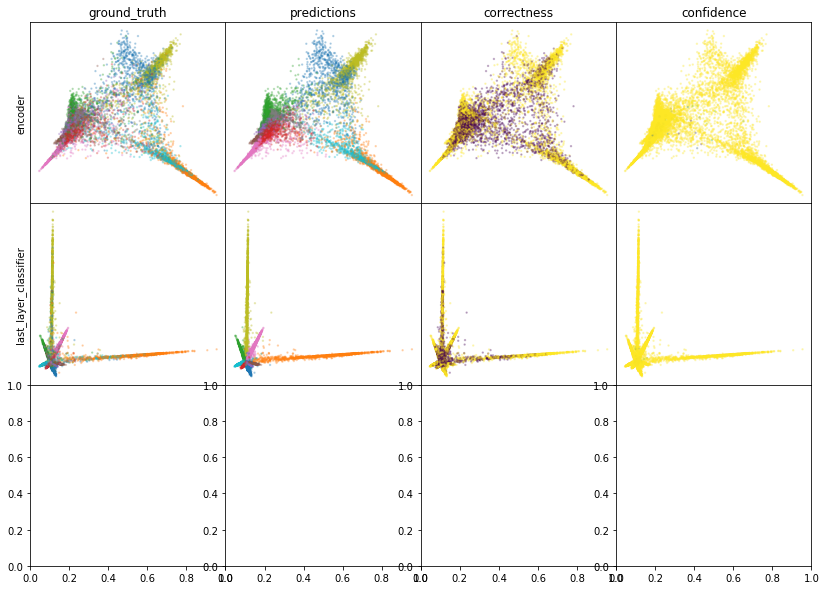

W0807 16:09:47.658377 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:09:48.692135 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:09:49.666969 140001524946752 legend.py:1282] No handles with labels found to put in legend.


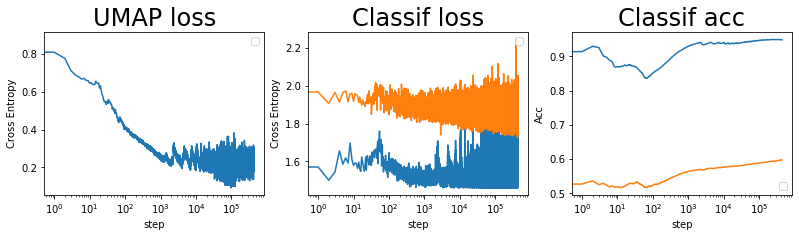

batch: 438000 | train acc: 0.9485 | val acc: 0.5979


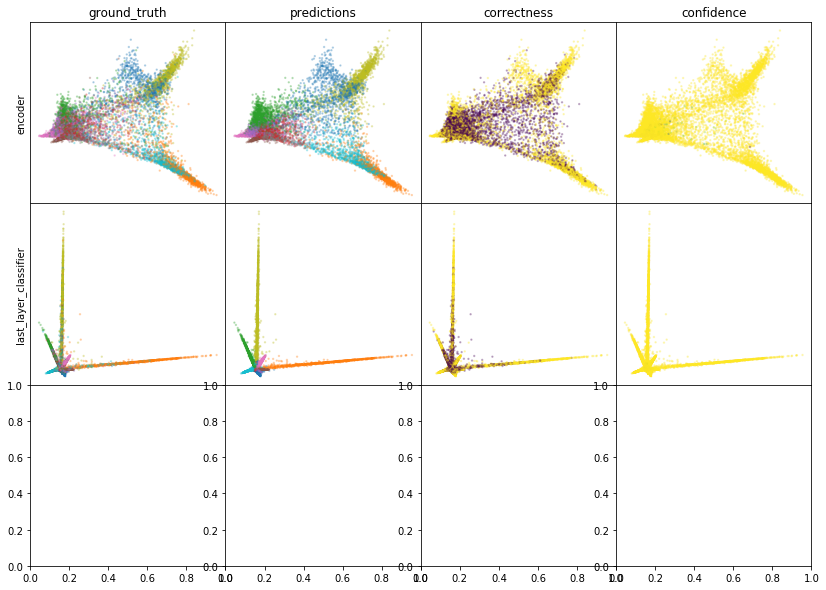

W0807 16:12:40.494376 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:12:41.527145 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:12:42.493614 140001524946752 legend.py:1282] No handles with labels found to put in legend.


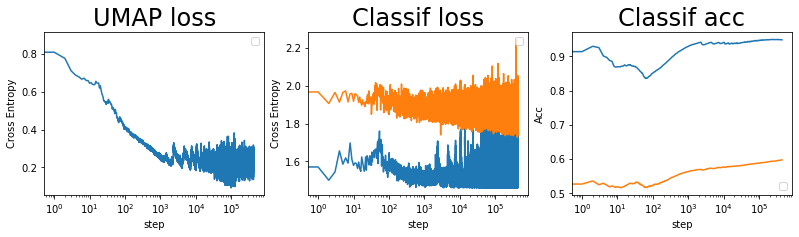

batch: 439000 | train acc: 0.9485 | val acc: 0.598


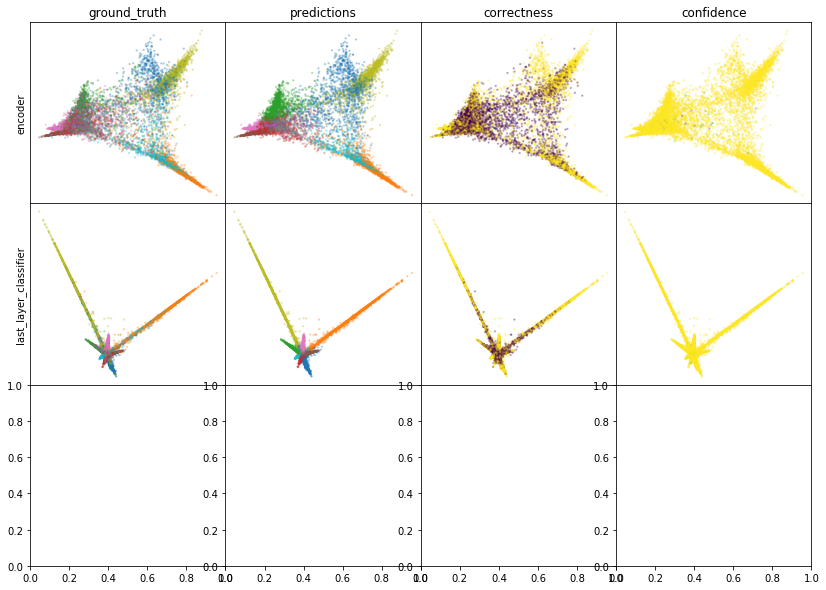

W0807 16:15:22.406134 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:15:23.372399 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:15:24.274369 140001524946752 legend.py:1282] No handles with labels found to put in legend.


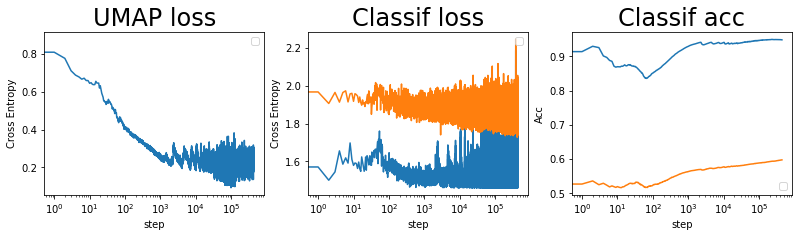

batch: 440000 | train acc: 0.9485 | val acc: 0.598


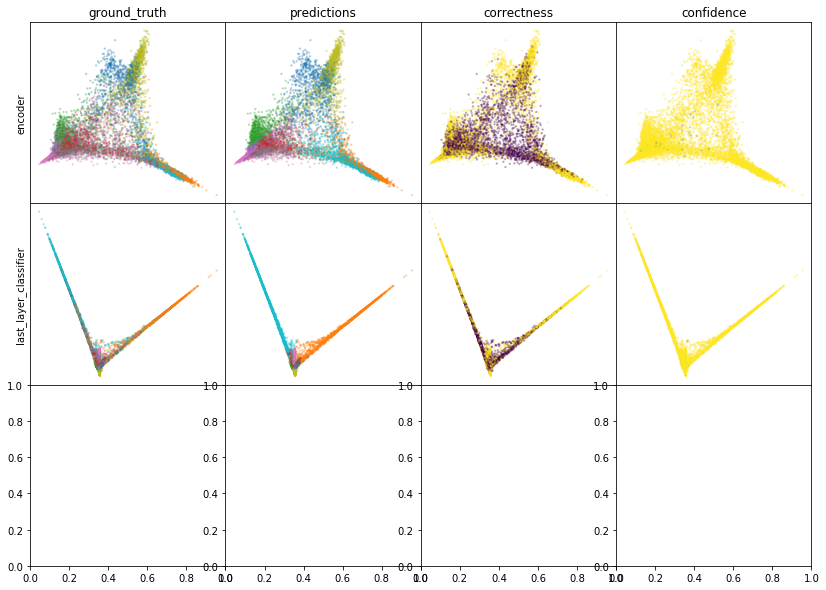

W0807 16:18:02.992316 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:18:03.966474 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:18:04.868150 140001524946752 legend.py:1282] No handles with labels found to put in legend.


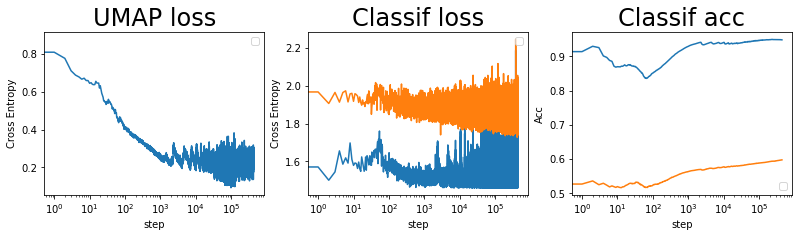

batch: 441000 | train acc: 0.9485 | val acc: 0.598


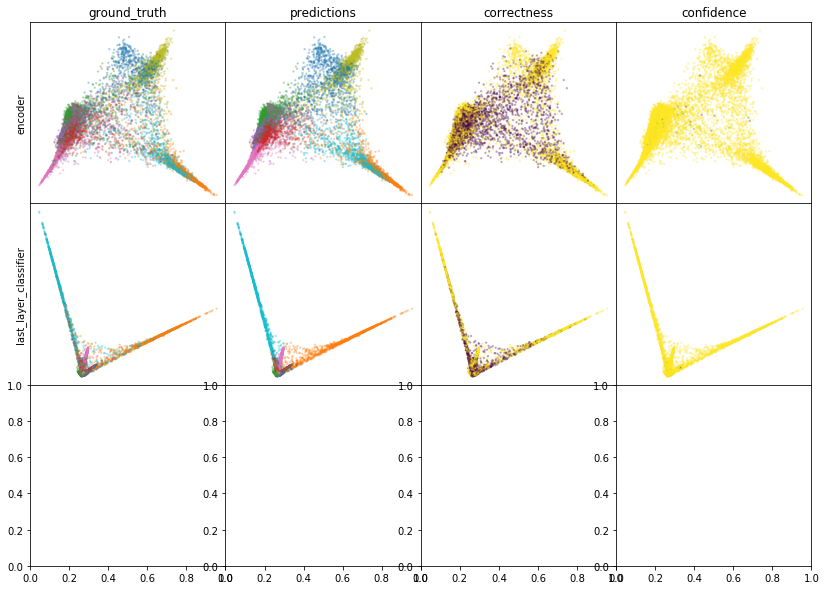

W0807 16:20:41.725488 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:20:42.876890 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:20:43.908973 140001524946752 legend.py:1282] No handles with labels found to put in legend.


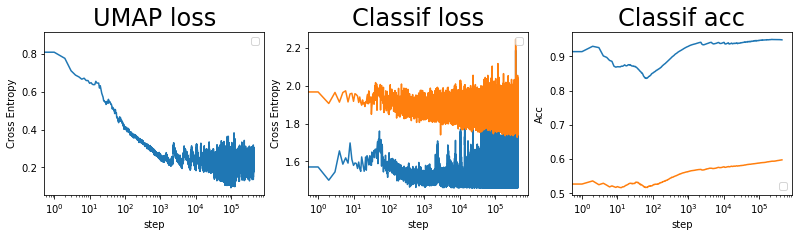

batch: 442000 | train acc: 0.9485 | val acc: 0.598


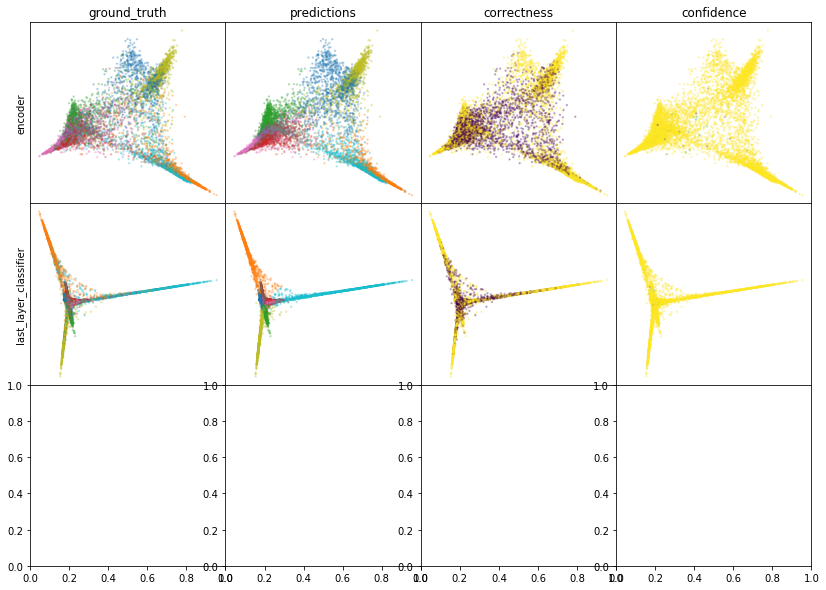

W0807 16:23:42.050071 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:23:43.131616 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:23:44.165625 140001524946752 legend.py:1282] No handles with labels found to put in legend.


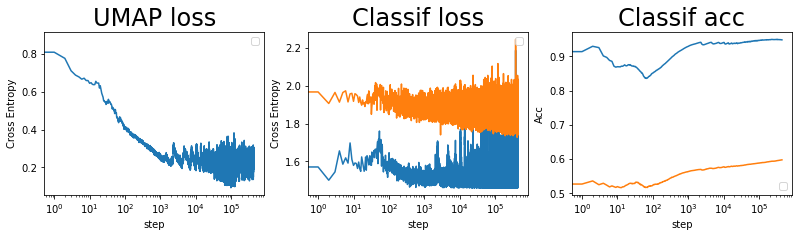

batch: 443000 | train acc: 0.9485 | val acc: 0.598


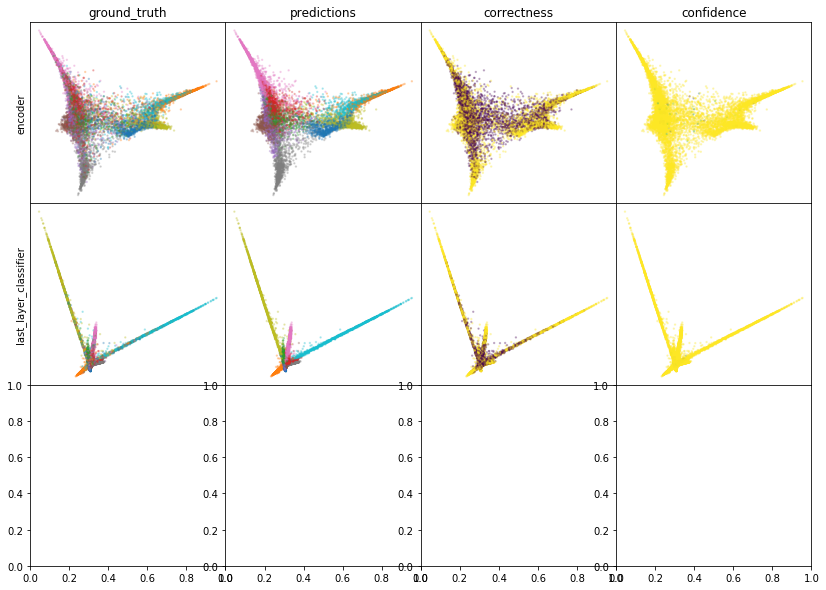

W0807 16:26:37.513219 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:26:38.537111 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:26:39.505012 140001524946752 legend.py:1282] No handles with labels found to put in legend.


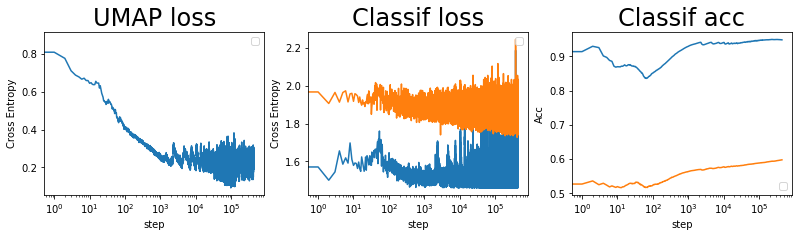

batch: 444000 | train acc: 0.9485 | val acc: 0.5981


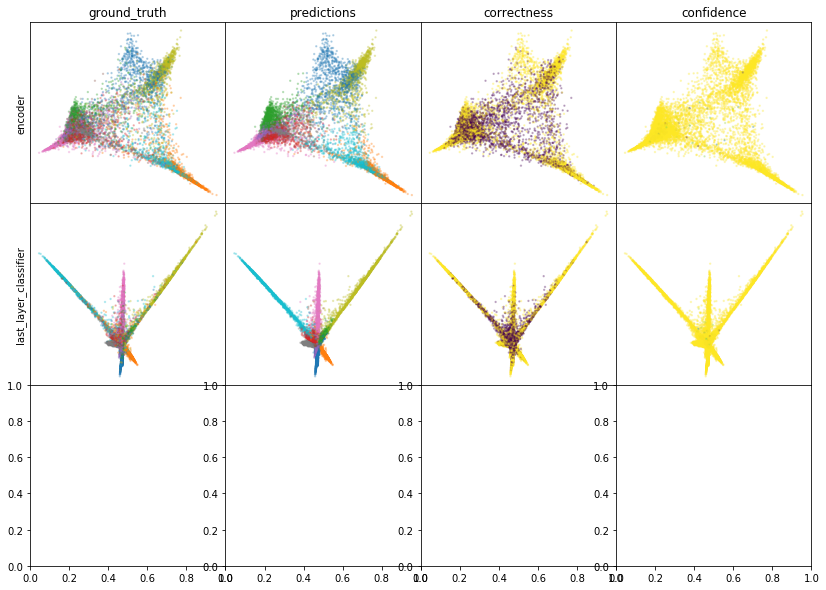

W0807 16:29:31.537764 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:29:32.676369 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:29:33.785112 140001524946752 legend.py:1282] No handles with labels found to put in legend.


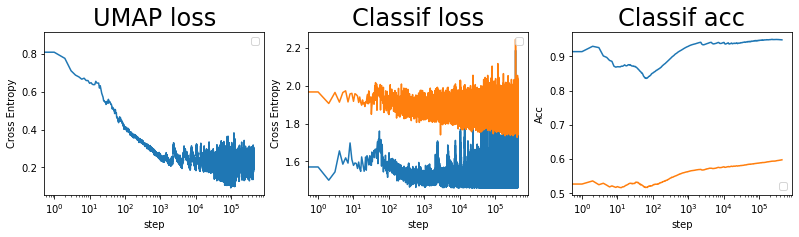

batch: 445000 | train acc: 0.9485 | val acc: 0.5981


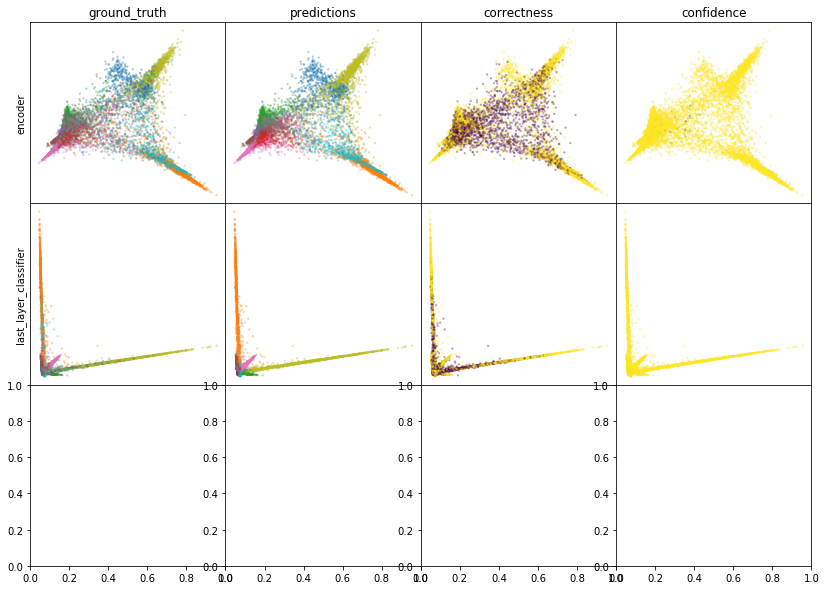

W0807 16:32:27.298270 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:32:28.337477 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:32:29.315647 140001524946752 legend.py:1282] No handles with labels found to put in legend.


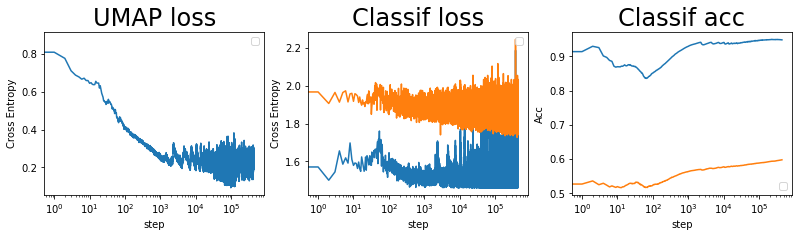

batch: 446000 | train acc: 0.9485 | val acc: 0.5982


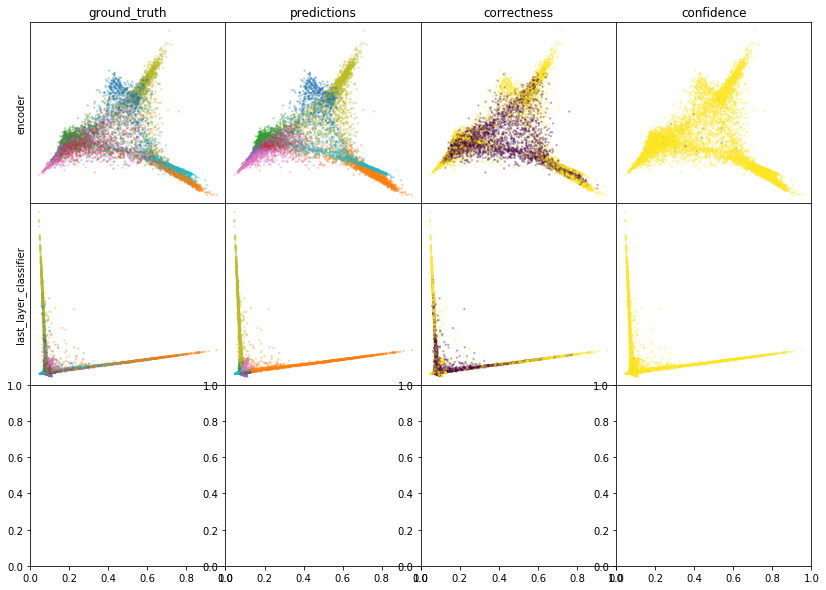

W0807 16:35:22.492133 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:35:23.541543 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:35:24.511034 140001524946752 legend.py:1282] No handles with labels found to put in legend.


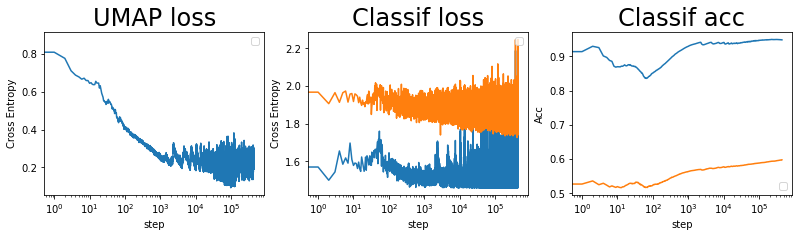

batch: 447000 | train acc: 0.9485 | val acc: 0.5982


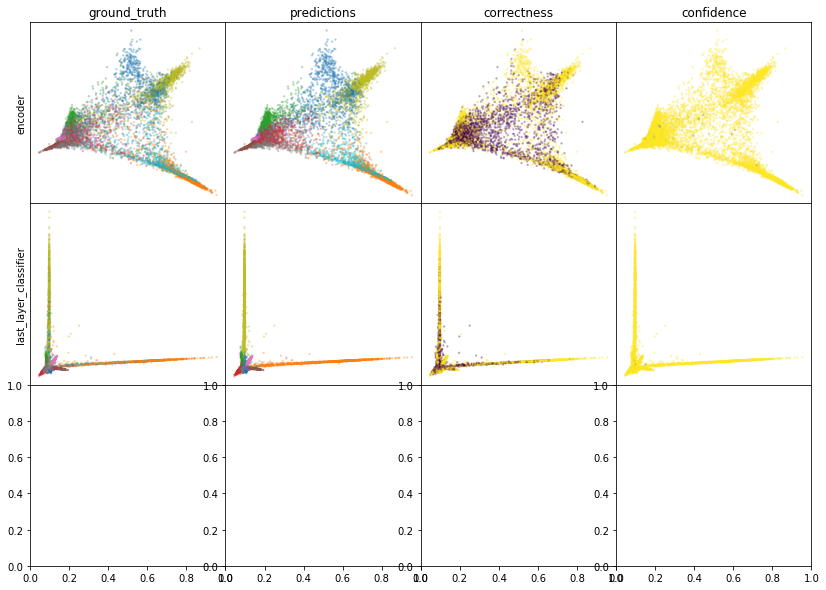

W0807 16:38:04.919312 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:38:05.905628 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:38:06.828426 140001524946752 legend.py:1282] No handles with labels found to put in legend.


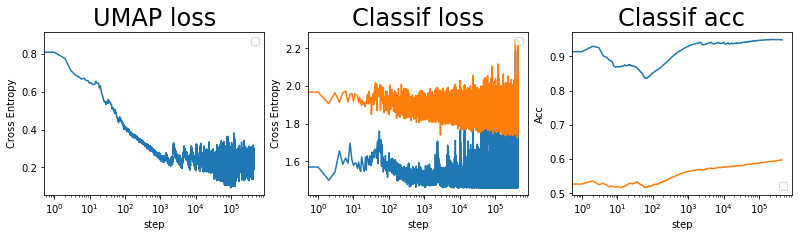

batch: 448000 | train acc: 0.9485 | val acc: 0.5982


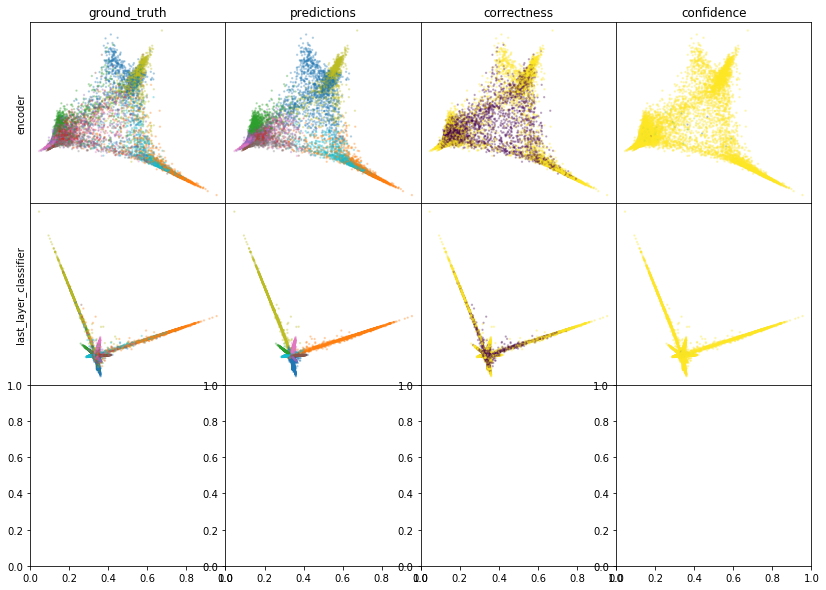

W0807 16:40:45.012121 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:40:45.993911 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:40:46.913055 140001524946752 legend.py:1282] No handles with labels found to put in legend.


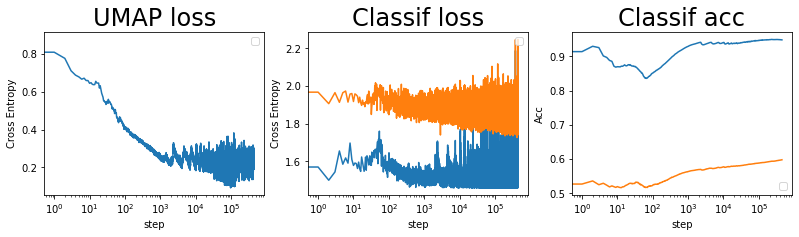

batch: 449000 | train acc: 0.9484 | val acc: 0.5982


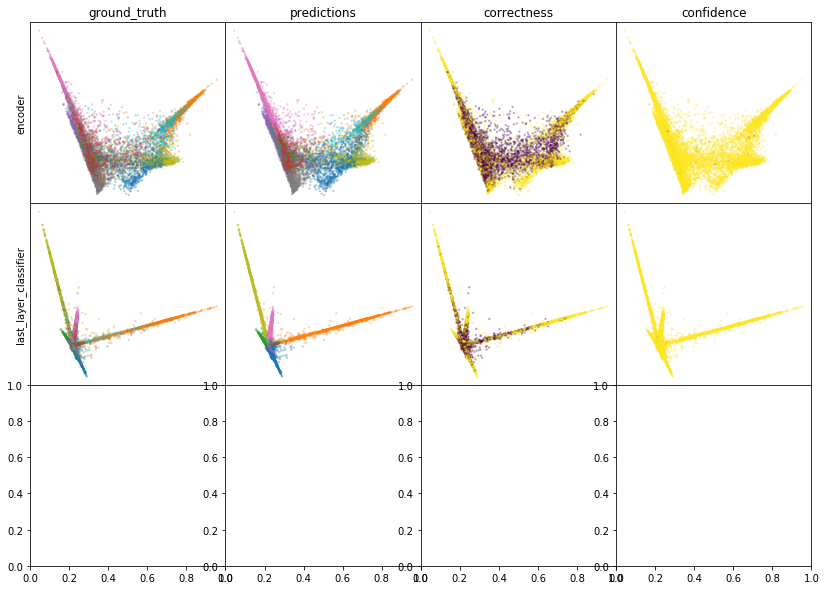

W0807 16:43:23.878495 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:43:24.861368 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:43:25.776427 140001524946752 legend.py:1282] No handles with labels found to put in legend.


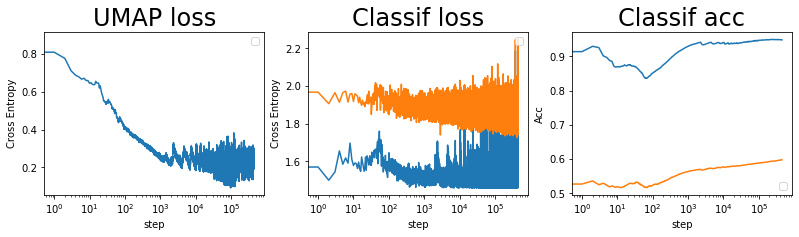

batch: 450000 | train acc: 0.9484 | val acc: 0.5983


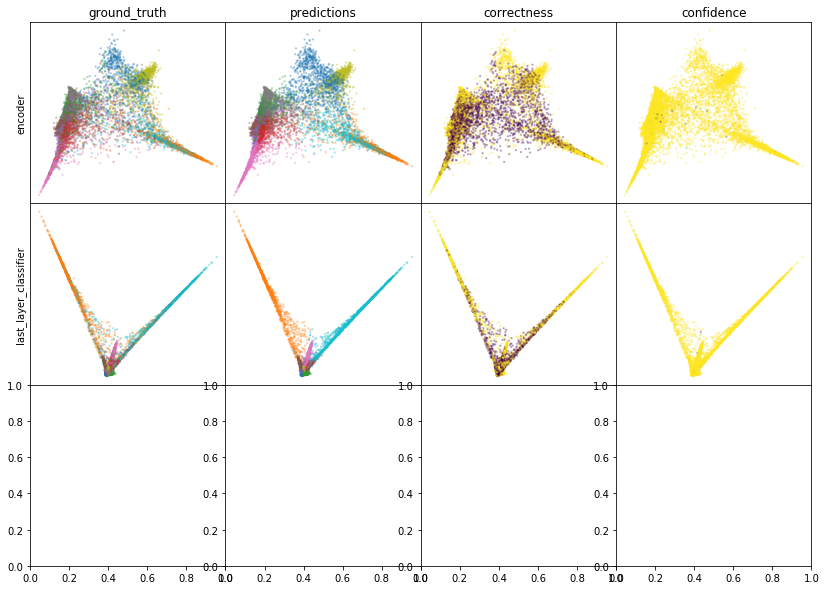

W0807 16:46:03.432296 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:46:04.423172 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:46:05.335811 140001524946752 legend.py:1282] No handles with labels found to put in legend.


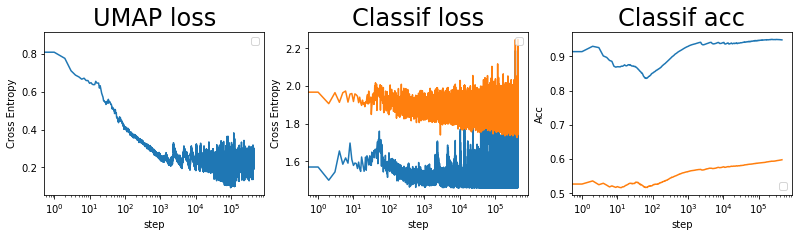

batch: 451000 | train acc: 0.9484 | val acc: 0.5983


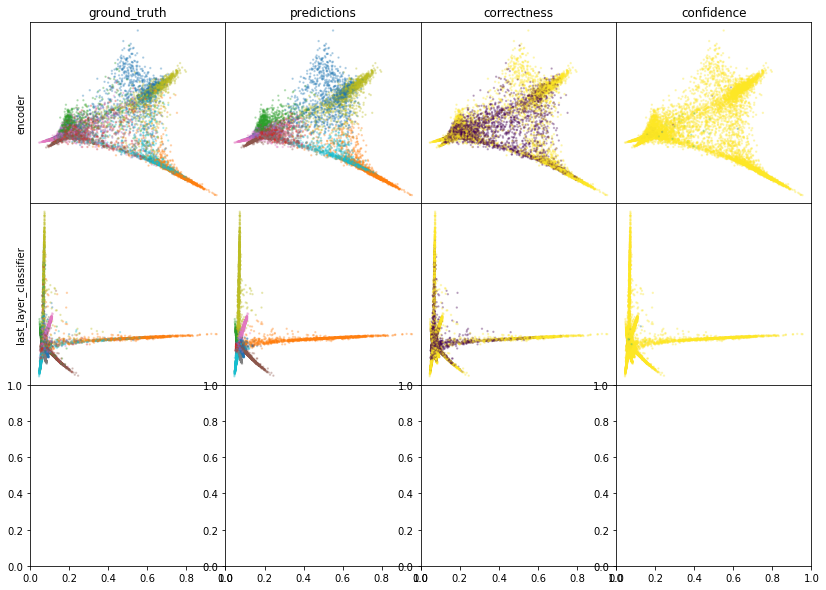

W0807 16:48:58.253065 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:48:59.242372 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:49:00.169700 140001524946752 legend.py:1282] No handles with labels found to put in legend.


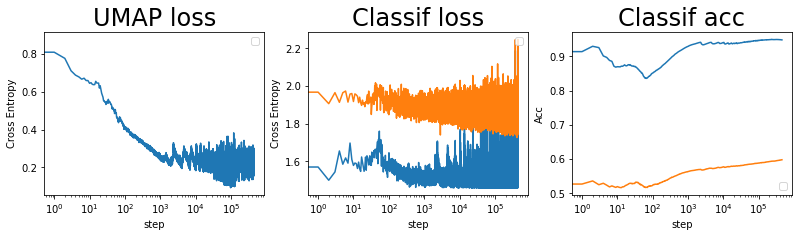

batch: 452000 | train acc: 0.9484 | val acc: 0.5983


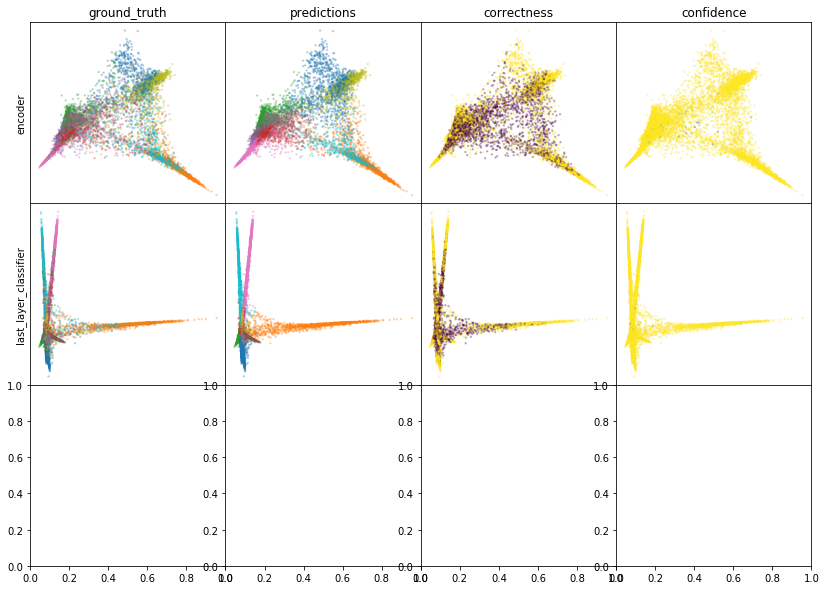

W0807 16:51:38.210401 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:51:39.191873 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:51:40.109070 140001524946752 legend.py:1282] No handles with labels found to put in legend.


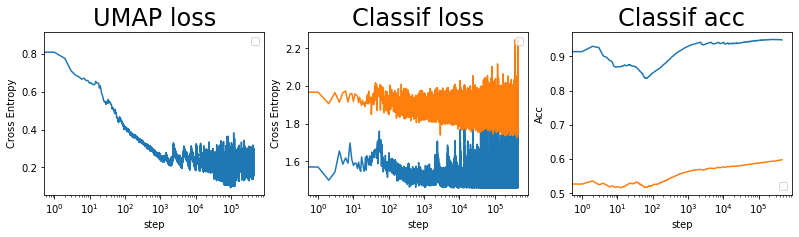

batch: 453000 | train acc: 0.9484 | val acc: 0.5983


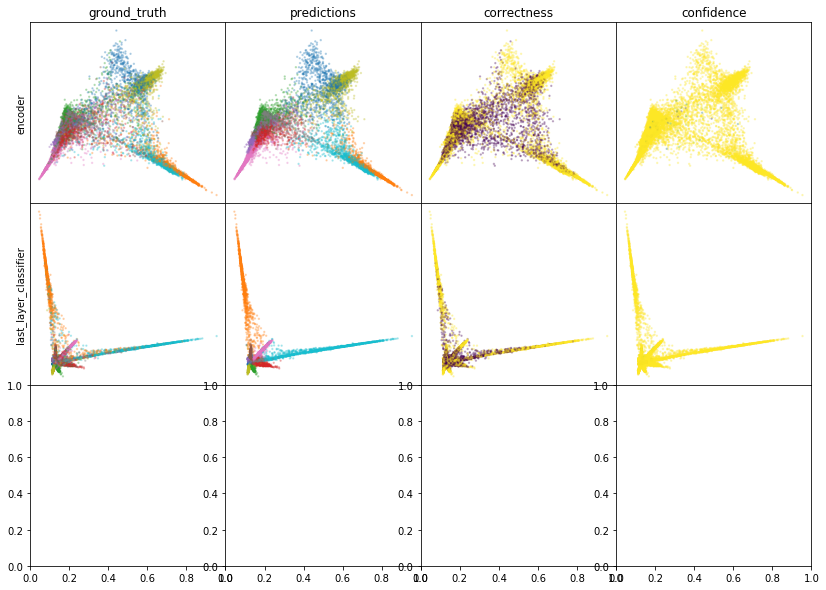

W0807 16:54:19.536897 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:54:20.519577 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:54:21.437942 140001524946752 legend.py:1282] No handles with labels found to put in legend.


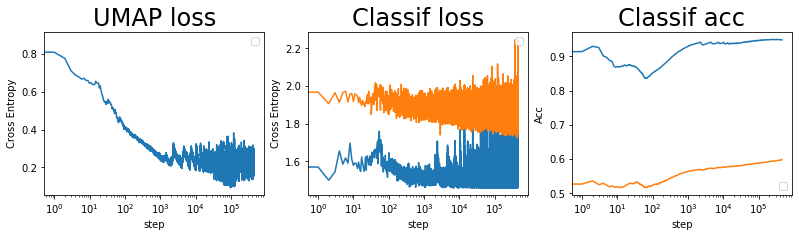

batch: 454000 | train acc: 0.9484 | val acc: 0.5984


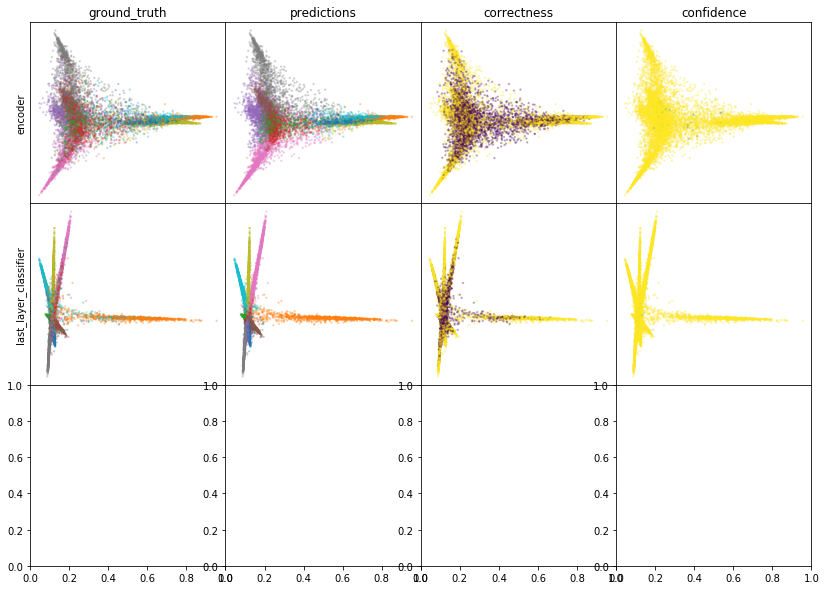

W0807 16:56:59.371833 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:57:00.369379 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:57:01.325391 140001524946752 legend.py:1282] No handles with labels found to put in legend.


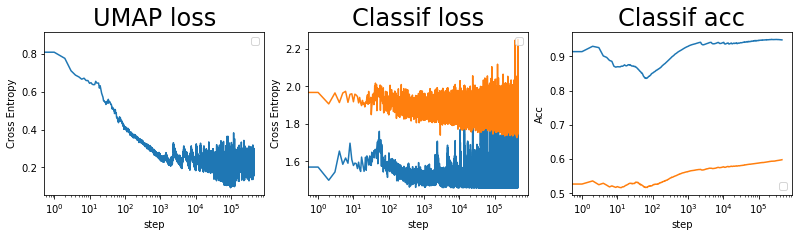

batch: 455000 | train acc: 0.9483 | val acc: 0.5984


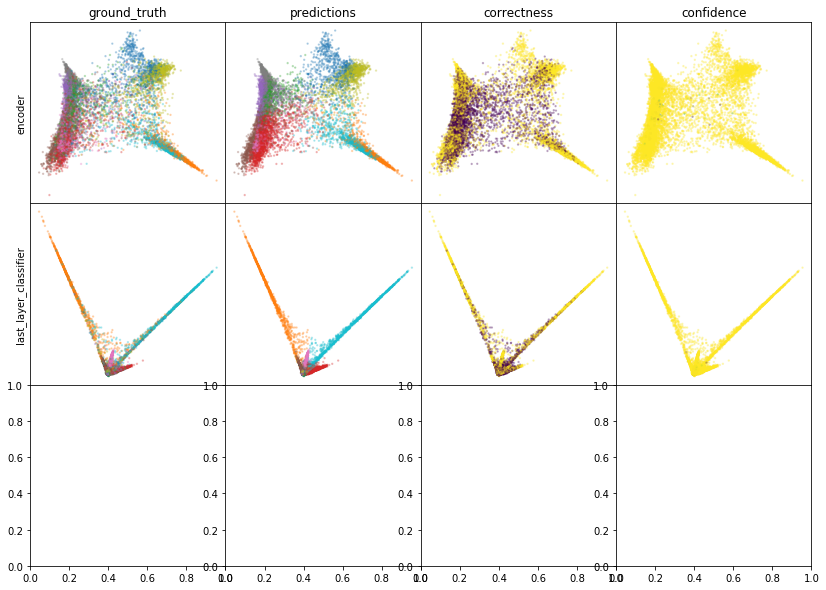

W0807 16:59:41.492855 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:59:42.496253 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 16:59:43.424028 140001524946752 legend.py:1282] No handles with labels found to put in legend.


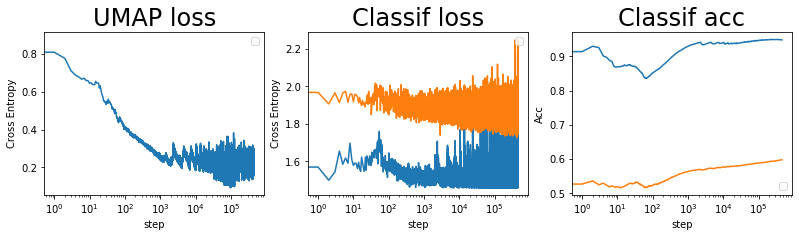

batch: 456000 | train acc: 0.9483 | val acc: 0.5984


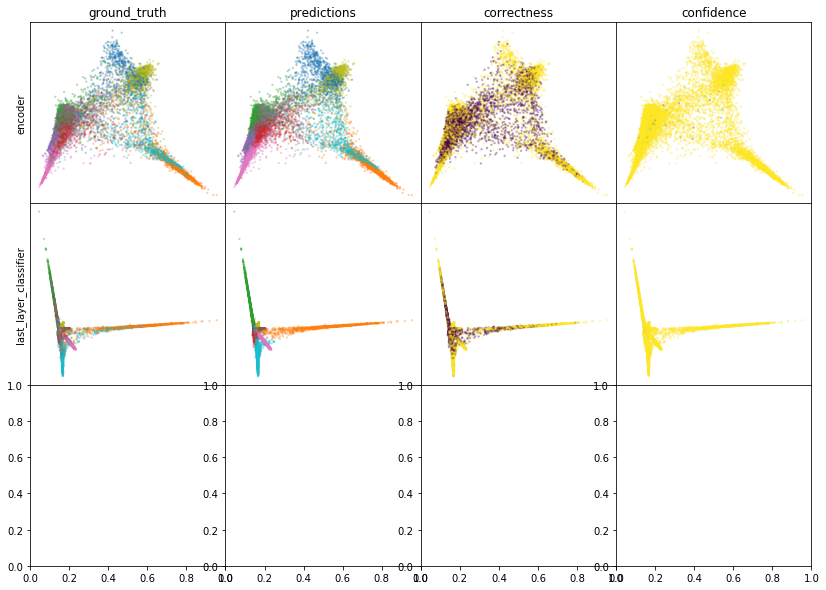

W0807 17:02:22.808569 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:02:23.818928 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:02:24.751737 140001524946752 legend.py:1282] No handles with labels found to put in legend.


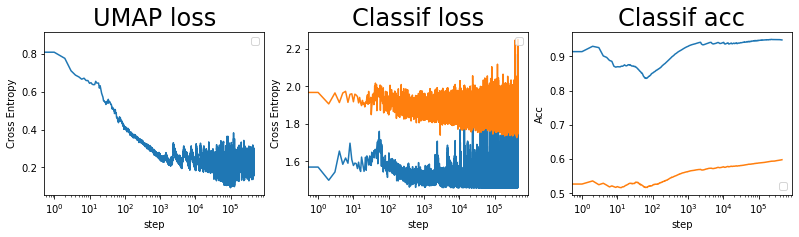

batch: 457000 | train acc: 0.9482 | val acc: 0.5984


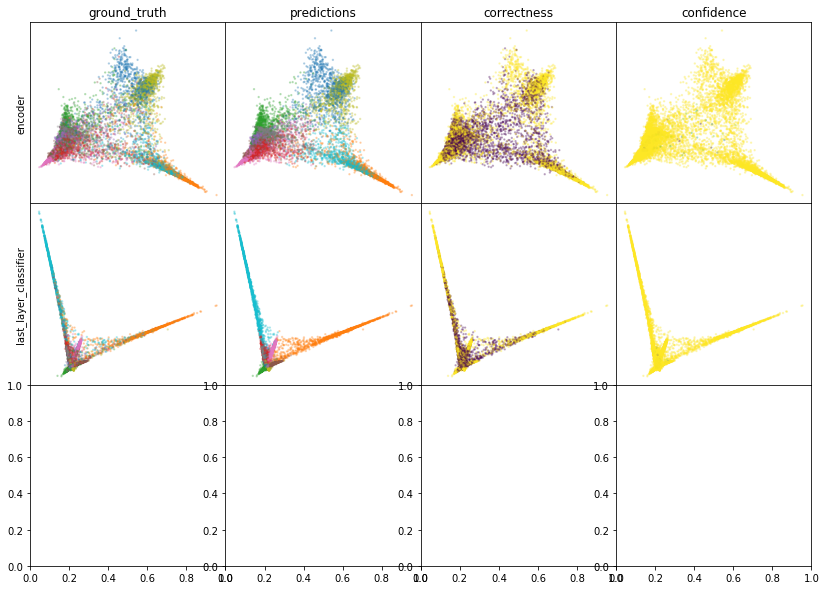

W0807 17:05:03.760578 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:05:04.760036 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:05:05.706182 140001524946752 legend.py:1282] No handles with labels found to put in legend.


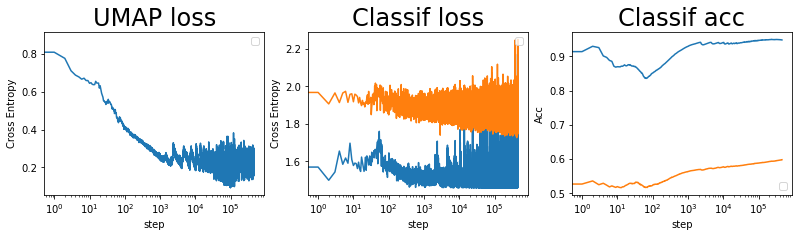

batch: 458000 | train acc: 0.9482 | val acc: 0.5984


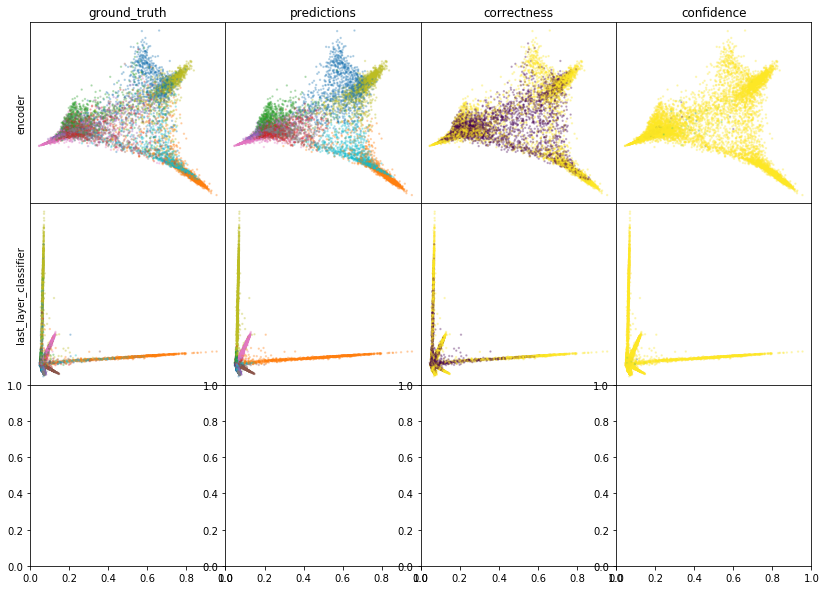

W0807 17:07:46.600413 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:07:47.617290 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:07:48.551648 140001524946752 legend.py:1282] No handles with labels found to put in legend.


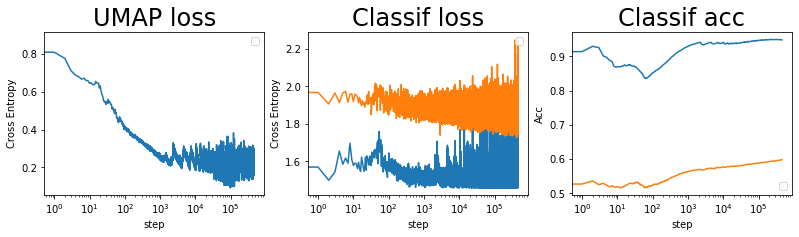

batch: 459000 | train acc: 0.9482 | val acc: 0.5984


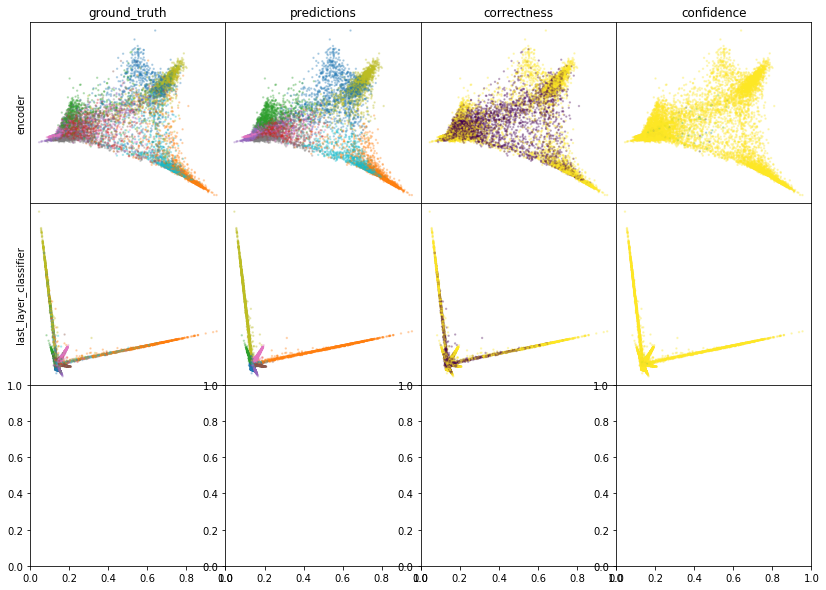

W0807 17:10:42.663640 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:10:43.917219 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:10:44.983289 140001524946752 legend.py:1282] No handles with labels found to put in legend.


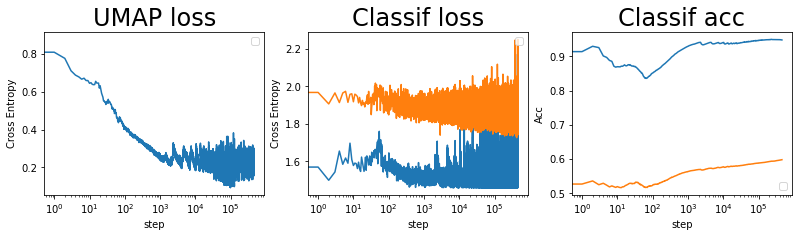

batch: 460000 | train acc: 0.9482 | val acc: 0.5985


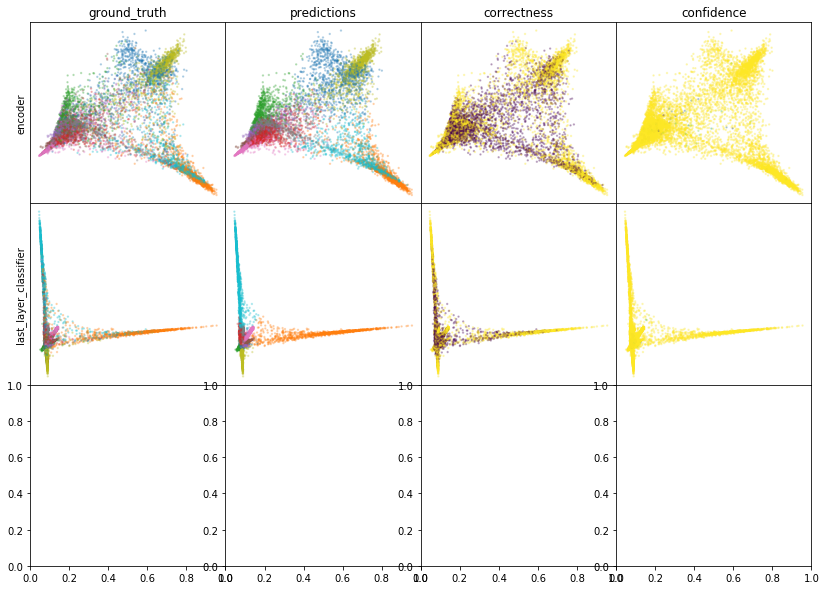

W0807 17:13:44.275458 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:13:45.379257 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:13:46.408822 140001524946752 legend.py:1282] No handles with labels found to put in legend.


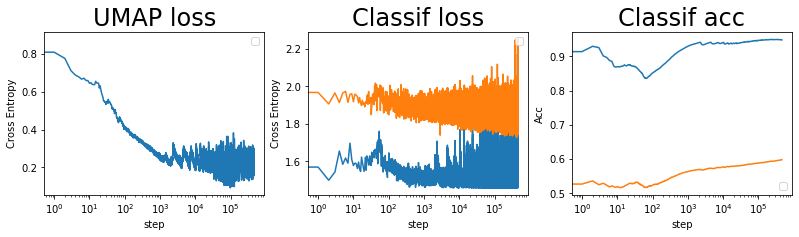

batch: 461000 | train acc: 0.9481 | val acc: 0.5985


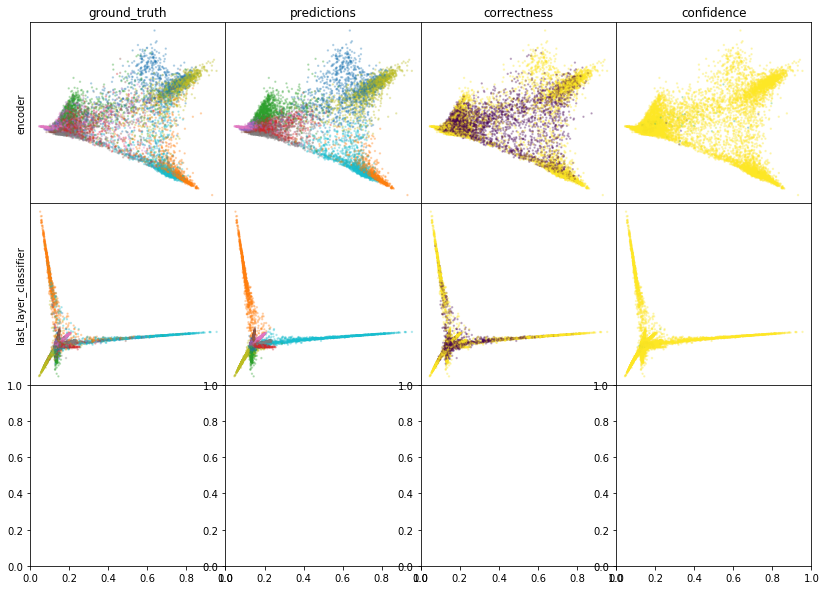

W0807 17:16:44.040684 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:16:45.144538 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:16:46.177739 140001524946752 legend.py:1282] No handles with labels found to put in legend.


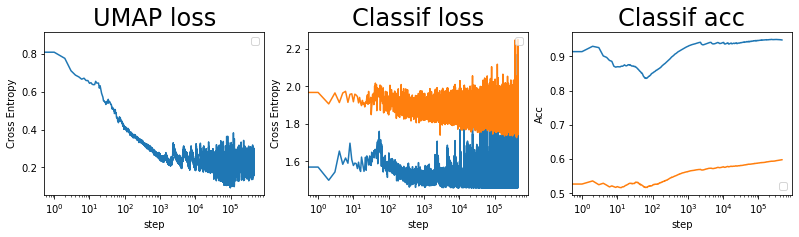

batch: 462000 | train acc: 0.9481 | val acc: 0.5985


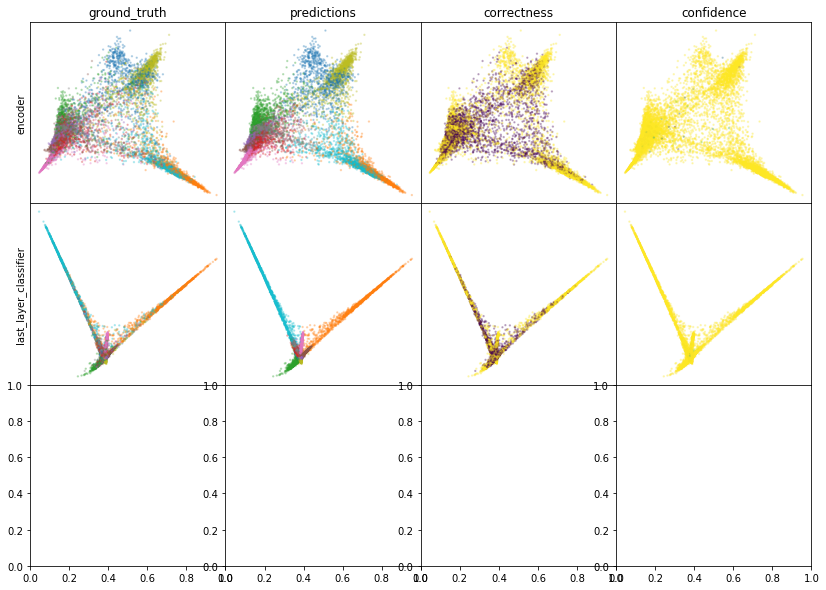

W0807 17:19:43.565727 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:19:44.660017 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:19:45.717344 140001524946752 legend.py:1282] No handles with labels found to put in legend.


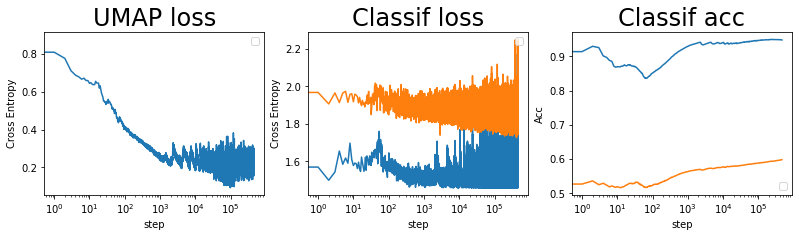

batch: 463000 | train acc: 0.9481 | val acc: 0.5985


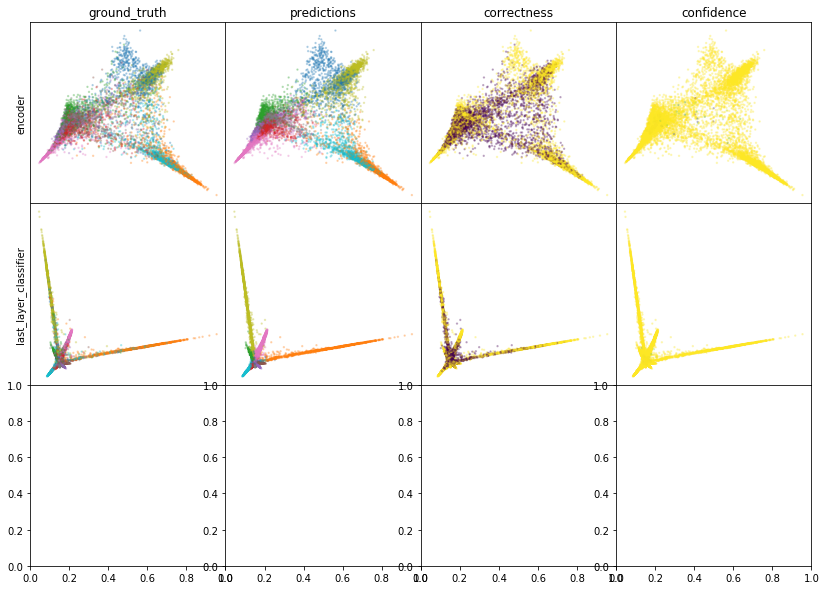

W0807 17:22:46.485569 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:22:47.662107 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:22:48.749423 140001524946752 legend.py:1282] No handles with labels found to put in legend.


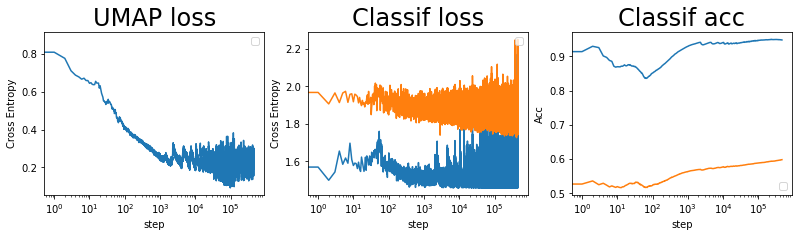

batch: 464000 | train acc: 0.9481 | val acc: 0.5985


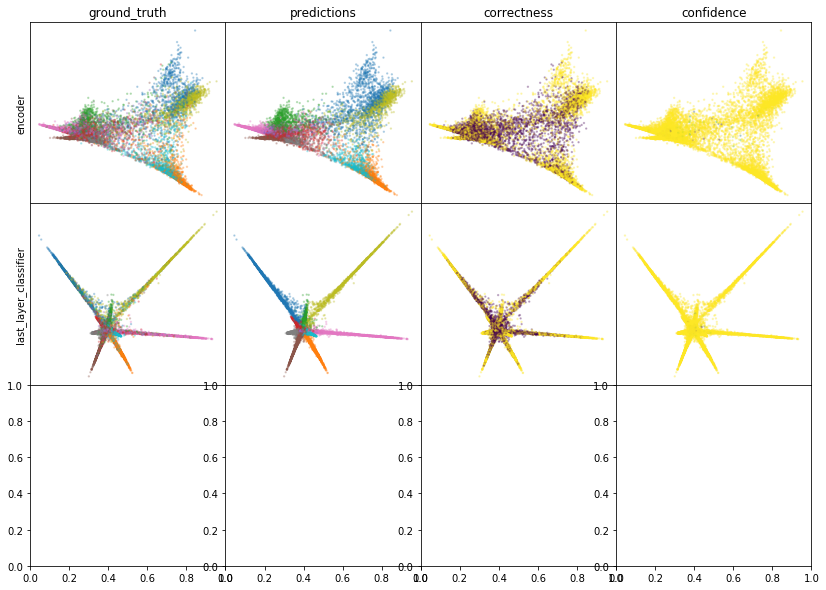

W0807 17:25:45.670509 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:25:46.903260 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:25:47.950628 140001524946752 legend.py:1282] No handles with labels found to put in legend.


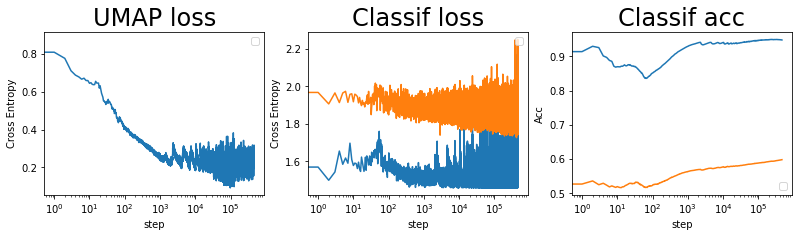

batch: 465000 | train acc: 0.9481 | val acc: 0.5985


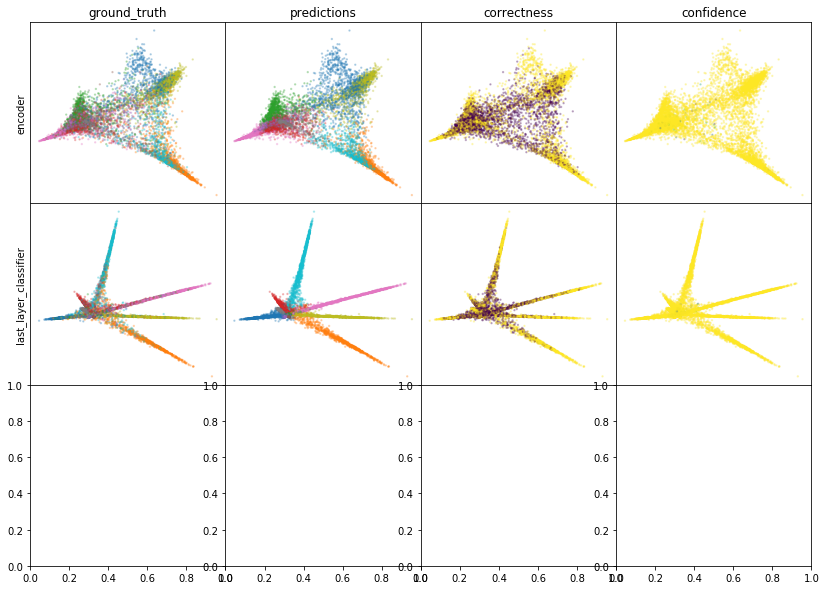

W0807 17:28:35.640183 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:28:36.652119 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:28:37.589489 140001524946752 legend.py:1282] No handles with labels found to put in legend.


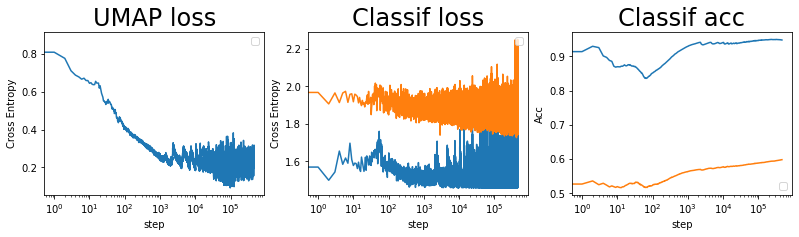

batch: 466000 | train acc: 0.948 | val acc: 0.5986


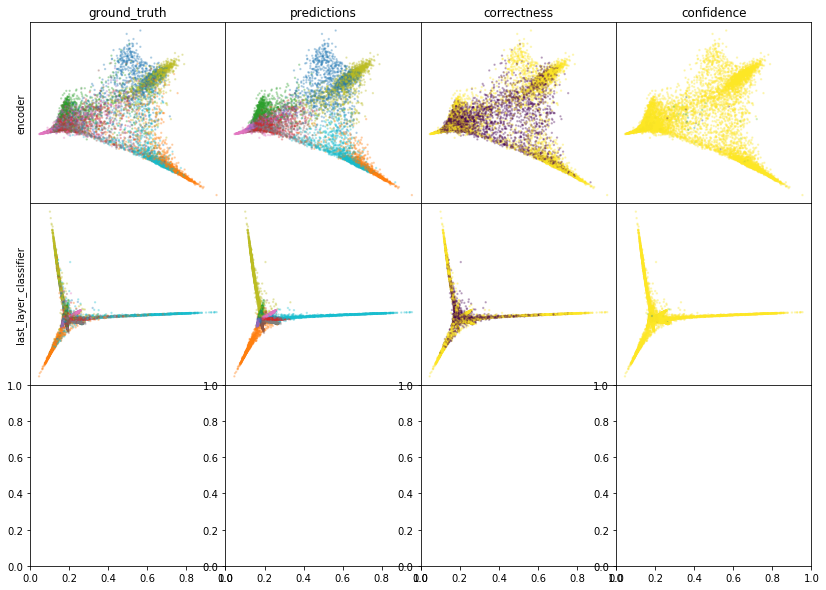

W0807 17:31:20.178731 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:31:21.210693 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:31:22.189258 140001524946752 legend.py:1282] No handles with labels found to put in legend.


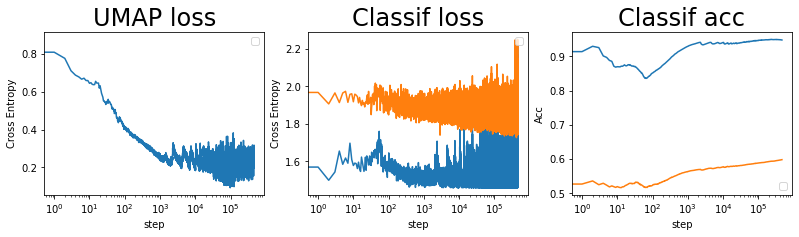

batch: 467000 | train acc: 0.948 | val acc: 0.5986


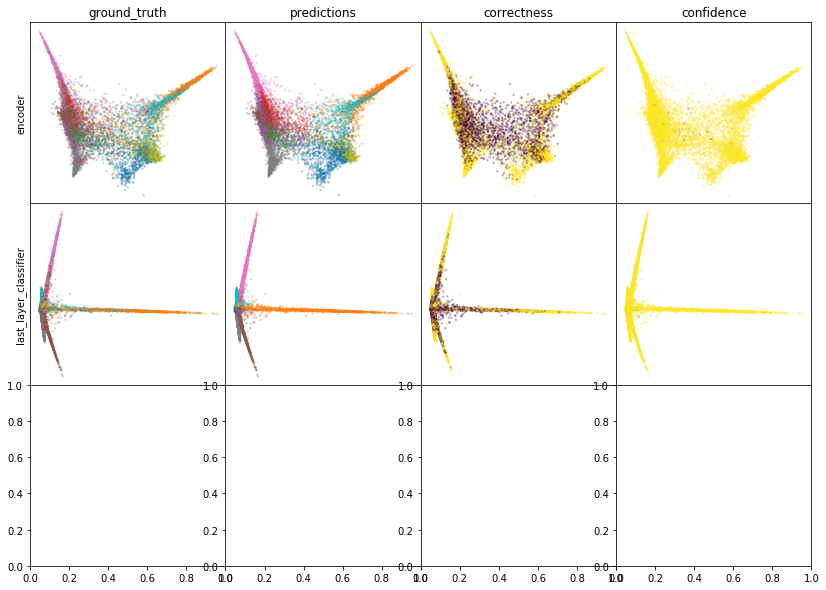

W0807 17:34:04.462445 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:34:05.473328 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:34:06.419950 140001524946752 legend.py:1282] No handles with labels found to put in legend.


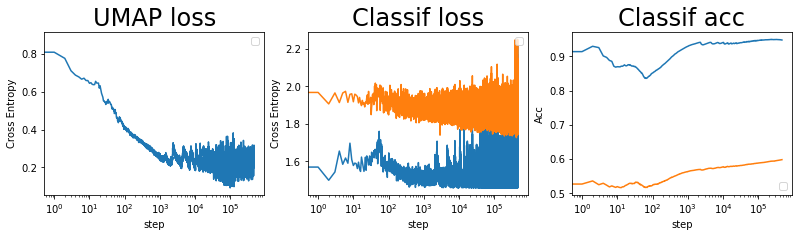

batch: 468000 | train acc: 0.948 | val acc: 0.5986


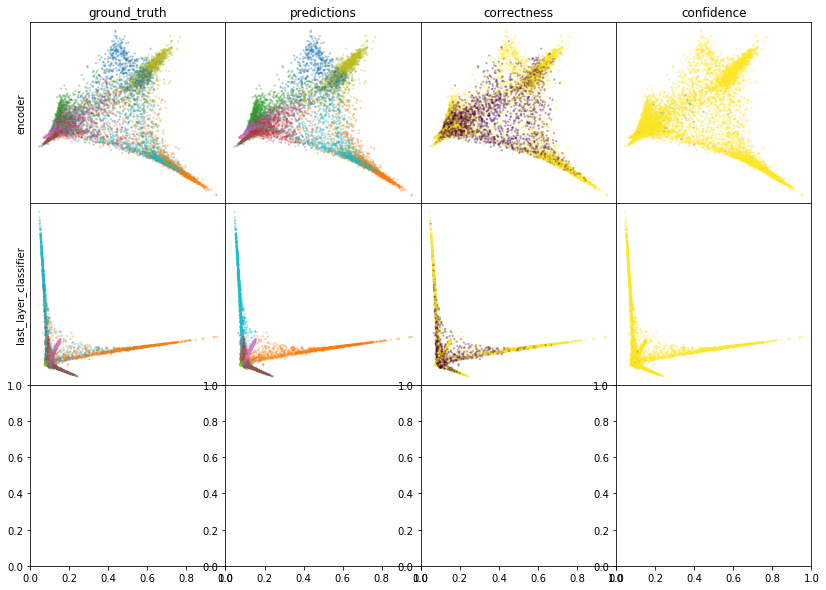

W0807 17:36:48.287688 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:36:49.313699 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:36:50.264550 140001524946752 legend.py:1282] No handles with labels found to put in legend.


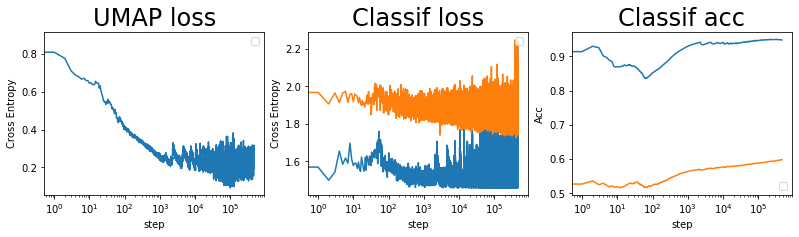

batch: 469000 | train acc: 0.948 | val acc: 0.5986


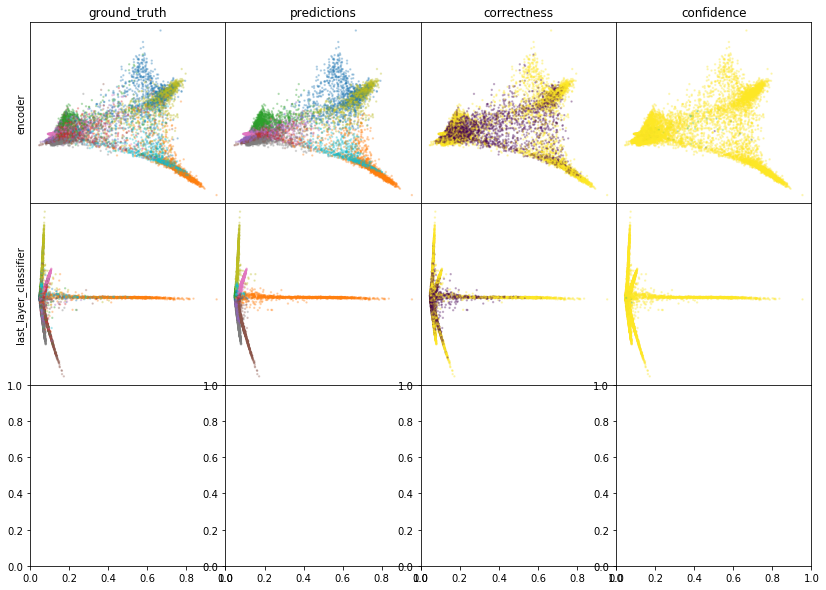

W0807 17:39:33.072927 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:39:34.091639 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:39:35.045695 140001524946752 legend.py:1282] No handles with labels found to put in legend.


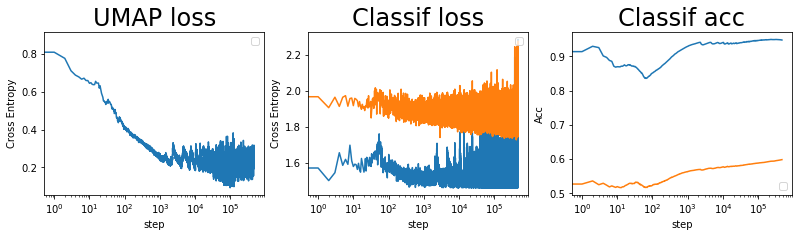

batch: 470000 | train acc: 0.948 | val acc: 0.5986


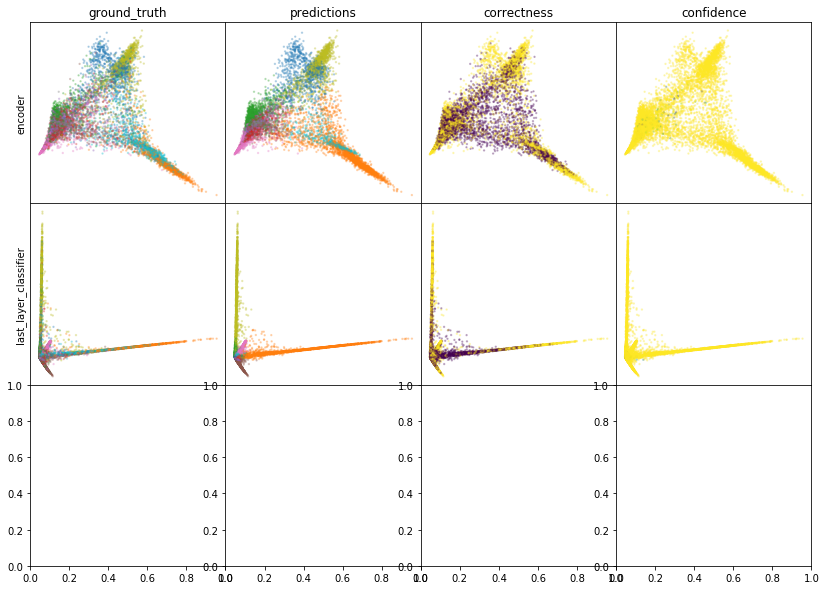

W0807 17:42:17.165500 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:42:18.189152 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:42:19.150086 140001524946752 legend.py:1282] No handles with labels found to put in legend.


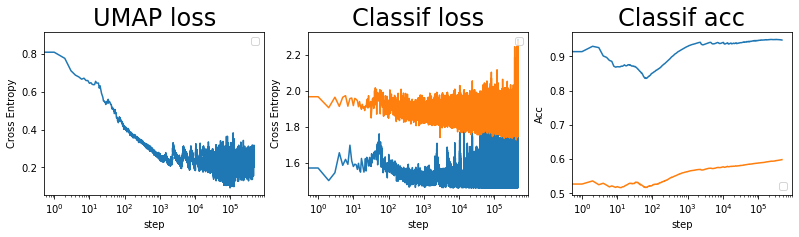

batch: 471000 | train acc: 0.9479 | val acc: 0.5987


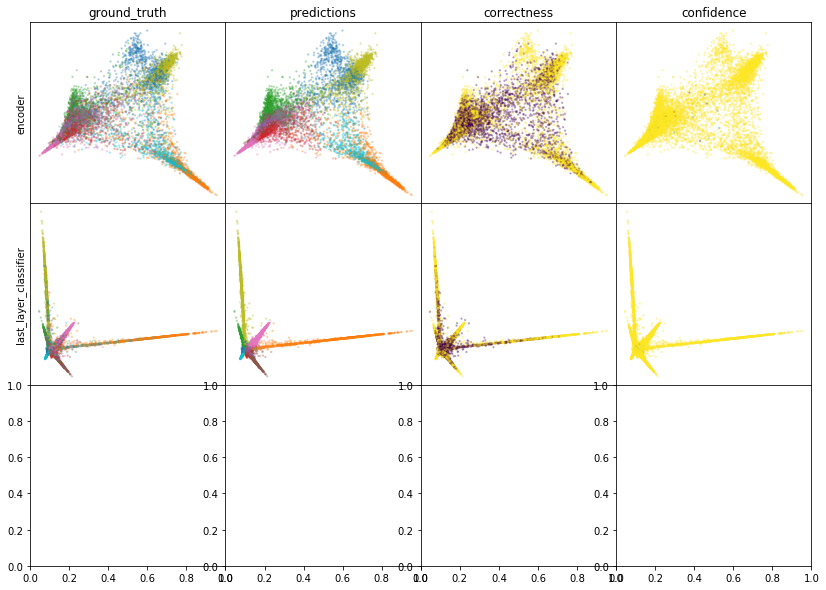

W0807 17:45:00.792048 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:45:01.820557 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:45:02.776542 140001524946752 legend.py:1282] No handles with labels found to put in legend.


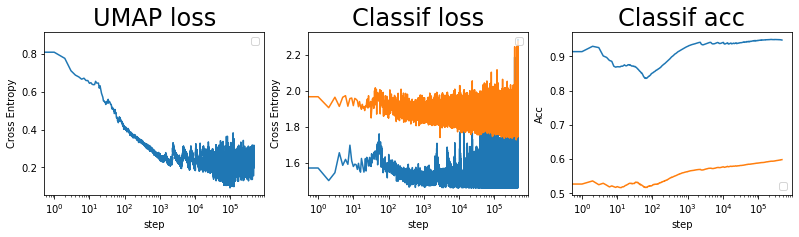

batch: 472000 | train acc: 0.9479 | val acc: 0.5987


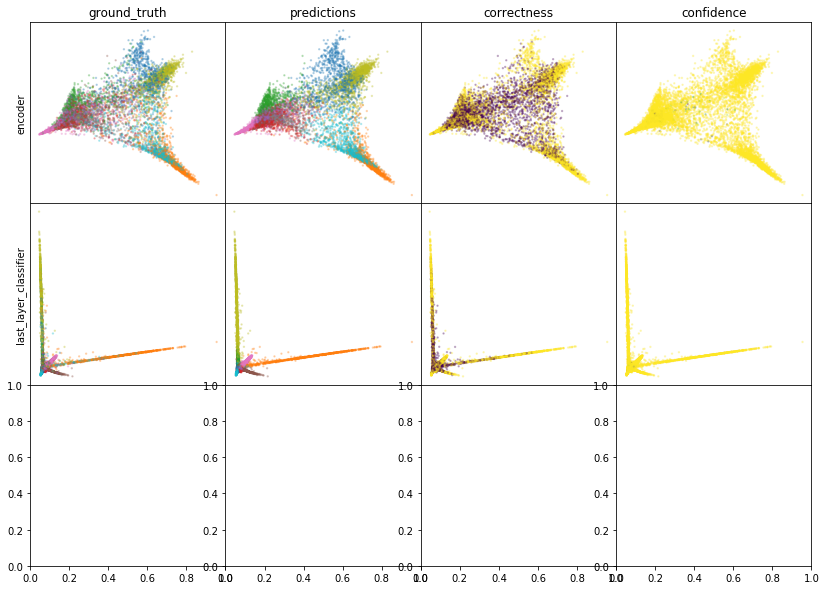

W0807 17:47:45.000072 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:47:46.070337 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:47:47.042961 140001524946752 legend.py:1282] No handles with labels found to put in legend.


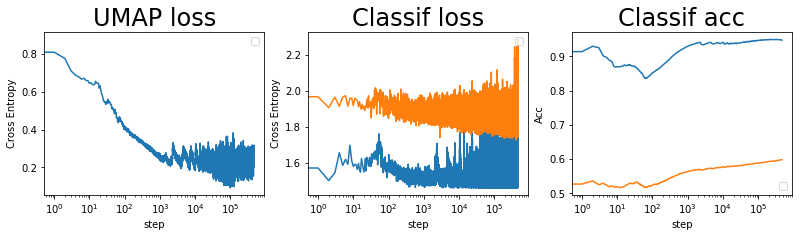

batch: 473000 | train acc: 0.9479 | val acc: 0.5987


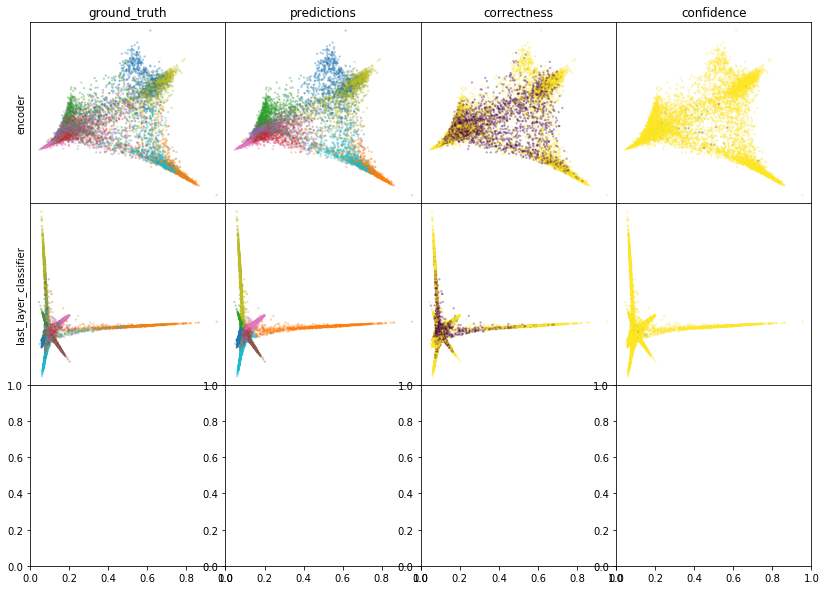

W0807 17:50:28.156167 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:50:29.180678 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:50:30.137452 140001524946752 legend.py:1282] No handles with labels found to put in legend.


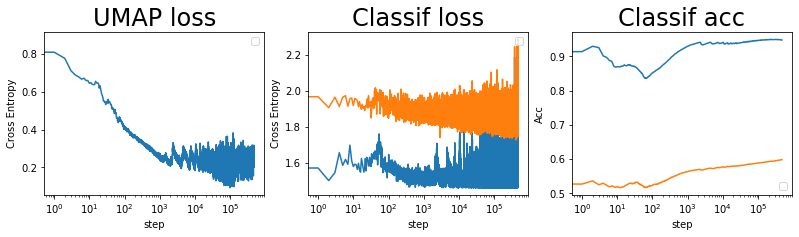

batch: 474000 | train acc: 0.9479 | val acc: 0.5987


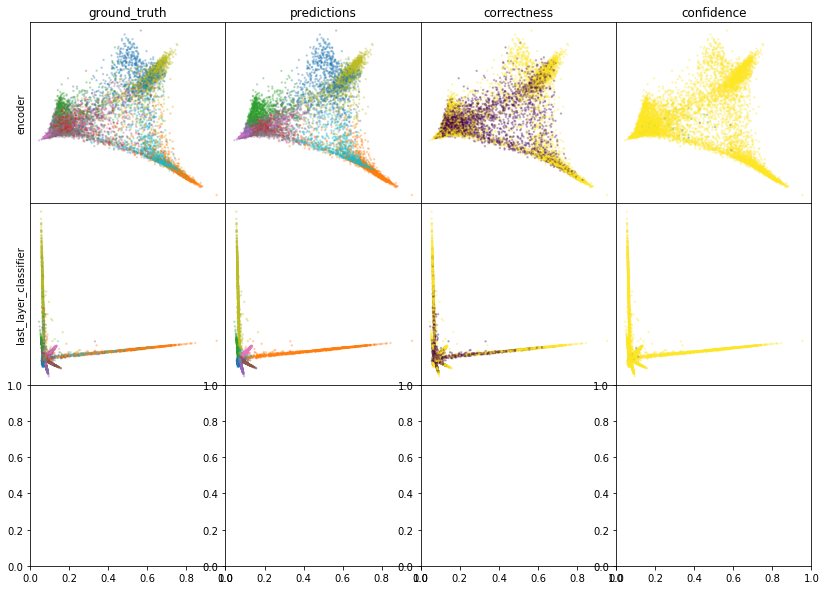

W0807 17:53:12.292638 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:53:13.330041 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:53:14.286136 140001524946752 legend.py:1282] No handles with labels found to put in legend.


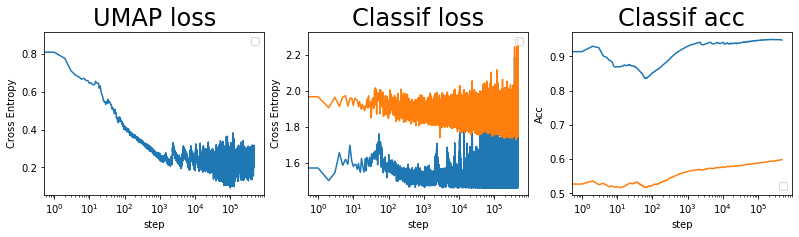

batch: 475000 | train acc: 0.9479 | val acc: 0.5987


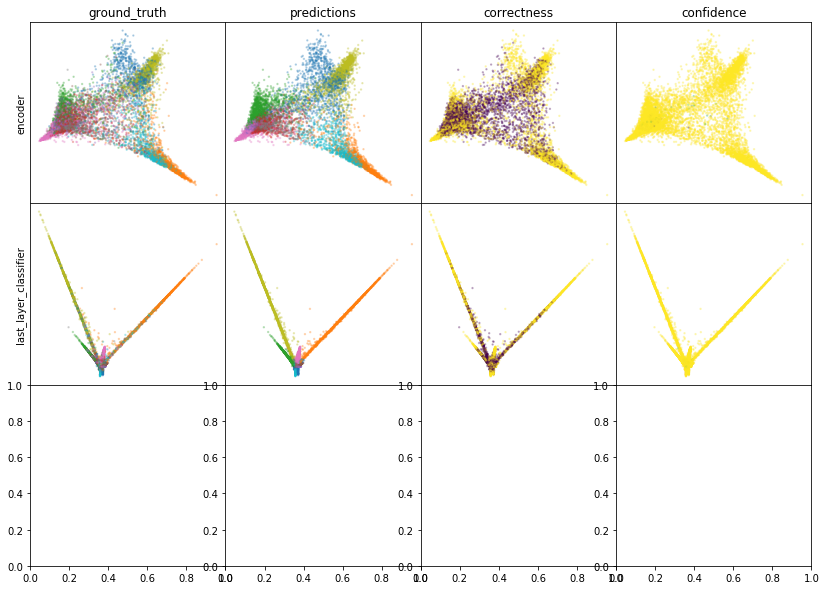

W0807 17:55:59.161571 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:56:00.185197 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:56:01.141715 140001524946752 legend.py:1282] No handles with labels found to put in legend.


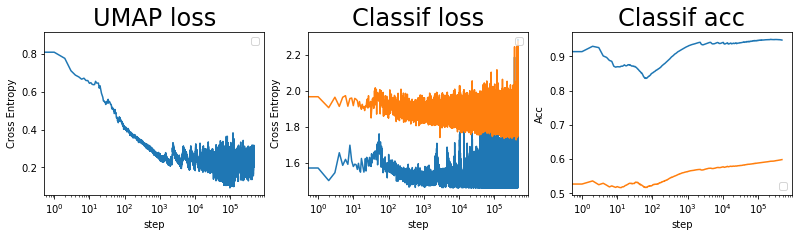

batch: 476000 | train acc: 0.9478 | val acc: 0.5987


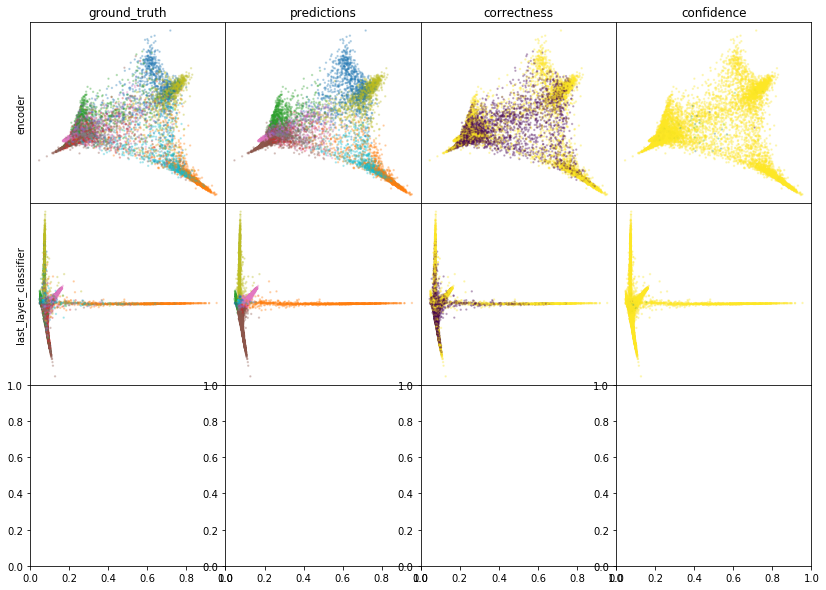

W0807 17:58:43.604967 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:58:44.639306 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 17:58:45.599394 140001524946752 legend.py:1282] No handles with labels found to put in legend.


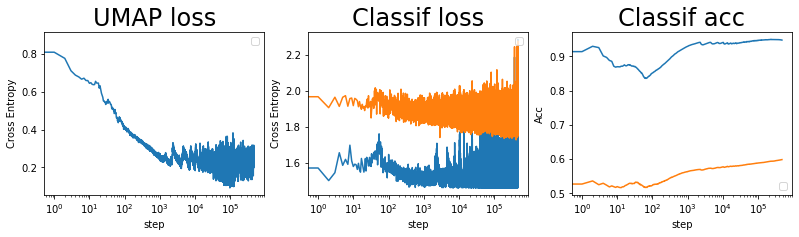

batch: 477000 | train acc: 0.9478 | val acc: 0.5988


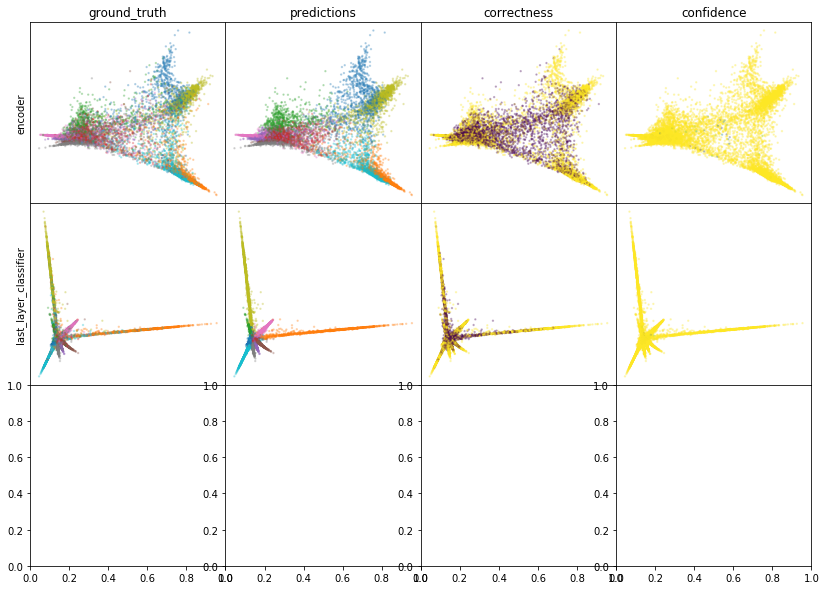

W0807 18:01:29.623396 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:01:30.663594 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:01:31.647719 140001524946752 legend.py:1282] No handles with labels found to put in legend.


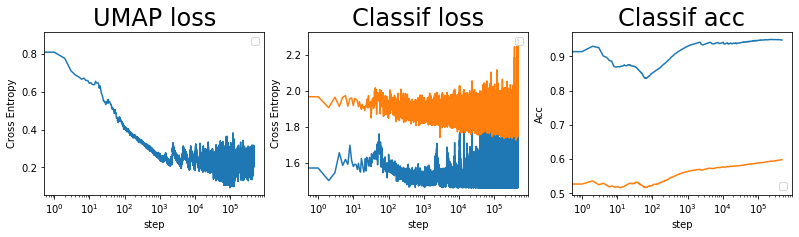

batch: 478000 | train acc: 0.9478 | val acc: 0.5988


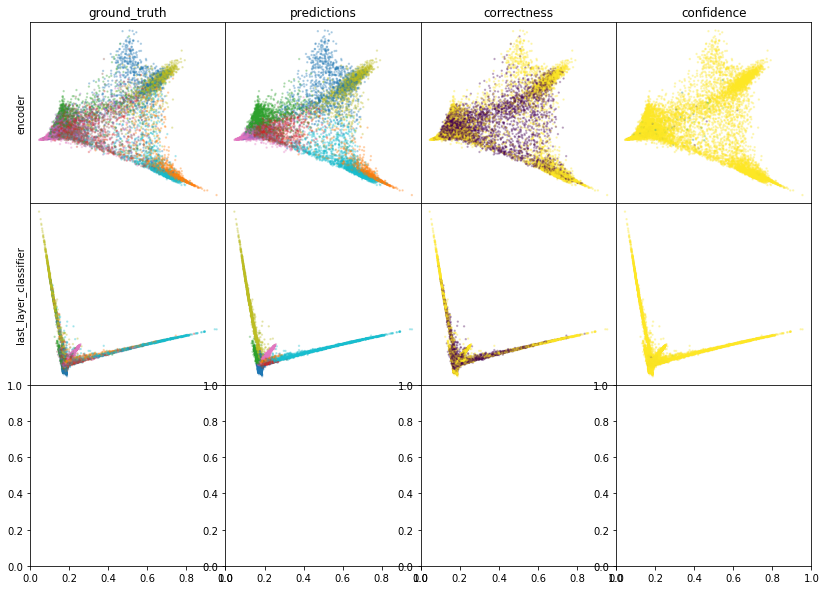

W0807 18:04:15.768261 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:04:16.796480 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:04:17.754397 140001524946752 legend.py:1282] No handles with labels found to put in legend.


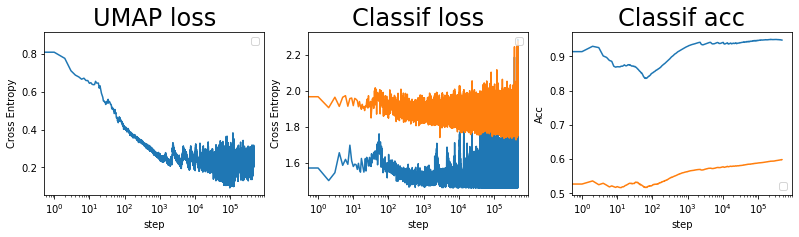

batch: 479000 | train acc: 0.9478 | val acc: 0.5988


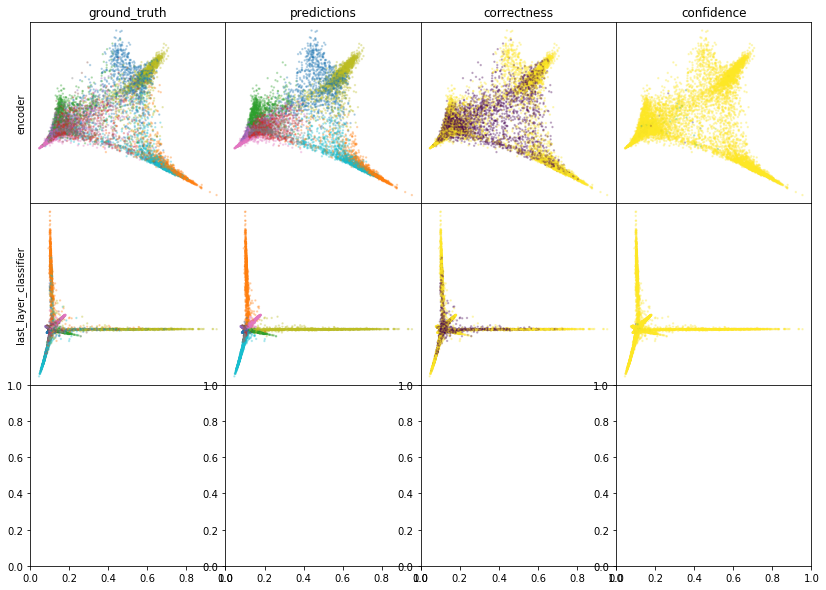

W0807 18:07:00.622302 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:07:01.665669 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:07:02.631572 140001524946752 legend.py:1282] No handles with labels found to put in legend.


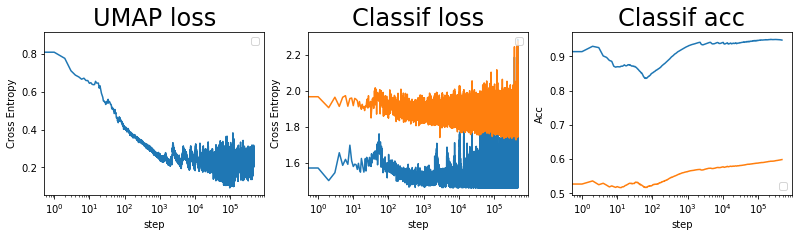

batch: 480000 | train acc: 0.9478 | val acc: 0.5988


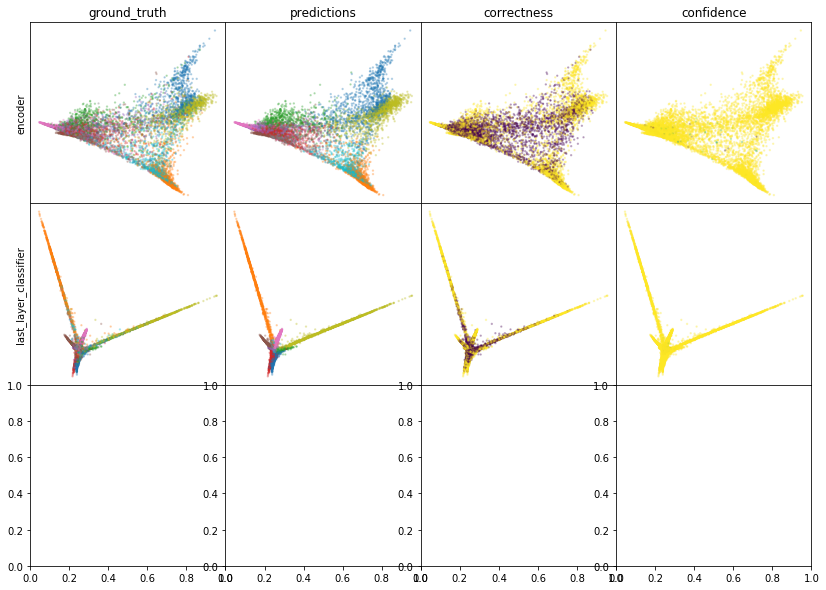

W0807 18:09:46.773557 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:09:47.812827 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:09:48.779875 140001524946752 legend.py:1282] No handles with labels found to put in legend.


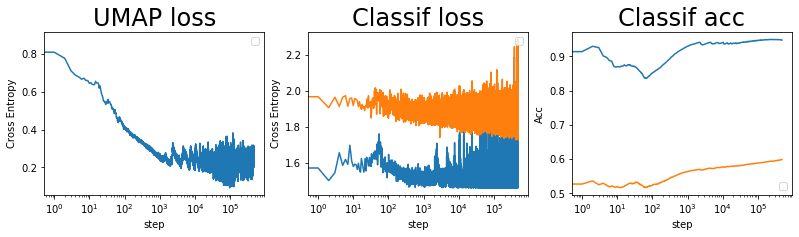

batch: 481000 | train acc: 0.9478 | val acc: 0.5988


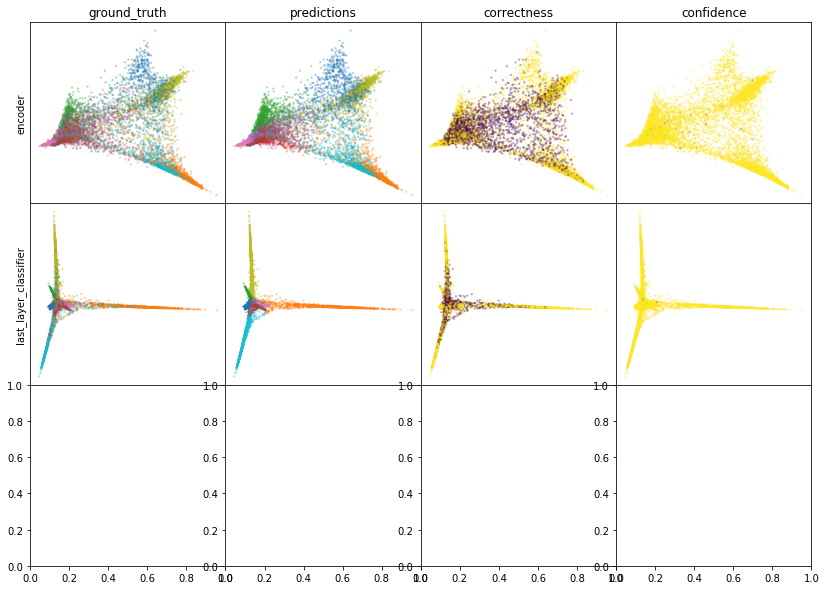

W0807 18:12:33.377835 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:12:34.409676 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:12:35.396490 140001524946752 legend.py:1282] No handles with labels found to put in legend.


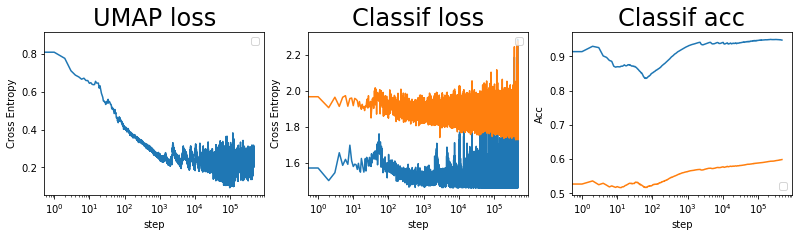

batch: 482000 | train acc: 0.9478 | val acc: 0.5989


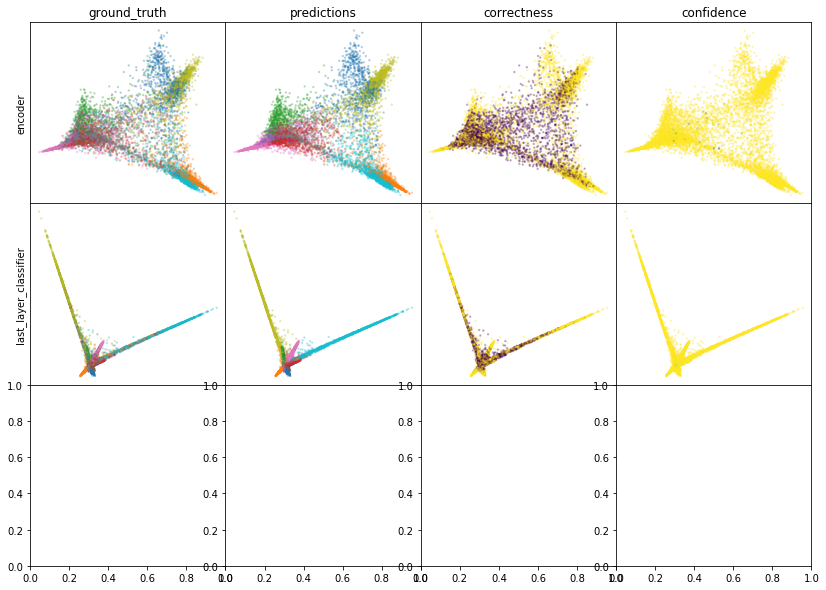

W0807 18:15:17.328601 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:15:18.380393 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:15:19.361688 140001524946752 legend.py:1282] No handles with labels found to put in legend.


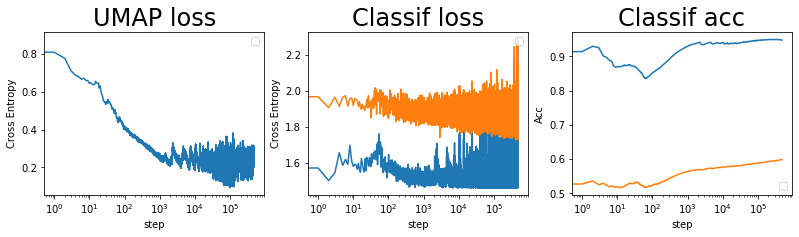

batch: 483000 | train acc: 0.9477 | val acc: 0.5989


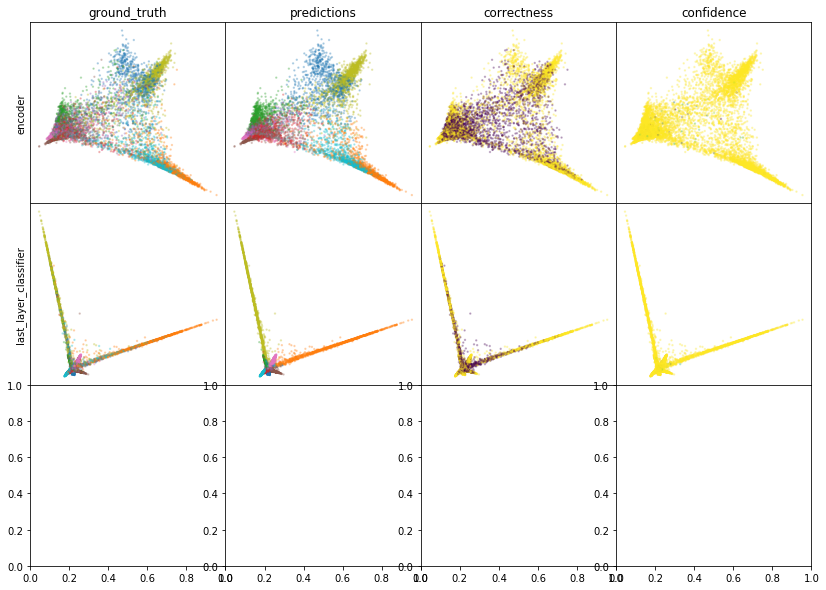

W0807 18:18:04.283829 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:18:05.336462 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:18:06.321026 140001524946752 legend.py:1282] No handles with labels found to put in legend.


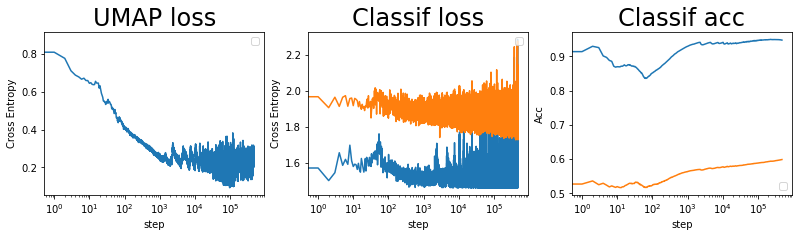

batch: 484000 | train acc: 0.9477 | val acc: 0.5989


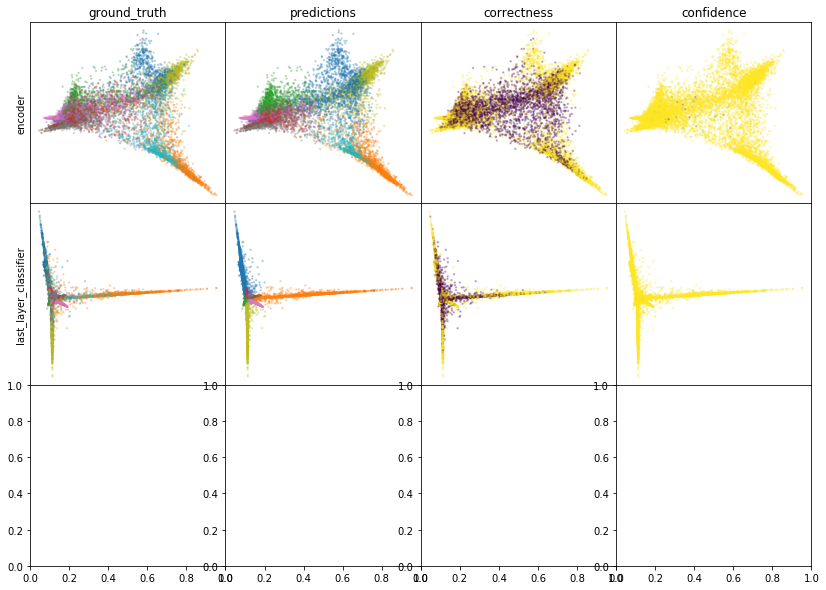

W0807 18:21:03.877566 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:21:04.969256 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:21:05.975139 140001524946752 legend.py:1282] No handles with labels found to put in legend.


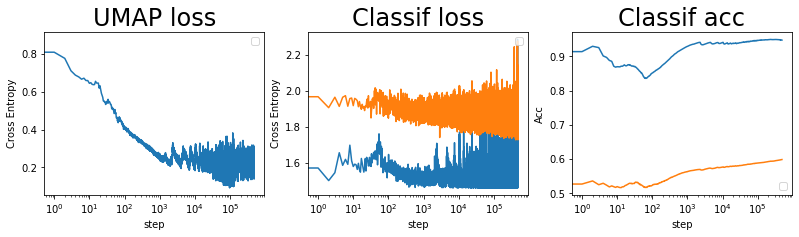

batch: 485000 | train acc: 0.9477 | val acc: 0.5989


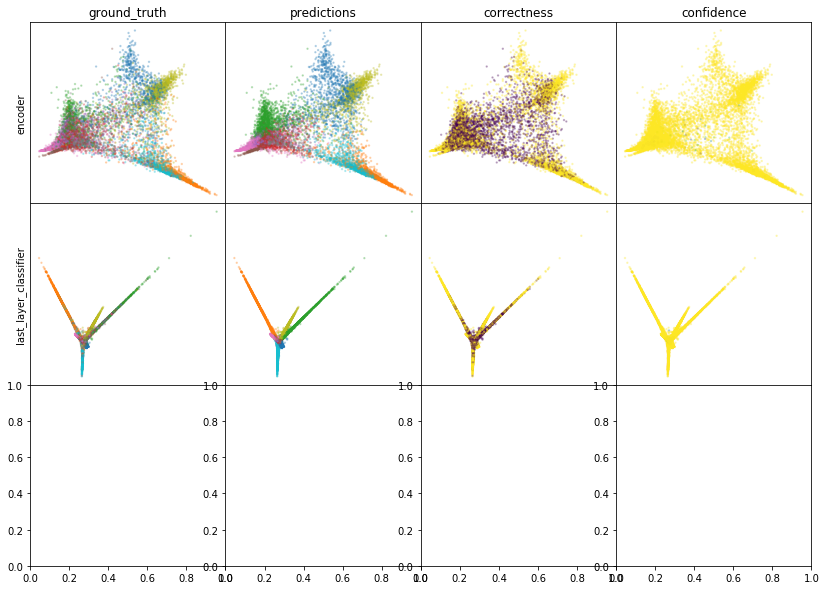

W0807 18:23:50.769806 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:23:51.821603 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:23:52.798434 140001524946752 legend.py:1282] No handles with labels found to put in legend.


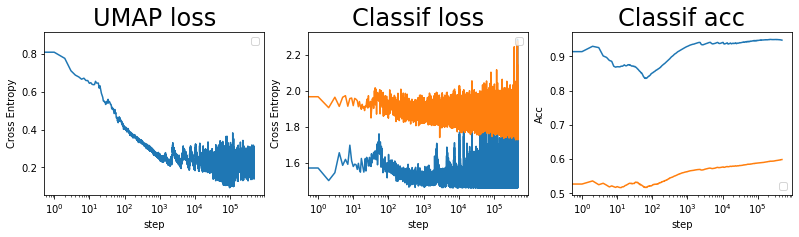

batch: 486000 | train acc: 0.9476 | val acc: 0.5989


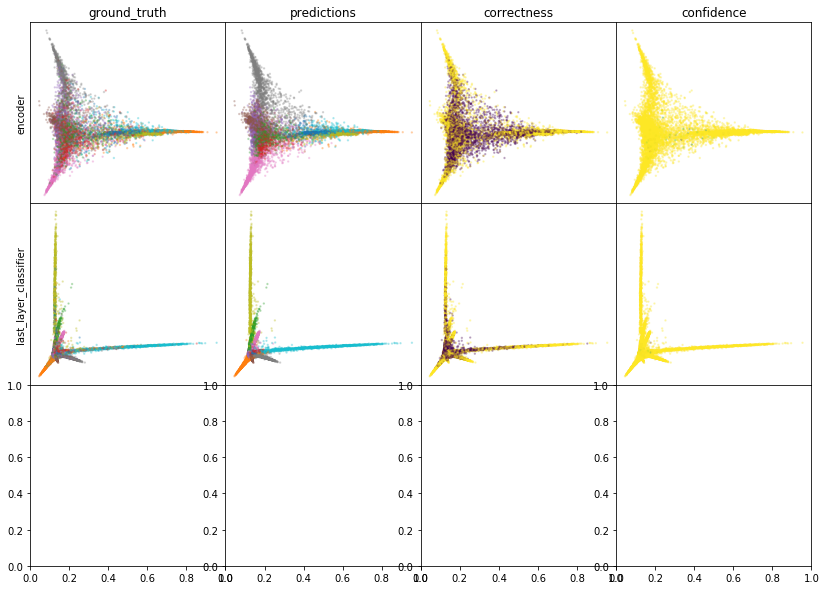

W0807 18:26:39.678096 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:26:40.736098 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:26:41.724629 140001524946752 legend.py:1282] No handles with labels found to put in legend.


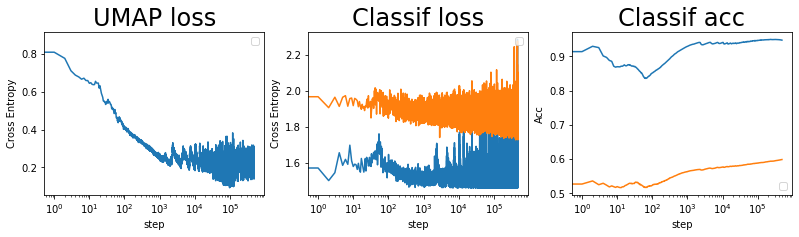

batch: 487000 | train acc: 0.9476 | val acc: 0.599


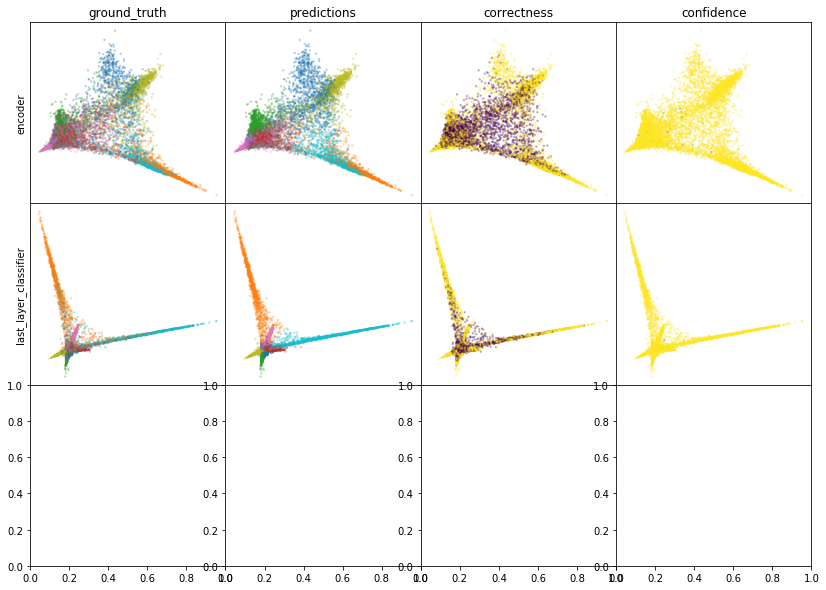

W0807 18:29:26.088969 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:29:27.152138 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:29:28.130430 140001524946752 legend.py:1282] No handles with labels found to put in legend.


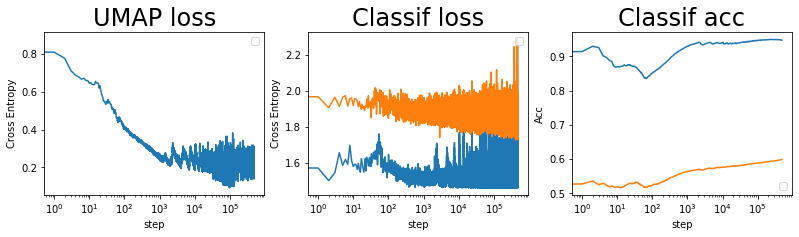

batch: 488000 | train acc: 0.9476 | val acc: 0.599


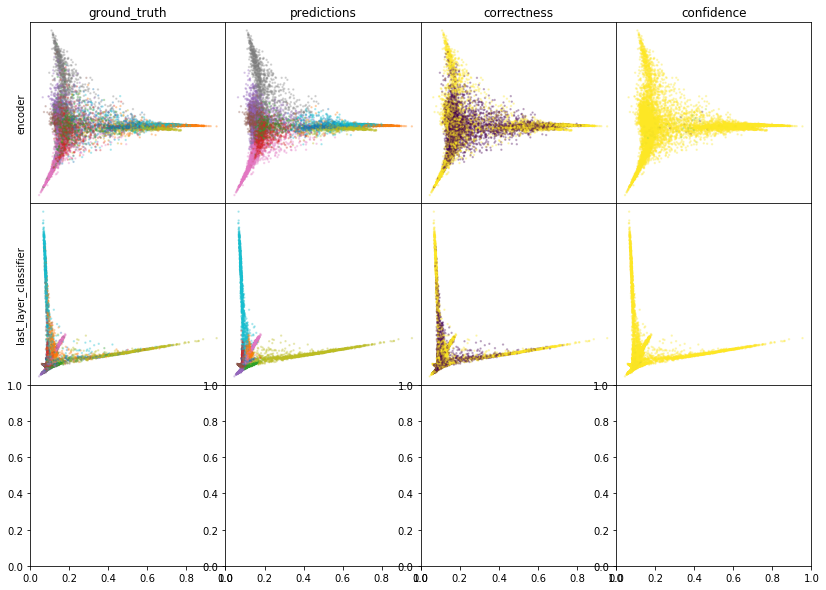

W0807 18:32:15.142291 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:32:16.209408 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:32:17.194917 140001524946752 legend.py:1282] No handles with labels found to put in legend.


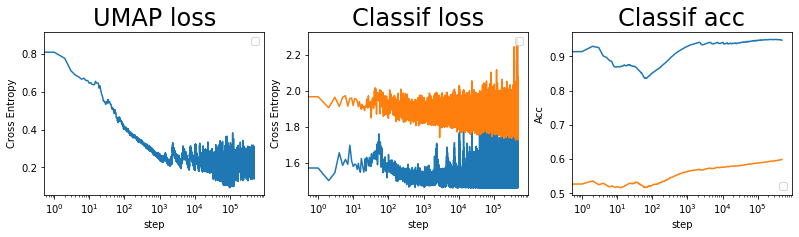

batch: 489000 | train acc: 0.9475 | val acc: 0.599


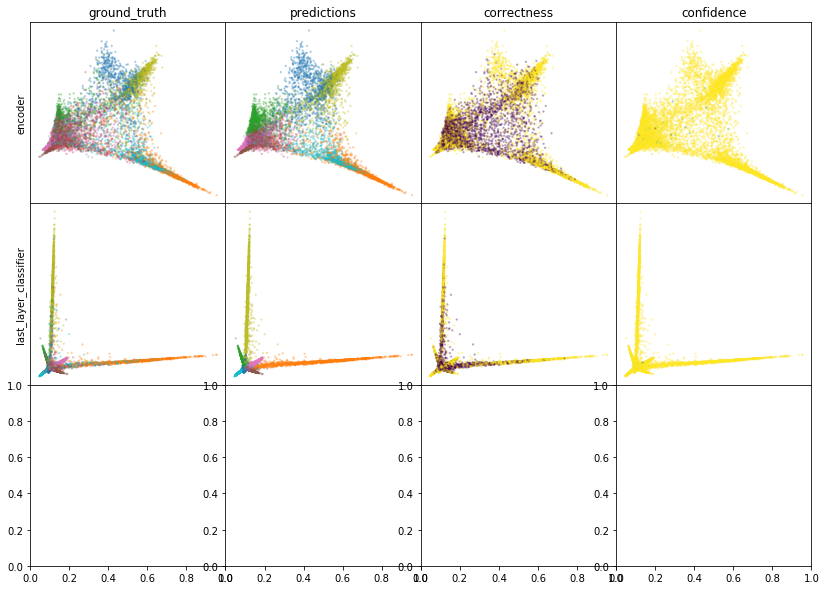

W0807 18:35:01.666834 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:35:02.731468 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:35:03.727064 140001524946752 legend.py:1282] No handles with labels found to put in legend.


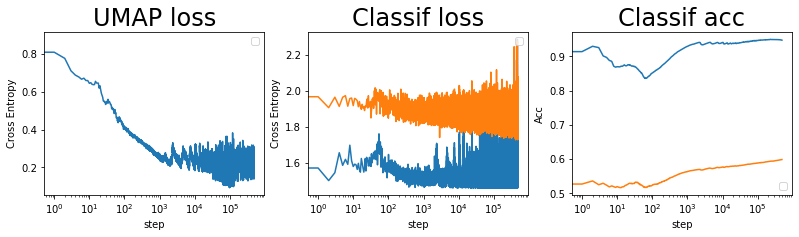

batch: 490000 | train acc: 0.9475 | val acc: 0.599


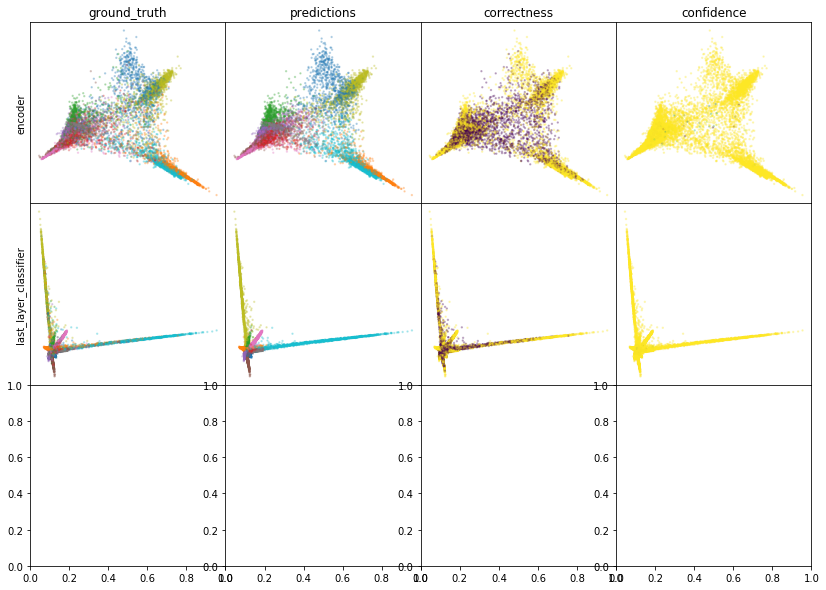

W0807 18:37:48.804223 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:37:49.862129 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:37:50.858510 140001524946752 legend.py:1282] No handles with labels found to put in legend.


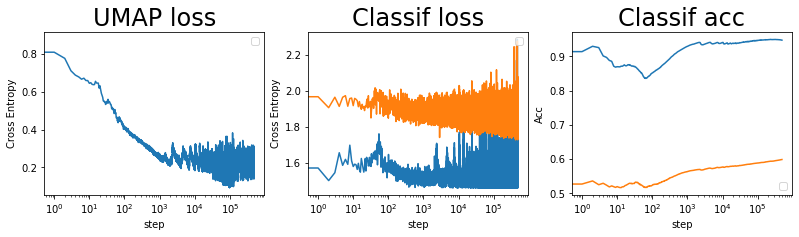

batch: 491000 | train acc: 0.9475 | val acc: 0.599


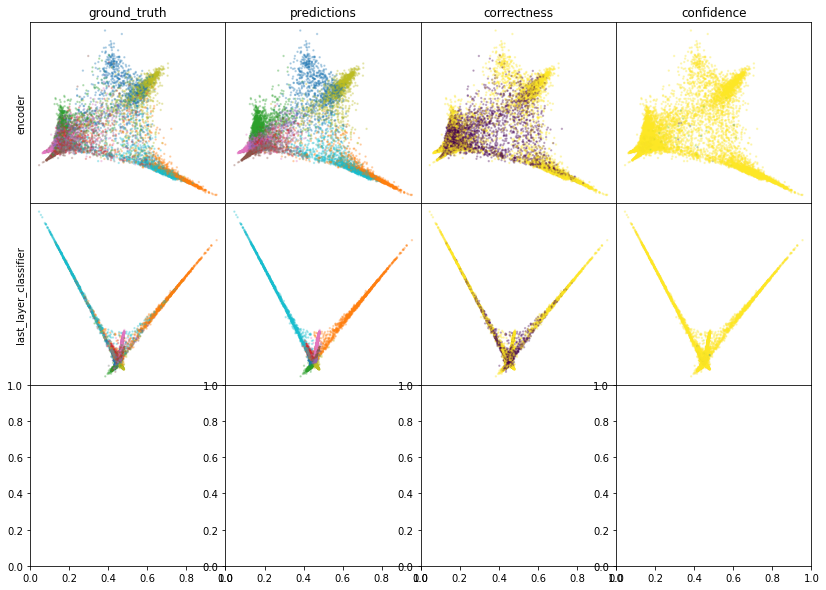

W0807 18:40:35.026676 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:40:36.104125 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:40:37.115544 140001524946752 legend.py:1282] No handles with labels found to put in legend.


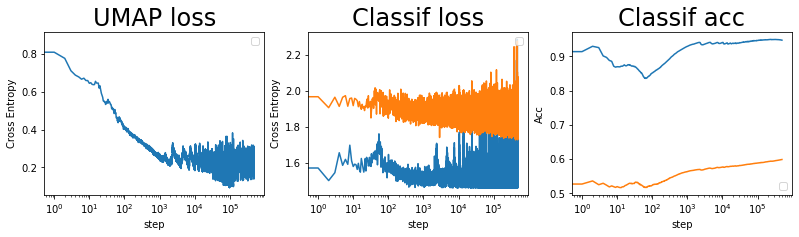

batch: 492000 | train acc: 0.9475 | val acc: 0.599


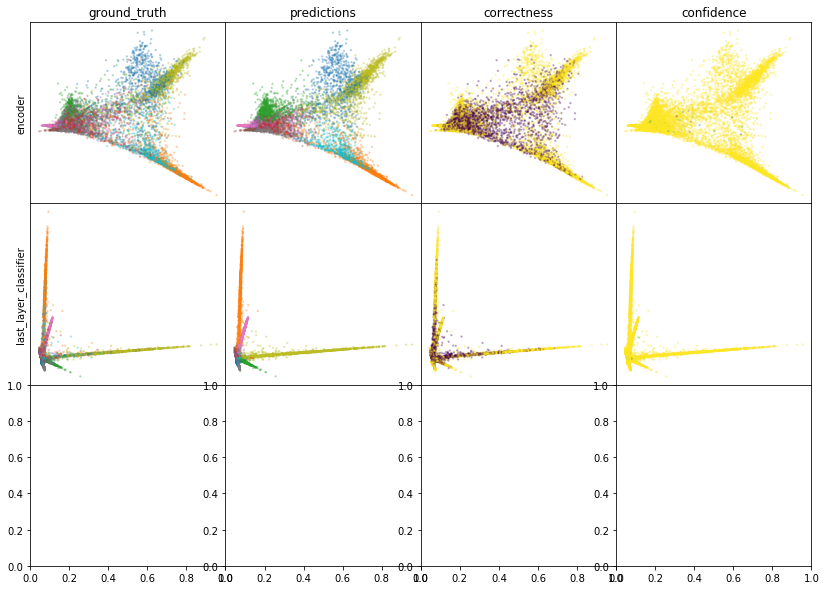

W0807 18:43:21.271535 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:43:22.348214 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:43:23.345759 140001524946752 legend.py:1282] No handles with labels found to put in legend.


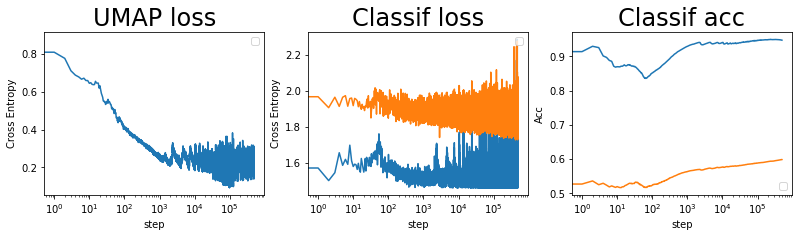

batch: 493000 | train acc: 0.9475 | val acc: 0.5991


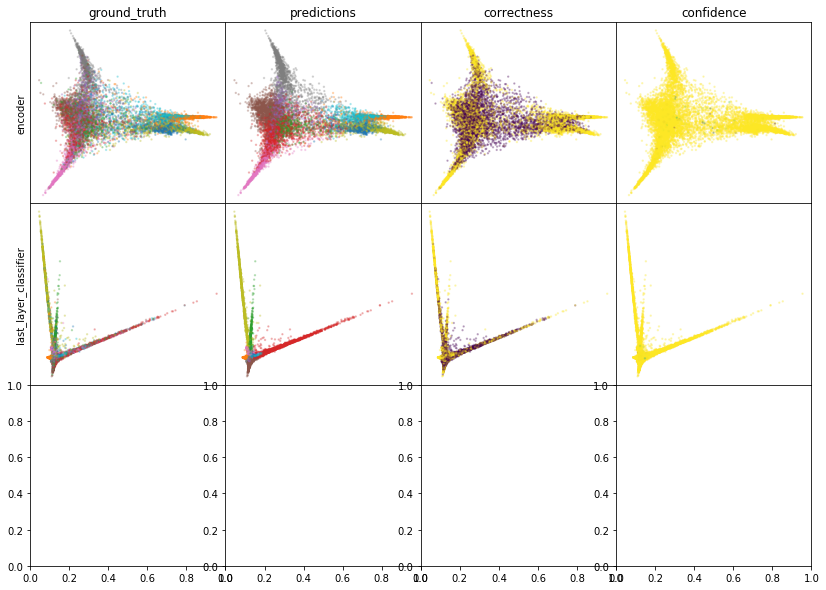

W0807 18:46:10.268581 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:46:11.331836 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:46:12.321605 140001524946752 legend.py:1282] No handles with labels found to put in legend.


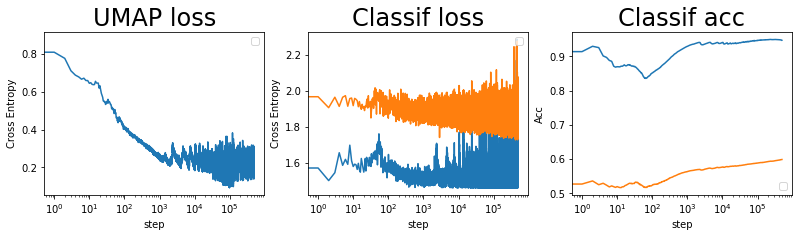

batch: 494000 | train acc: 0.9475 | val acc: 0.599


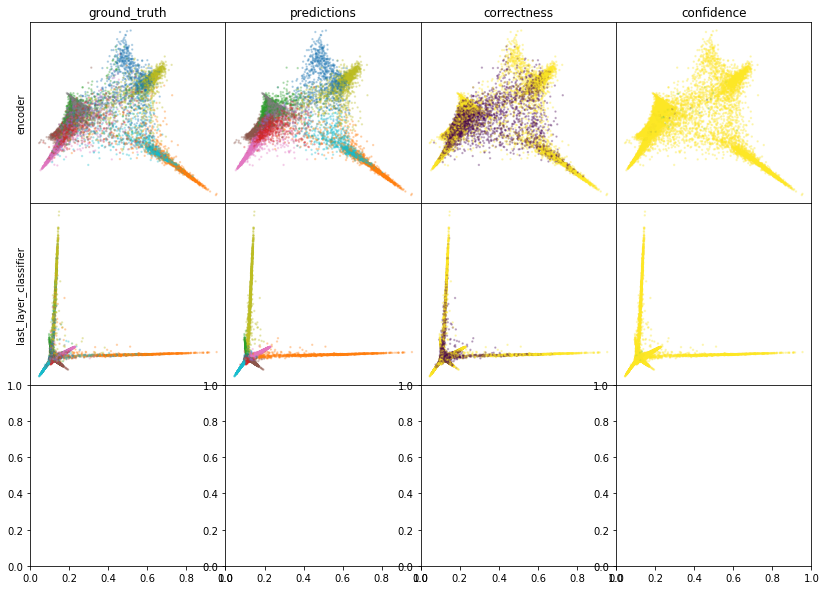

W0807 18:49:00.043631 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:49:01.120838 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:49:02.116103 140001524946752 legend.py:1282] No handles with labels found to put in legend.


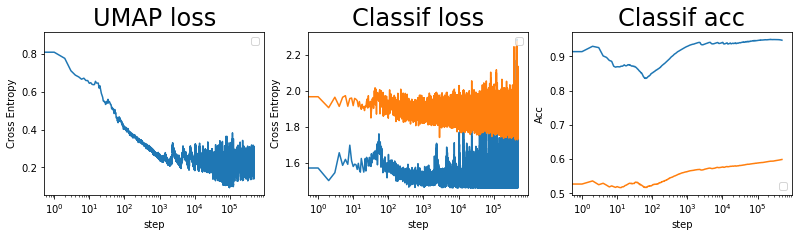

batch: 495000 | train acc: 0.9474 | val acc: 0.5991


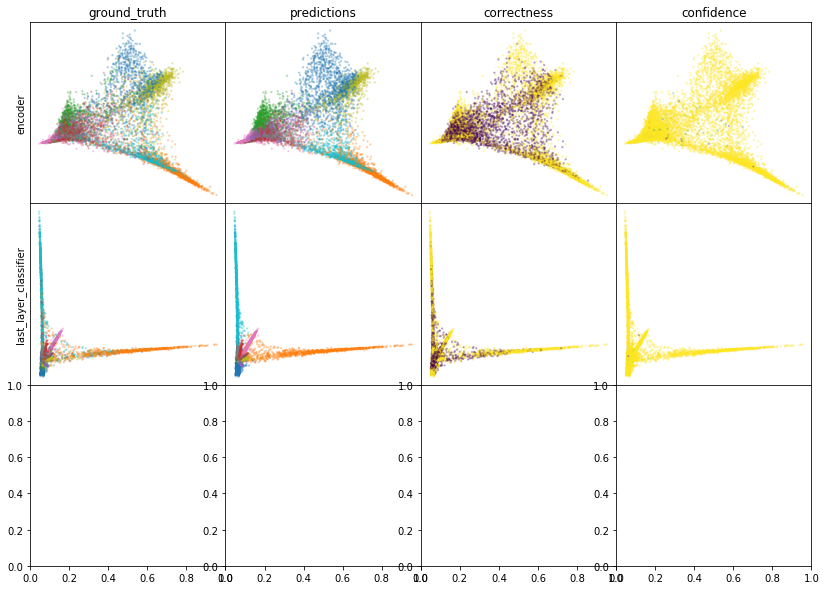

W0807 18:51:46.856106 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:51:47.929022 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:51:48.958647 140001524946752 legend.py:1282] No handles with labels found to put in legend.


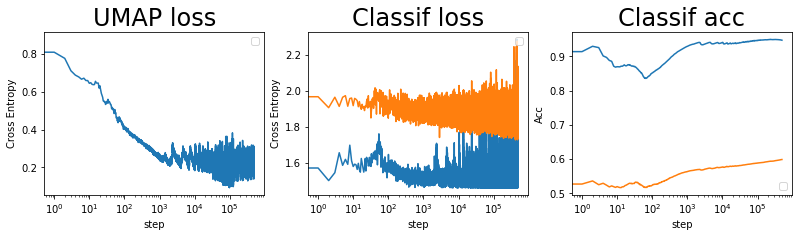

batch: 496000 | train acc: 0.9474 | val acc: 0.5991


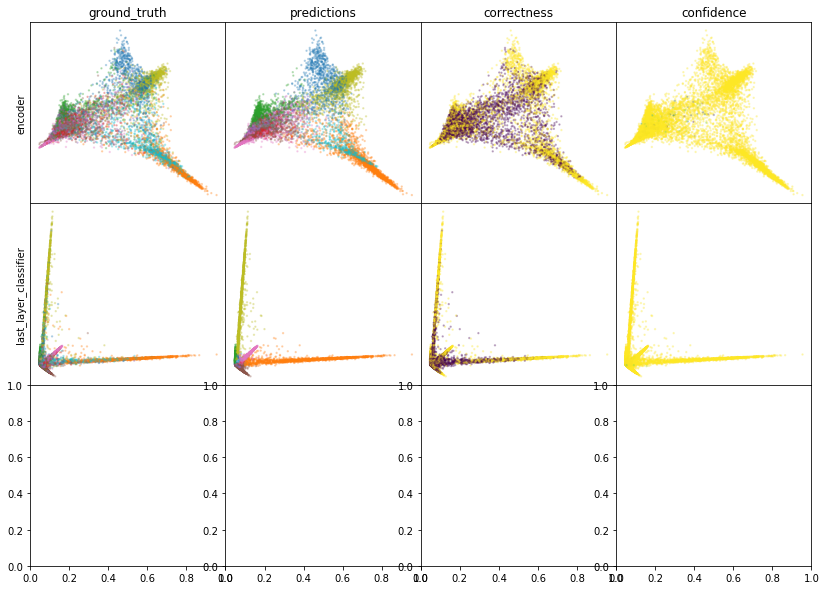

W0807 18:54:37.147292 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:54:38.212046 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:54:39.200549 140001524946752 legend.py:1282] No handles with labels found to put in legend.


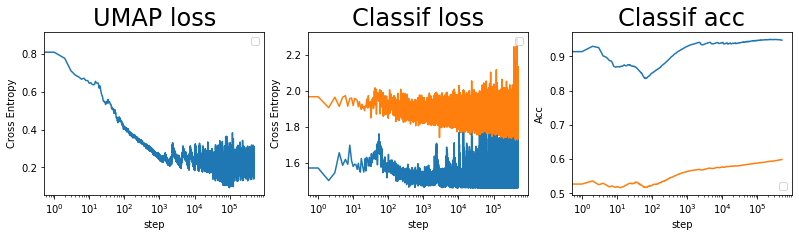

batch: 497000 | train acc: 0.9474 | val acc: 0.5991


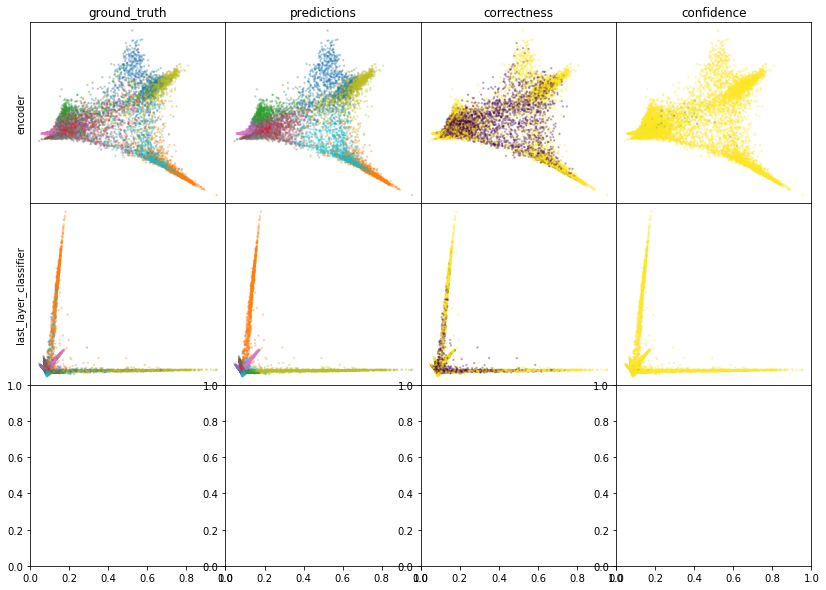

W0807 18:57:23.866625 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:57:24.945038 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 18:57:25.947010 140001524946752 legend.py:1282] No handles with labels found to put in legend.


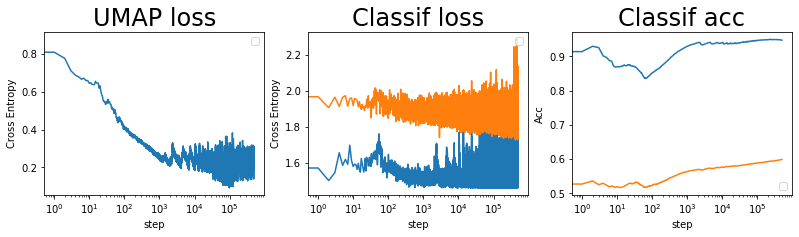

batch: 498000 | train acc: 0.9474 | val acc: 0.5991


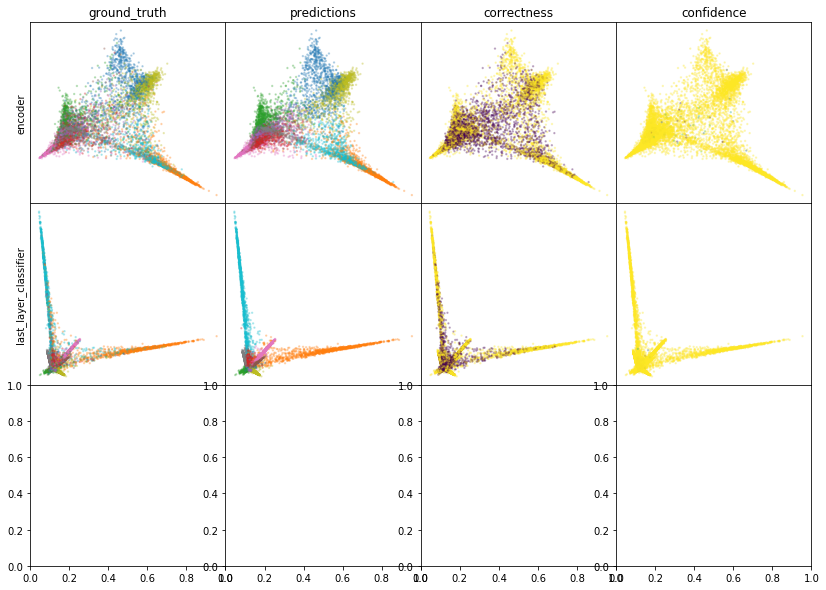

W0807 19:00:13.329374 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:00:14.446729 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:00:15.456066 140001524946752 legend.py:1282] No handles with labels found to put in legend.


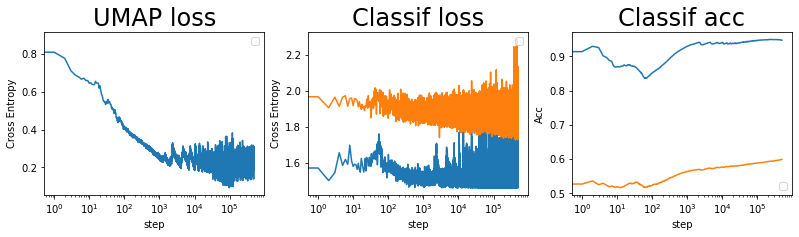

batch: 499000 | train acc: 0.9474 | val acc: 0.5991


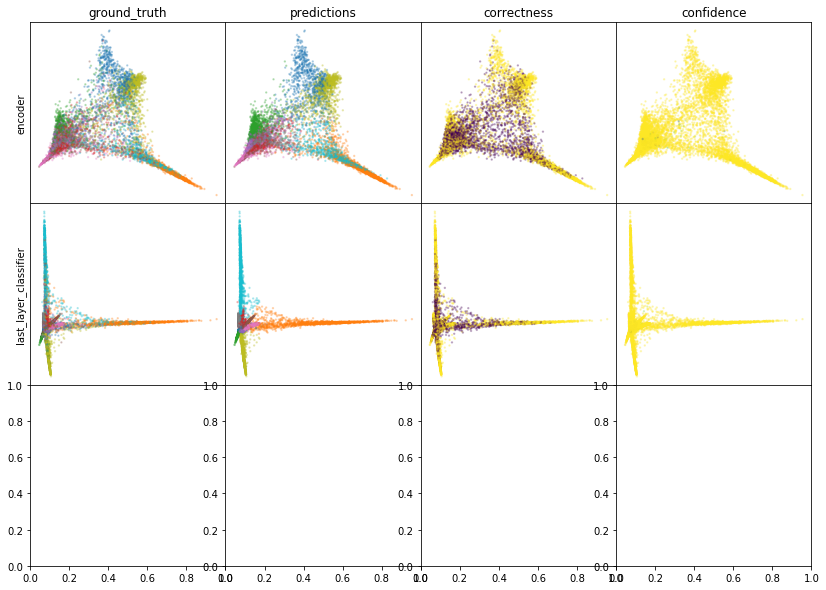

W0807 19:03:01.174281 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:03:02.291670 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:03:03.289487 140001524946752 legend.py:1282] No handles with labels found to put in legend.


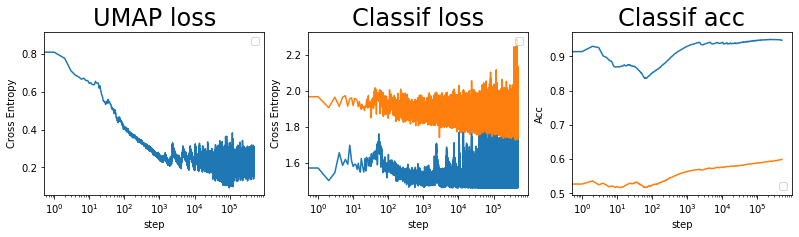

batch: 500000 | train acc: 0.9473 | val acc: 0.5991


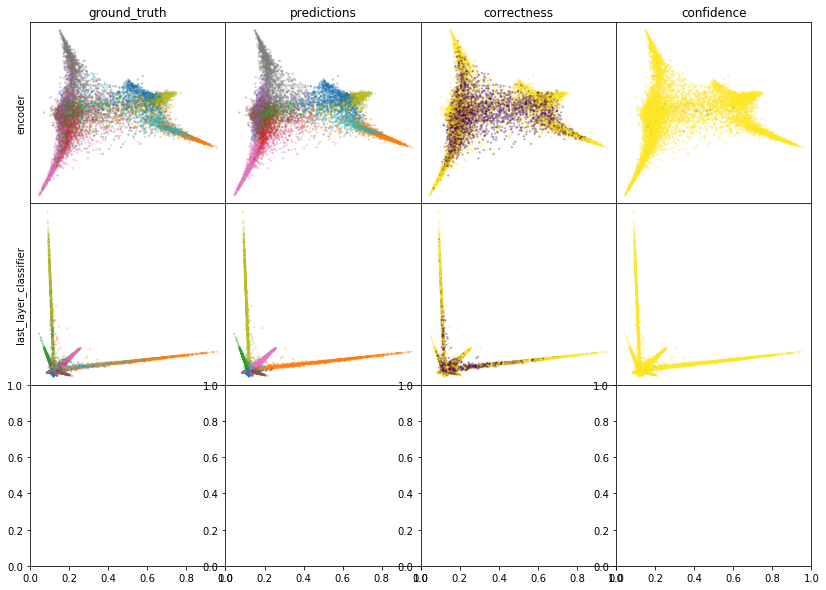

W0807 19:05:50.657207 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:05:51.742589 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:05:52.750169 140001524946752 legend.py:1282] No handles with labels found to put in legend.


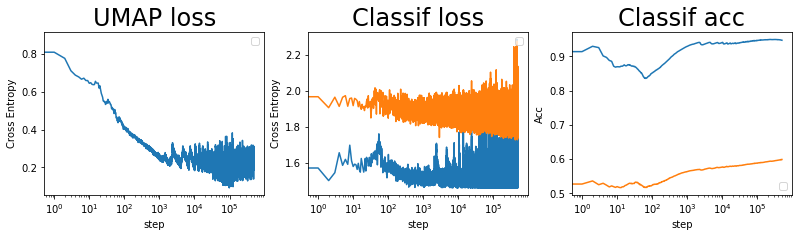

batch: 501000 | train acc: 0.9473 | val acc: 0.5991


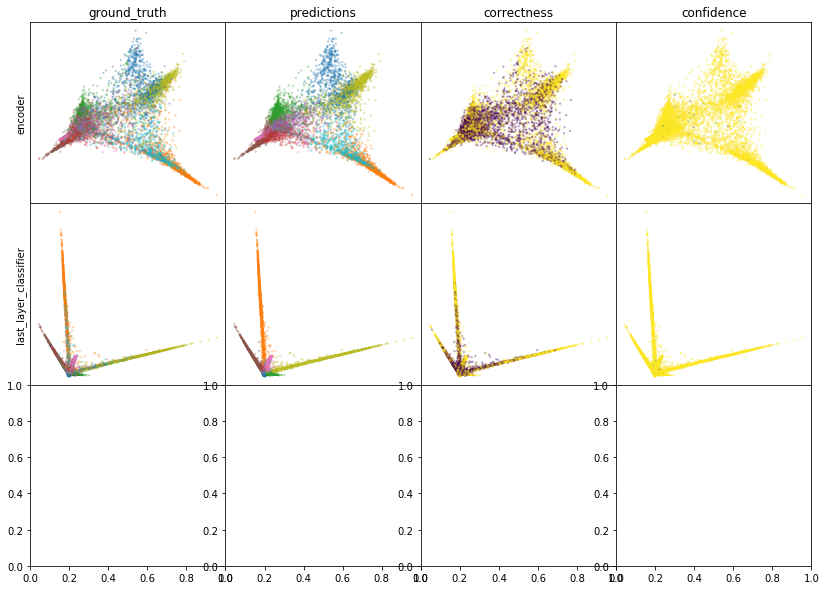

W0807 19:08:39.334455 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:08:40.428642 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:08:41.450365 140001524946752 legend.py:1282] No handles with labels found to put in legend.


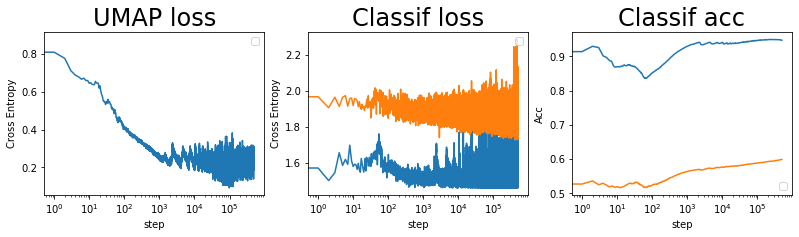

batch: 502000 | train acc: 0.9473 | val acc: 0.5991


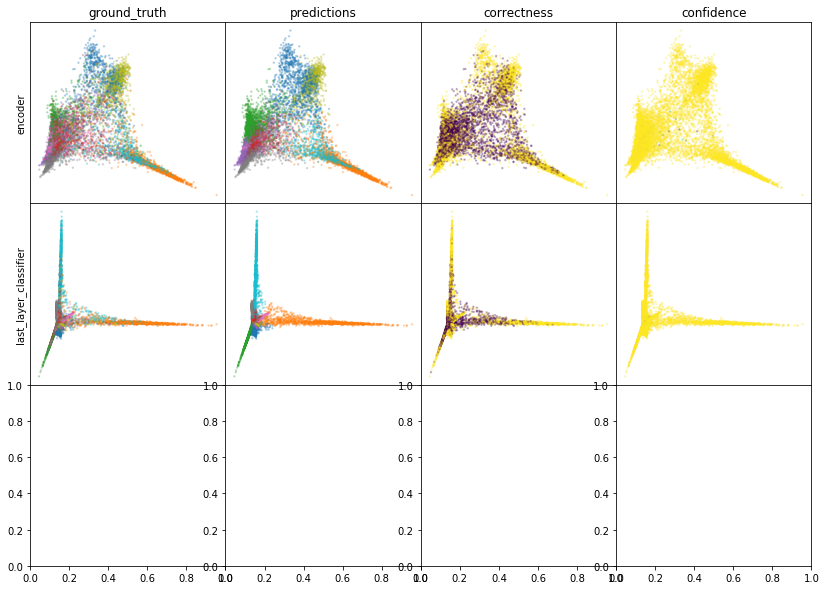

W0807 19:11:28.764657 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:11:29.853543 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:11:30.885225 140001524946752 legend.py:1282] No handles with labels found to put in legend.


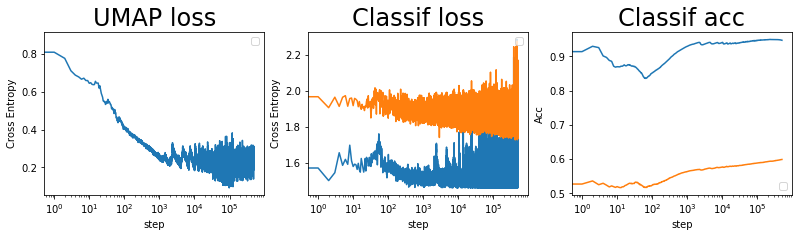

batch: 503000 | train acc: 0.9473 | val acc: 0.5991


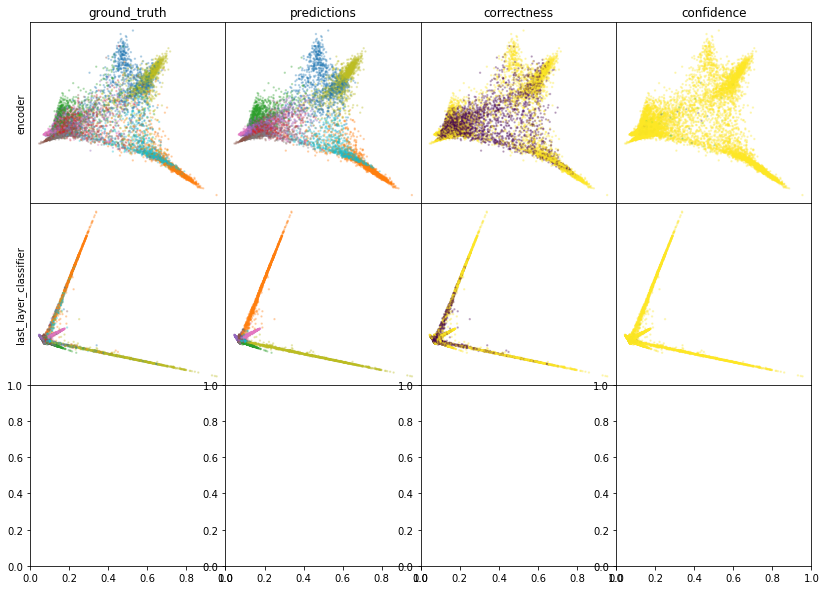

W0807 19:14:18.521667 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:14:19.616327 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:14:20.664598 140001524946752 legend.py:1282] No handles with labels found to put in legend.


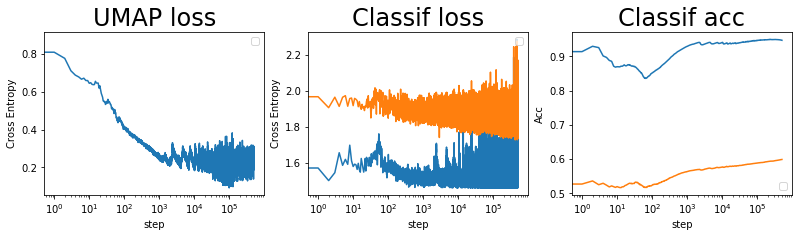

batch: 504000 | train acc: 0.9472 | val acc: 0.5991


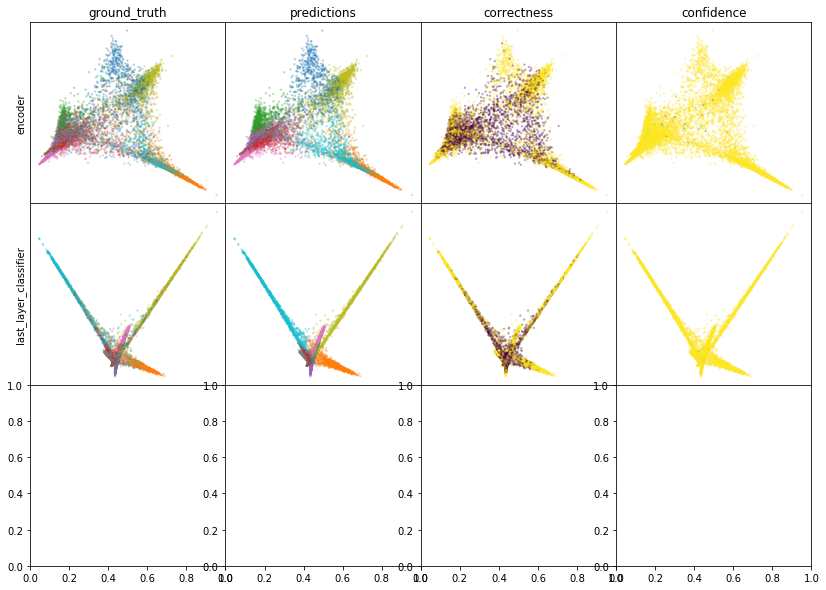

W0807 19:17:08.314482 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:17:09.412557 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:17:10.429792 140001524946752 legend.py:1282] No handles with labels found to put in legend.


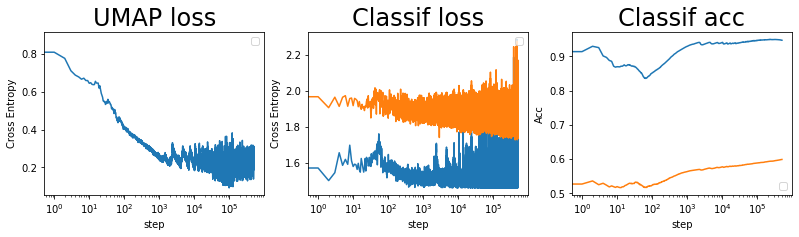

batch: 505000 | train acc: 0.9472 | val acc: 0.5992


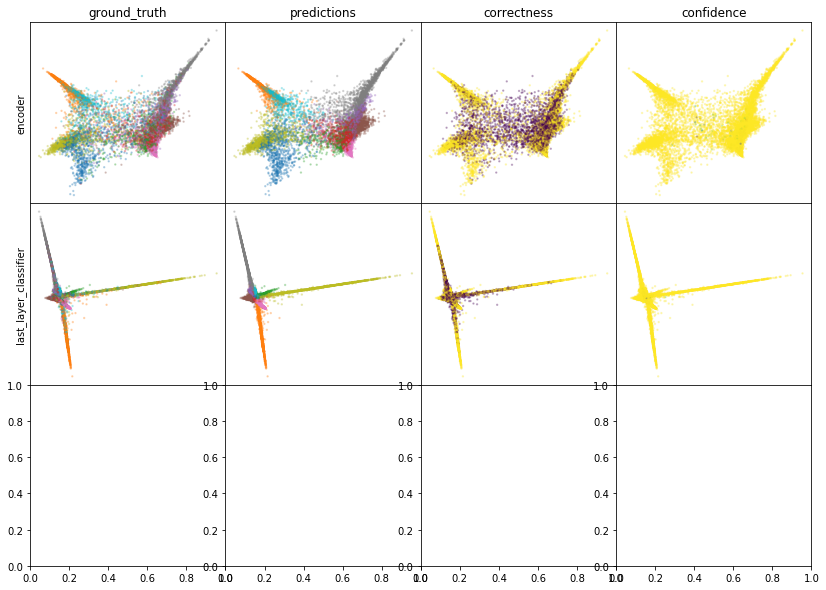

W0807 19:19:58.463427 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:19:59.556360 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:20:00.576803 140001524946752 legend.py:1282] No handles with labels found to put in legend.


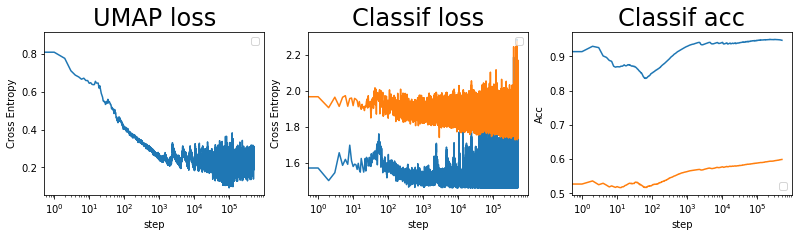

batch: 506000 | train acc: 0.9472 | val acc: 0.5992


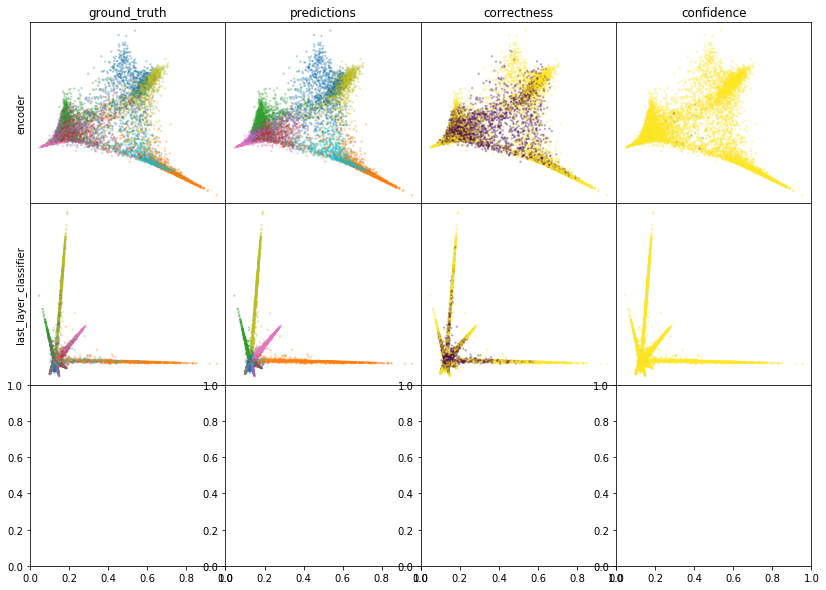

W0807 19:22:48.572353 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:22:49.680770 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:22:50.691371 140001524946752 legend.py:1282] No handles with labels found to put in legend.


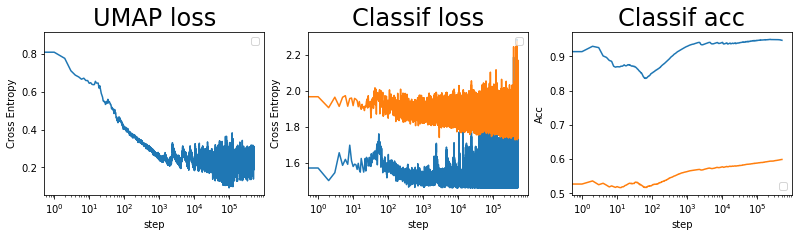

batch: 507000 | train acc: 0.9472 | val acc: 0.5992


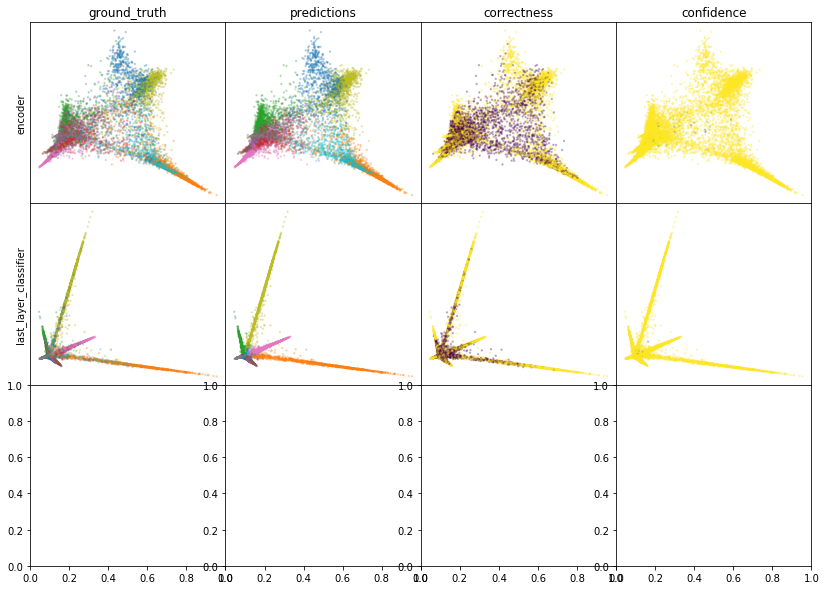

W0807 19:25:38.584306 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:25:39.675270 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:25:40.710726 140001524946752 legend.py:1282] No handles with labels found to put in legend.


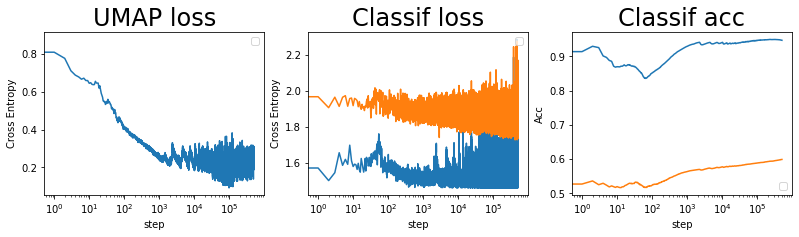

batch: 508000 | train acc: 0.9472 | val acc: 0.5992


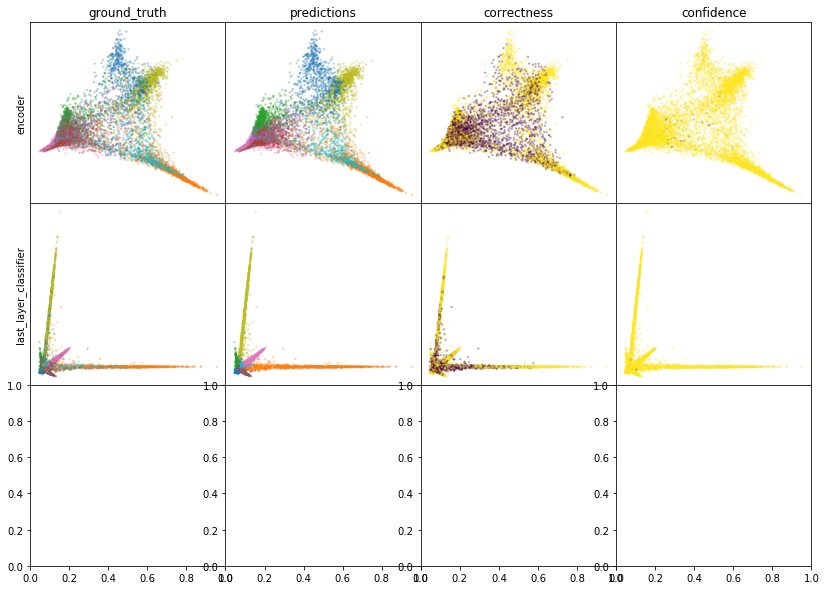

W0807 19:28:28.880537 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:28:29.991166 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:28:31.040946 140001524946752 legend.py:1282] No handles with labels found to put in legend.


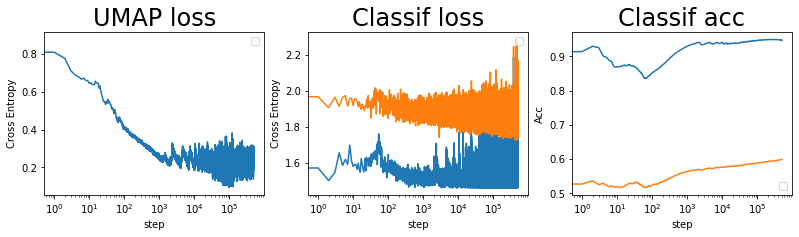

batch: 509000 | train acc: 0.9472 | val acc: 0.5992


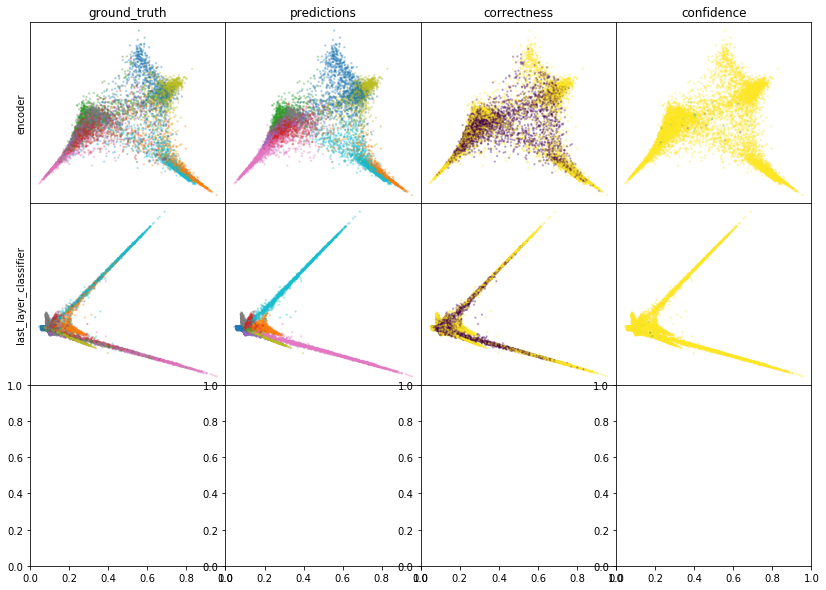

W0807 19:31:20.024876 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:31:21.143256 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:31:22.171458 140001524946752 legend.py:1282] No handles with labels found to put in legend.


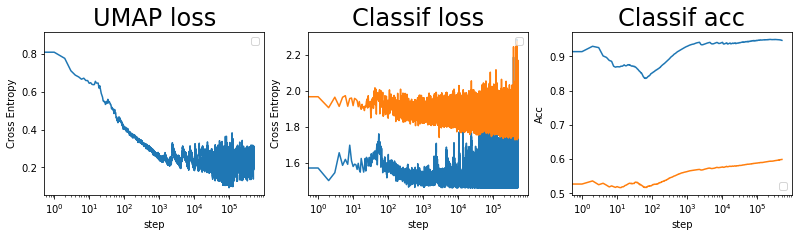

batch: 510000 | train acc: 0.9471 | val acc: 0.5992


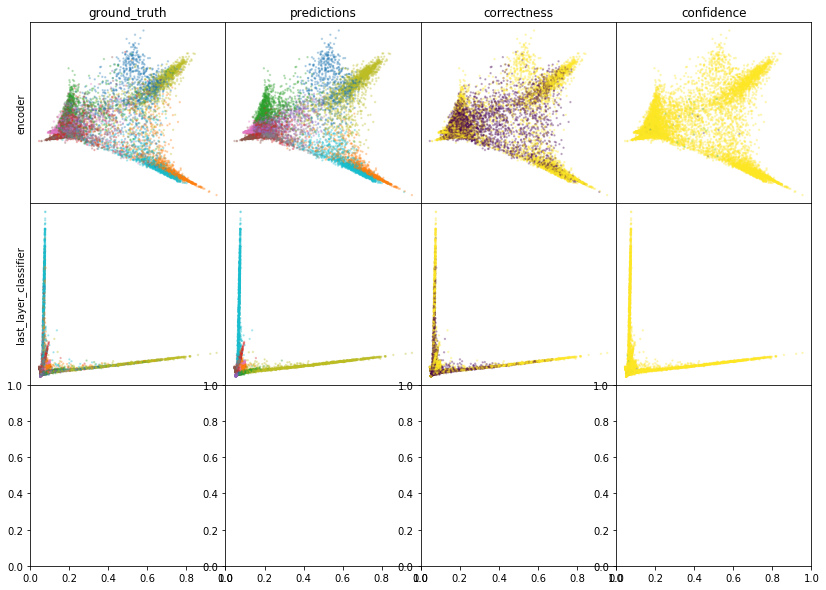

W0807 19:34:11.085509 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:34:12.208538 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:34:13.243430 140001524946752 legend.py:1282] No handles with labels found to put in legend.


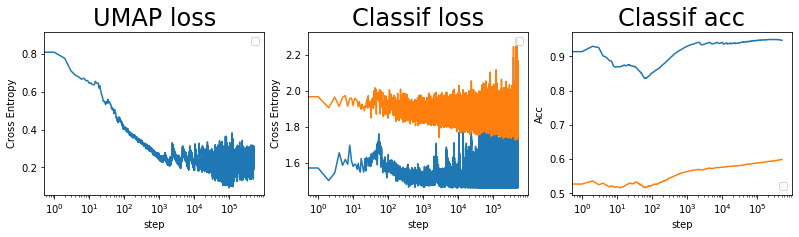

batch: 511000 | train acc: 0.9471 | val acc: 0.5992
leaving epoch because no improvement in 10000 batches


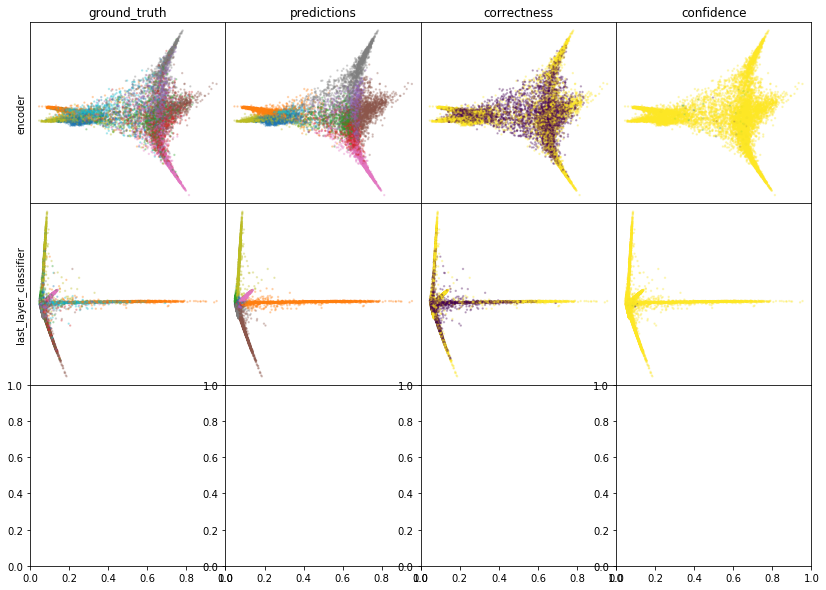

W0807 19:37:18.233105 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:37:19.364110 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:37:20.414911 140001524946752 legend.py:1282] No handles with labels found to put in legend.


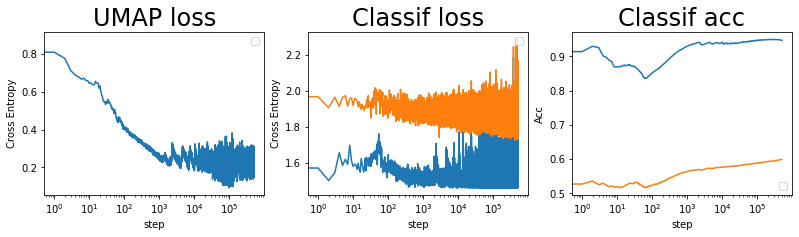

batch: 512000 | train acc: 0.9471 | val acc: 0.5992


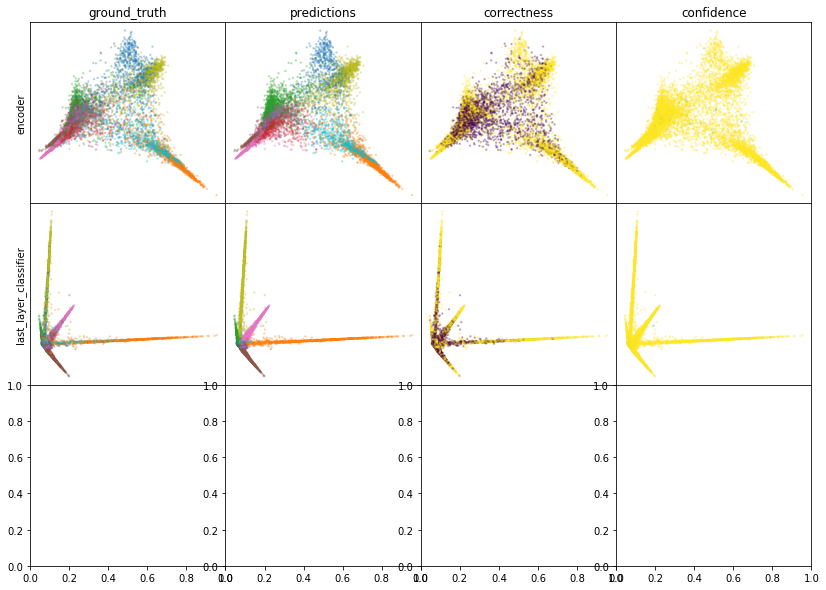

W0807 19:40:10.171408 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:40:11.280972 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:40:12.319637 140001524946752 legend.py:1282] No handles with labels found to put in legend.


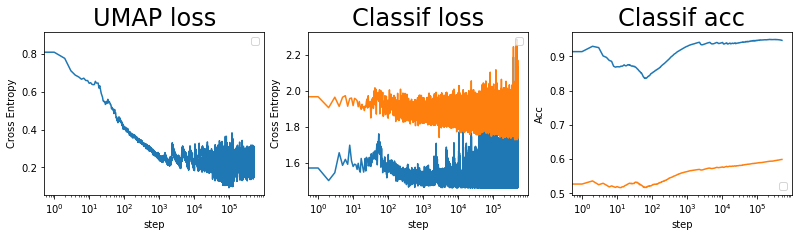

batch: 513000 | train acc: 0.947 | val acc: 0.5992


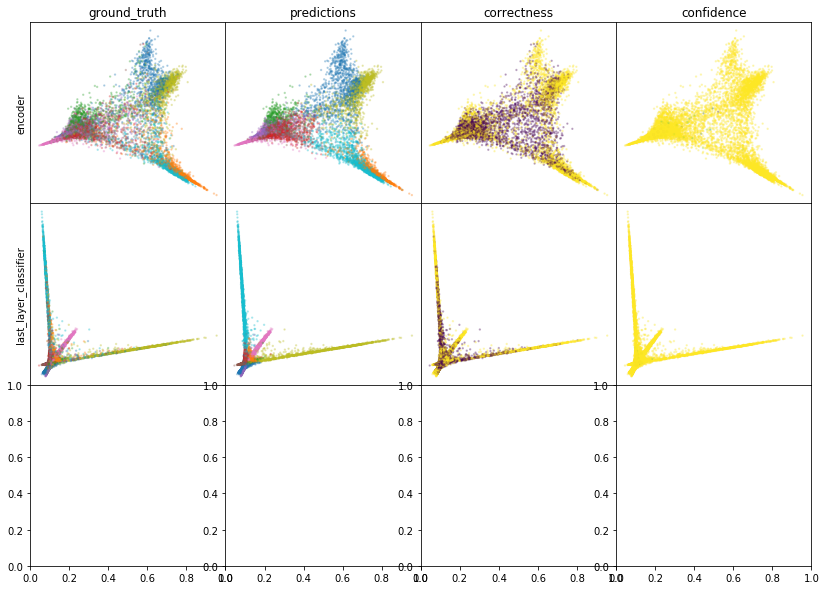

W0807 19:42:58.383647 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:42:59.501883 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:43:00.541499 140001524946752 legend.py:1282] No handles with labels found to put in legend.


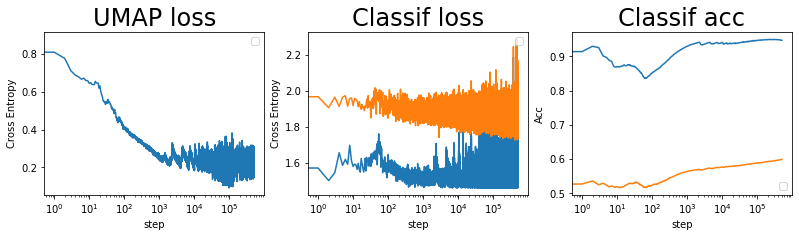

batch: 514000 | train acc: 0.947 | val acc: 0.5992


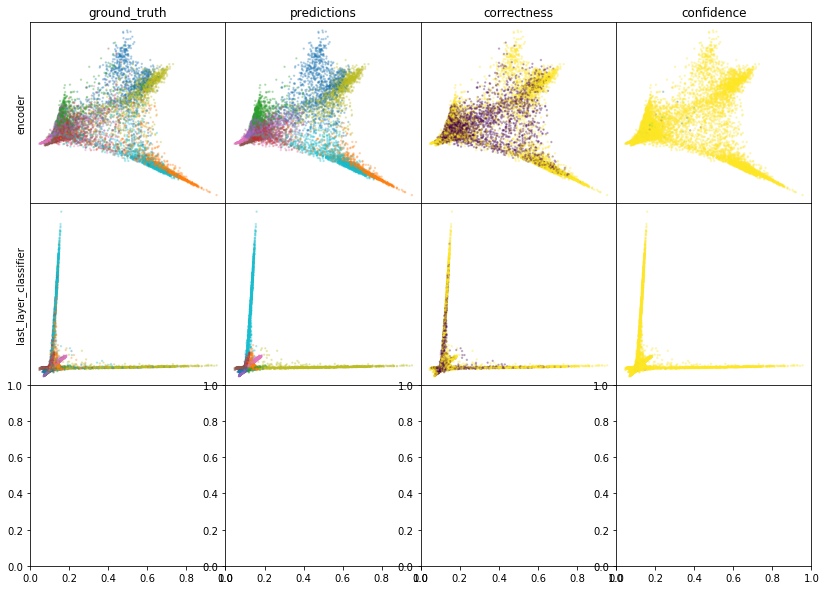

W0807 19:45:51.496902 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:45:52.610021 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:45:53.657268 140001524946752 legend.py:1282] No handles with labels found to put in legend.


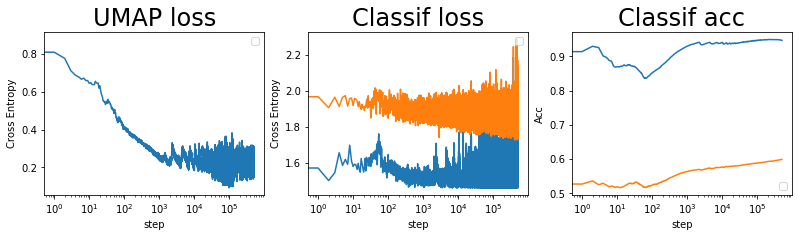

batch: 515000 | train acc: 0.9469 | val acc: 0.5992


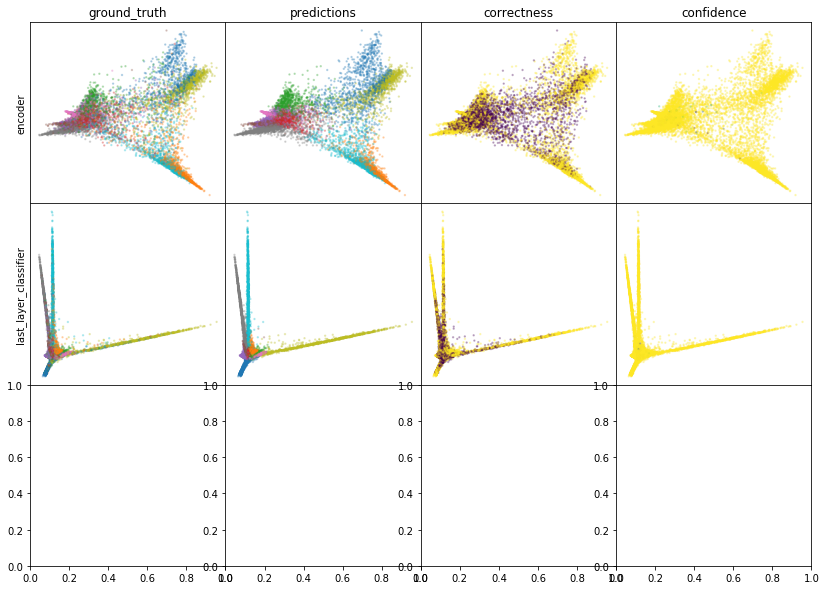

W0807 19:48:43.303372 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:48:44.420634 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:48:45.459360 140001524946752 legend.py:1282] No handles with labels found to put in legend.


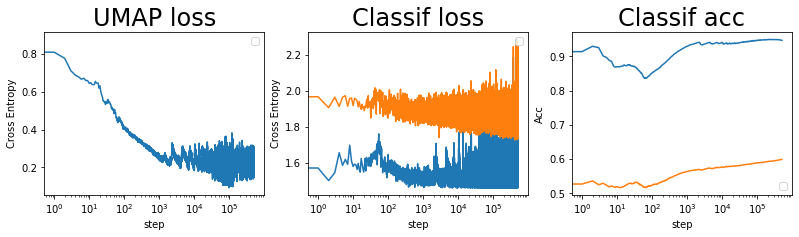

batch: 516000 | train acc: 0.9469 | val acc: 0.5993


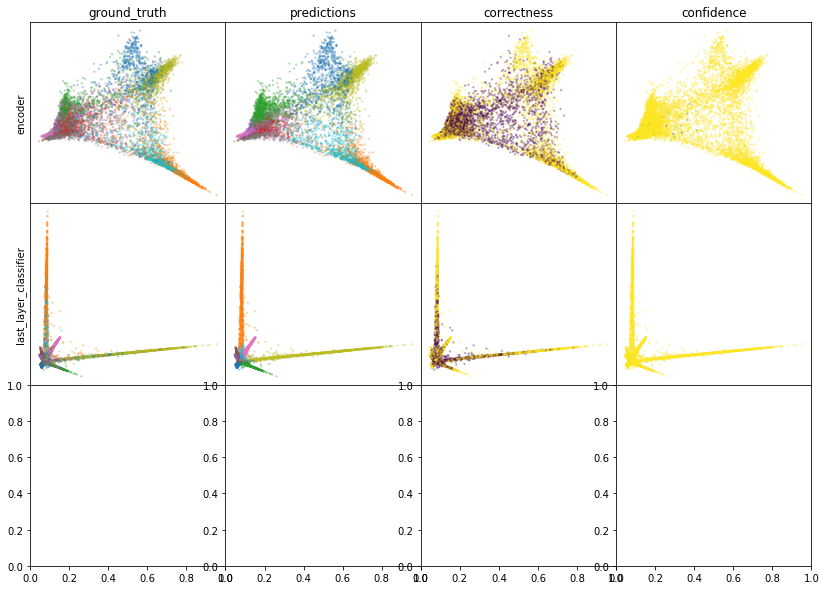

W0807 19:51:35.551210 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:51:36.667260 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:51:37.712437 140001524946752 legend.py:1282] No handles with labels found to put in legend.


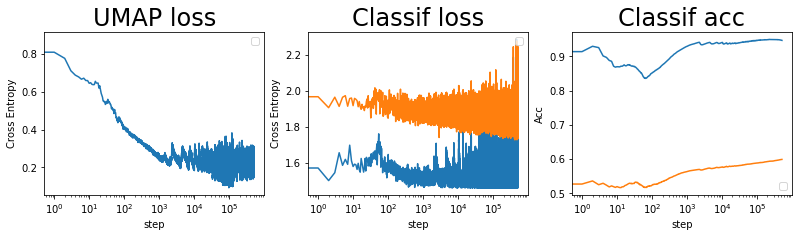

batch: 517000 | train acc: 0.9469 | val acc: 0.5993


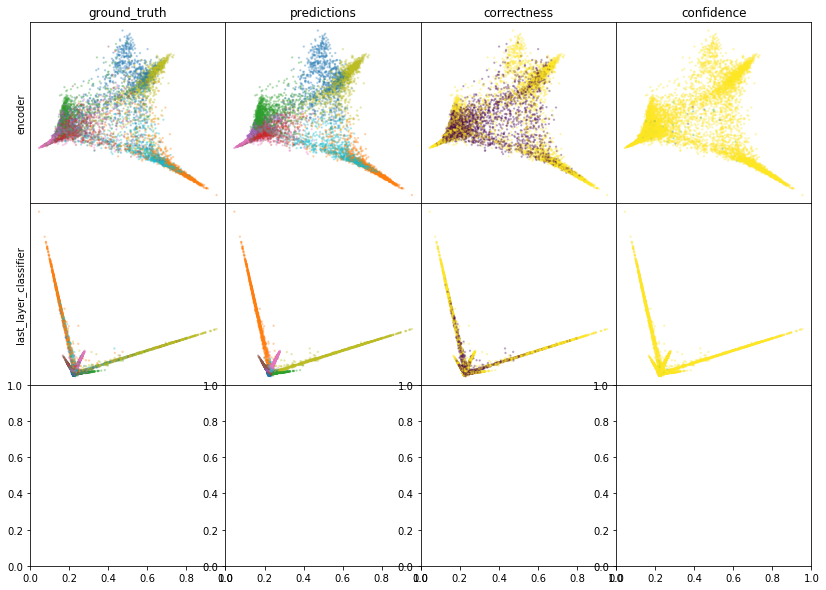

W0807 19:54:28.543925 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:54:29.679053 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:54:30.725322 140001524946752 legend.py:1282] No handles with labels found to put in legend.


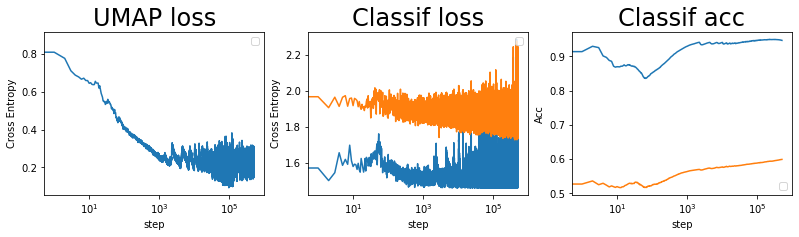

batch: 518000 | train acc: 0.9469 | val acc: 0.5993


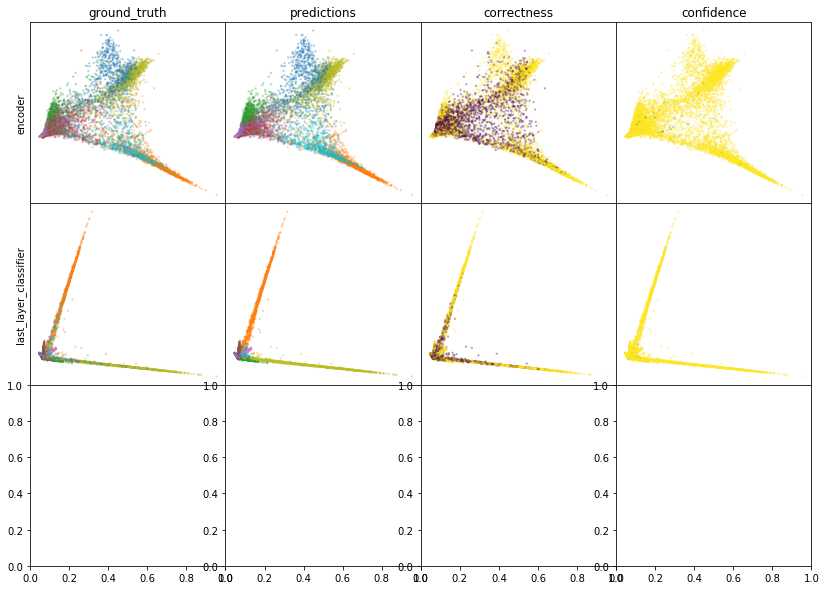

W0807 19:57:20.738263 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:57:21.866259 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 19:57:22.909301 140001524946752 legend.py:1282] No handles with labels found to put in legend.


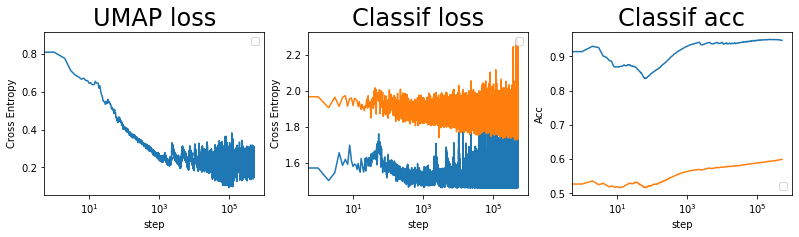

batch: 519000 | train acc: 0.9469 | val acc: 0.5993


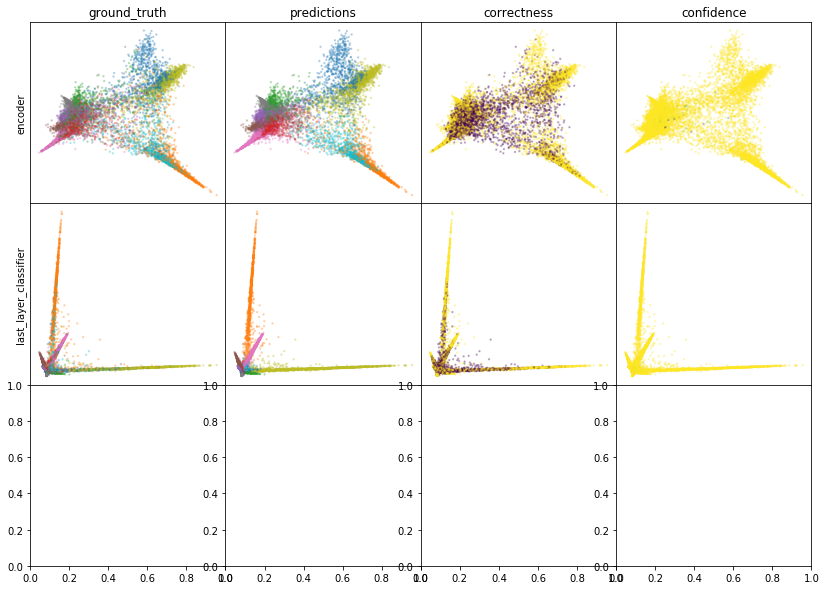

W0807 20:00:13.848160 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:00:14.986899 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:00:16.038285 140001524946752 legend.py:1282] No handles with labels found to put in legend.


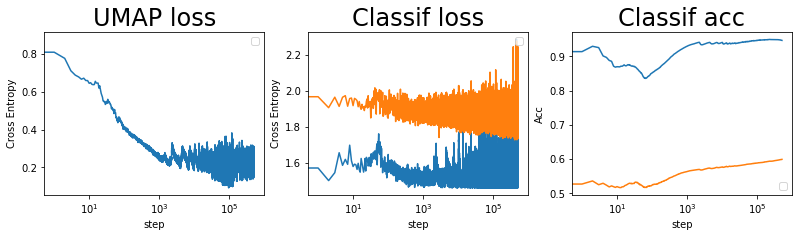

batch: 520000 | train acc: 0.9469 | val acc: 0.5993


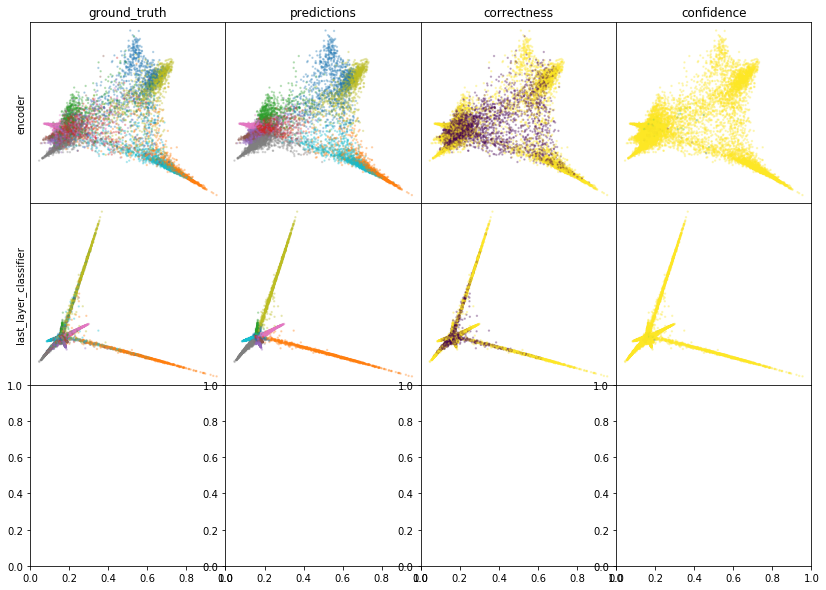

W0807 20:03:03.991490 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:03:05.107475 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:03:06.161948 140001524946752 legend.py:1282] No handles with labels found to put in legend.


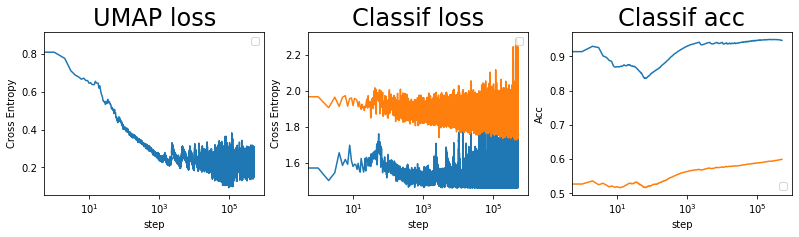

batch: 521000 | train acc: 0.9469 | val acc: 0.5994


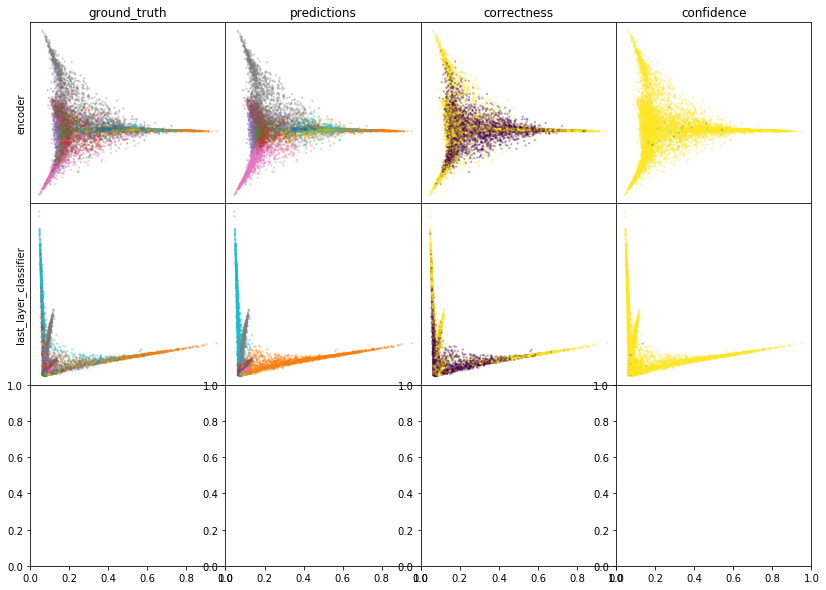

W0807 20:05:54.568993 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:05:55.701535 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:05:56.745301 140001524946752 legend.py:1282] No handles with labels found to put in legend.


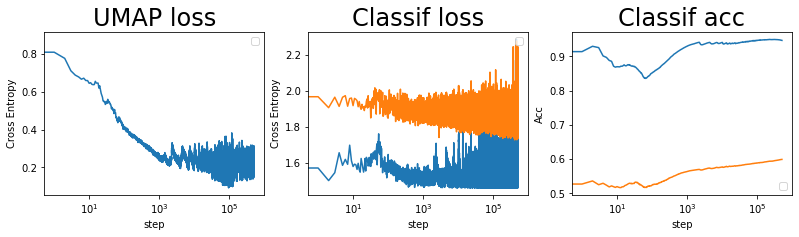

batch: 522000 | train acc: 0.9468 | val acc: 0.5994


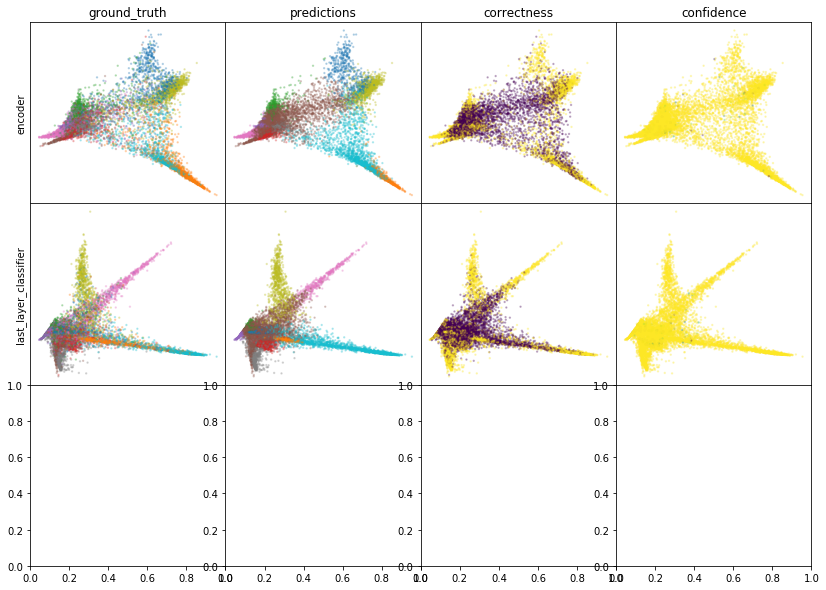

W0807 20:08:47.598692 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:08:48.744616 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:08:49.801167 140001524946752 legend.py:1282] No handles with labels found to put in legend.


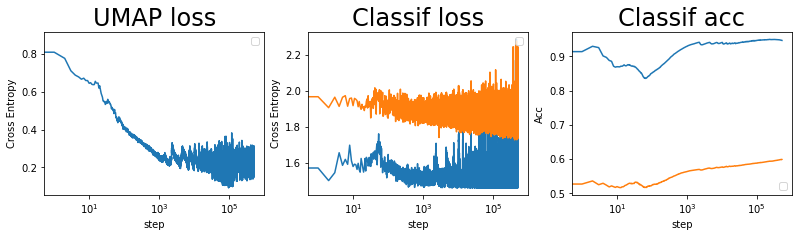

batch: 523000 | train acc: 0.9468 | val acc: 0.5994


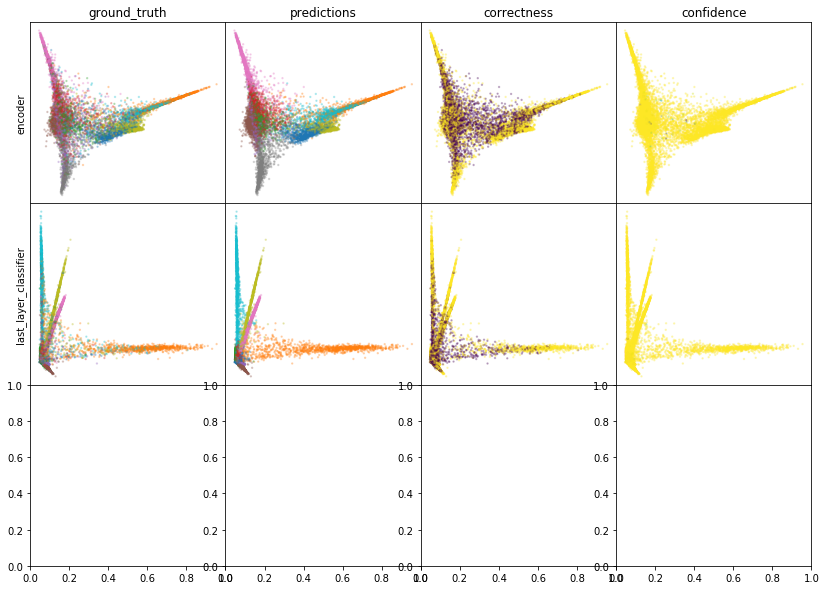

W0807 20:11:39.692486 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:11:40.830311 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:11:41.879757 140001524946752 legend.py:1282] No handles with labels found to put in legend.


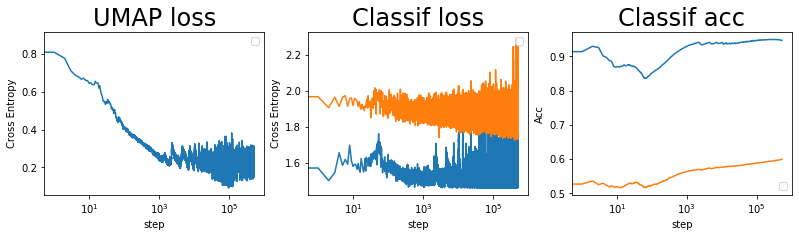

batch: 524000 | train acc: 0.9468 | val acc: 0.5994


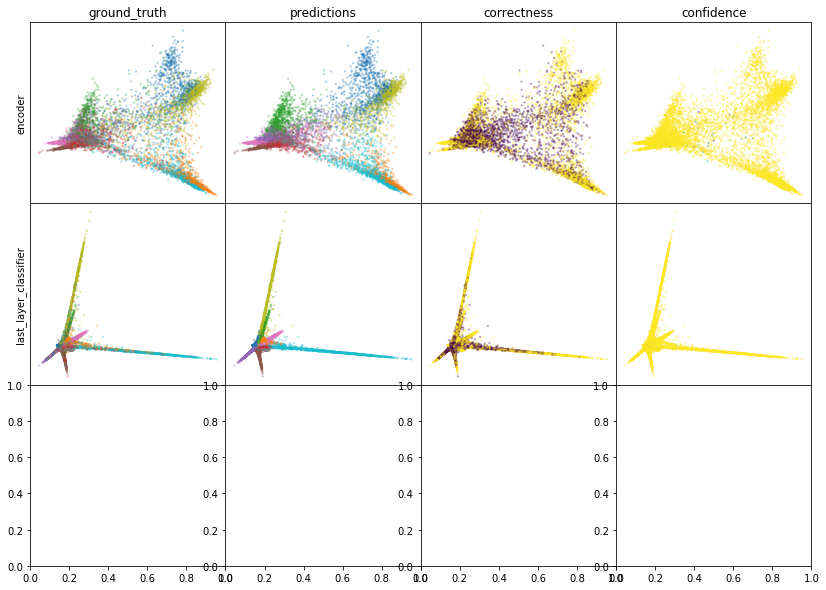

W0807 20:14:31.109559 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:14:32.237754 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:14:33.284679 140001524946752 legend.py:1282] No handles with labels found to put in legend.


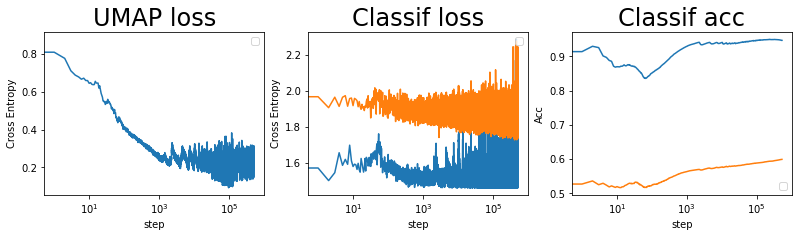

batch: 525000 | train acc: 0.9468 | val acc: 0.5994


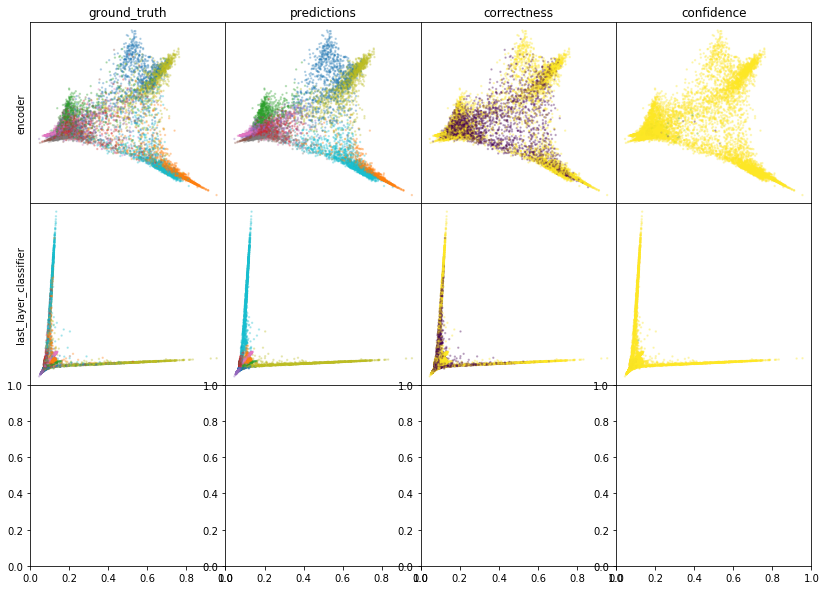

W0807 20:17:25.142972 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:17:26.256412 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:17:27.311084 140001524946752 legend.py:1282] No handles with labels found to put in legend.


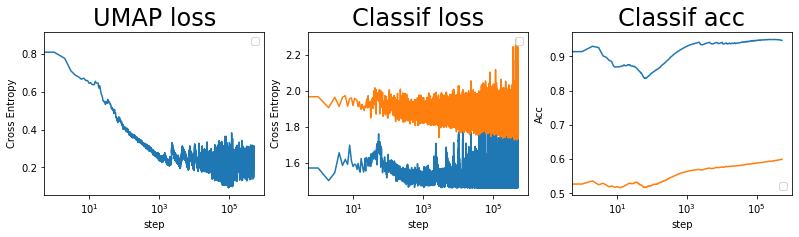

batch: 526000 | train acc: 0.9468 | val acc: 0.5994


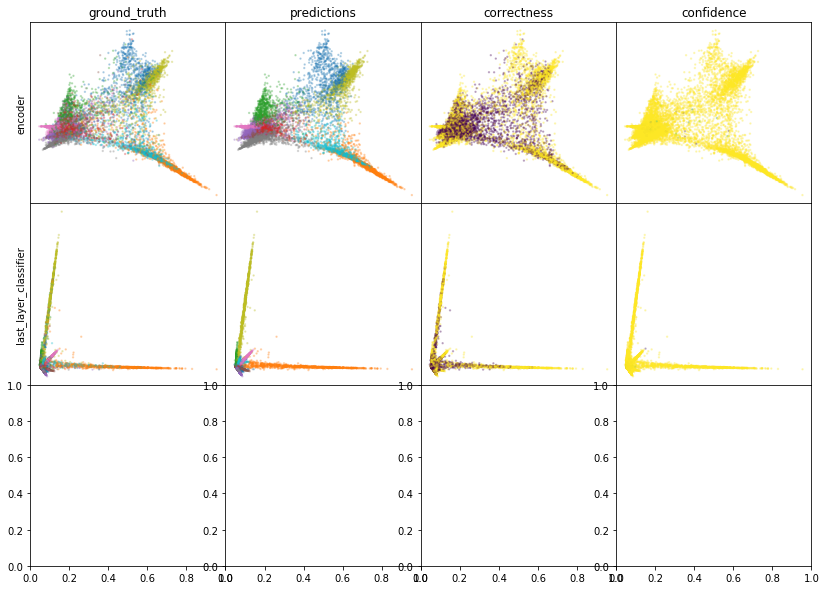

W0807 20:20:21.312195 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:20:22.453096 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:20:23.501083 140001524946752 legend.py:1282] No handles with labels found to put in legend.


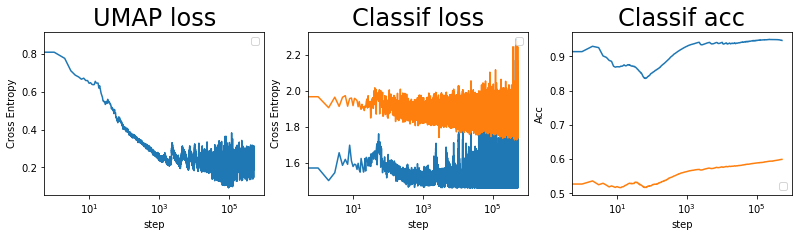

batch: 527000 | train acc: 0.9468 | val acc: 0.5994


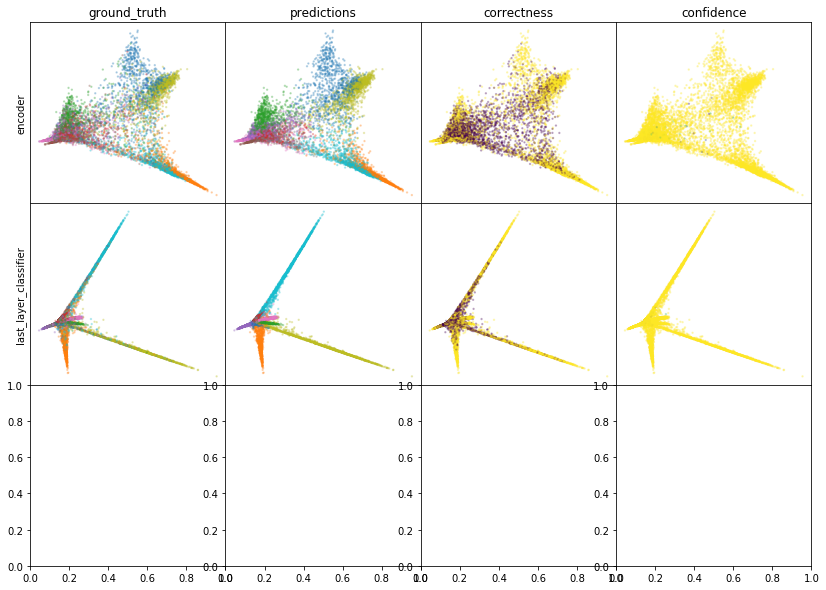

W0807 20:23:15.502127 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:23:16.613965 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:23:17.644579 140001524946752 legend.py:1282] No handles with labels found to put in legend.


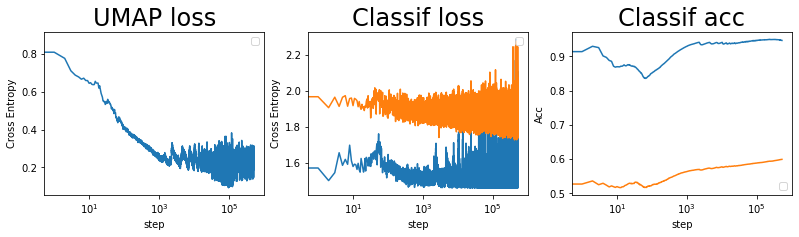

batch: 528000 | train acc: 0.9468 | val acc: 0.5994


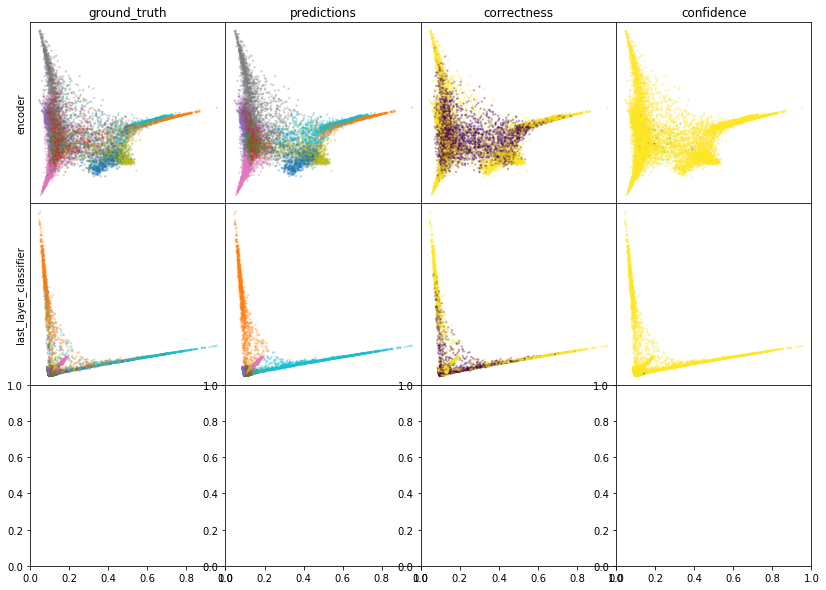

W0807 20:26:10.394693 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:26:11.533348 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:26:12.590389 140001524946752 legend.py:1282] No handles with labels found to put in legend.


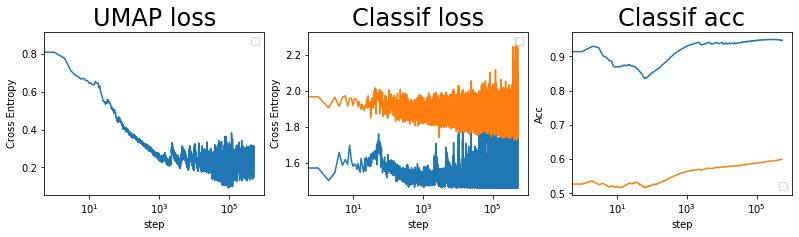

batch: 529000 | train acc: 0.9468 | val acc: 0.5995


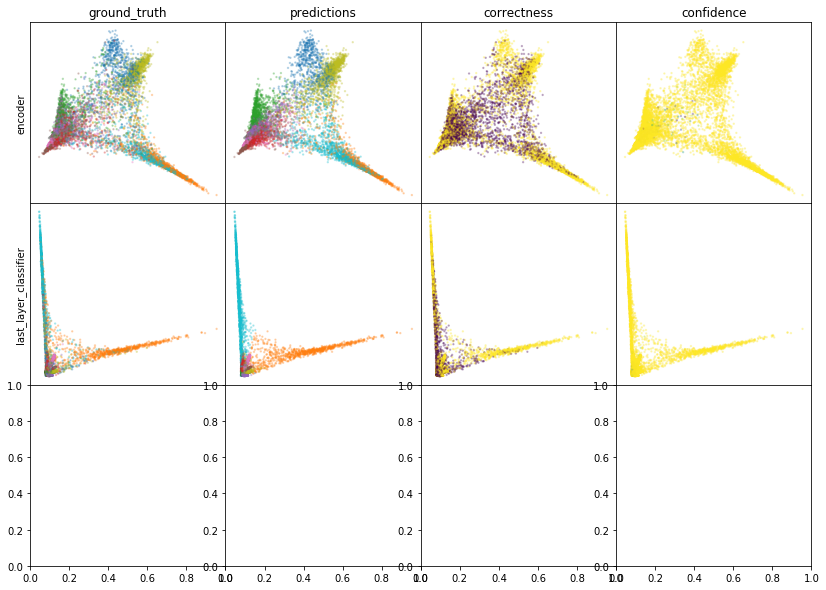

W0807 20:29:05.547877 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:29:06.692561 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:29:07.745067 140001524946752 legend.py:1282] No handles with labels found to put in legend.


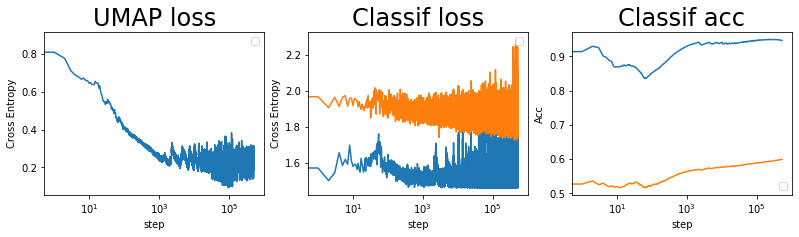

batch: 530000 | train acc: 0.9467 | val acc: 0.5995


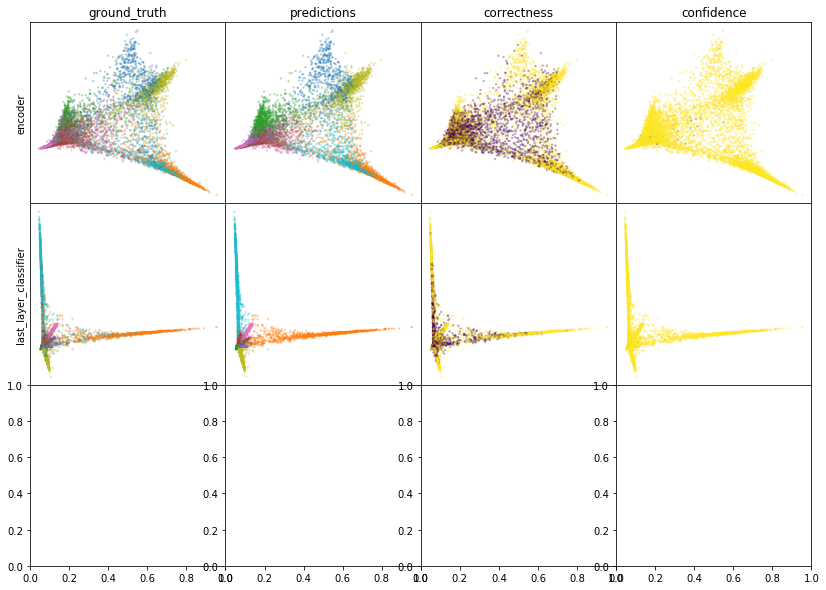

W0807 20:32:00.006983 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:32:01.156965 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:32:02.219749 140001524946752 legend.py:1282] No handles with labels found to put in legend.


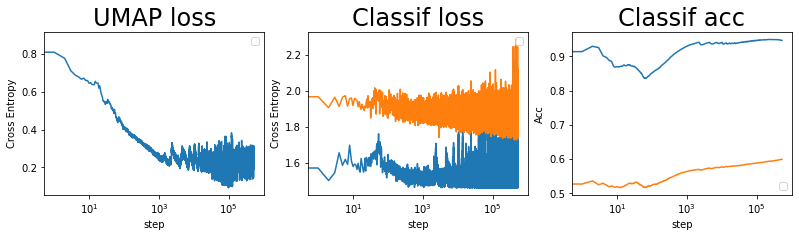

batch: 531000 | train acc: 0.9467 | val acc: 0.5995


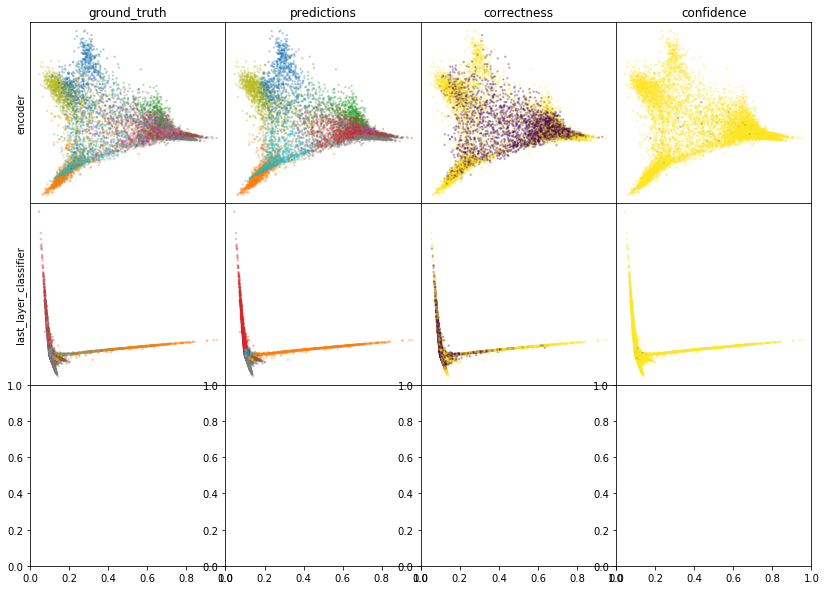

W0807 20:34:53.946648 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:34:55.115403 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:34:56.188177 140001524946752 legend.py:1282] No handles with labels found to put in legend.


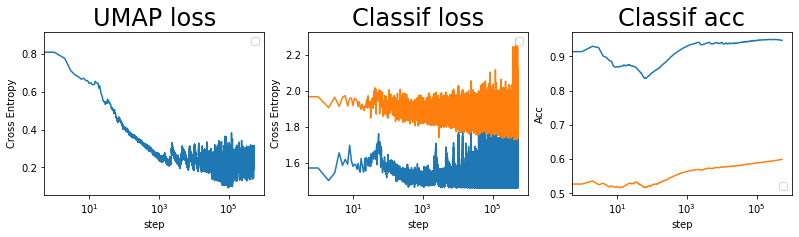

batch: 532000 | train acc: 0.9467 | val acc: 0.5995


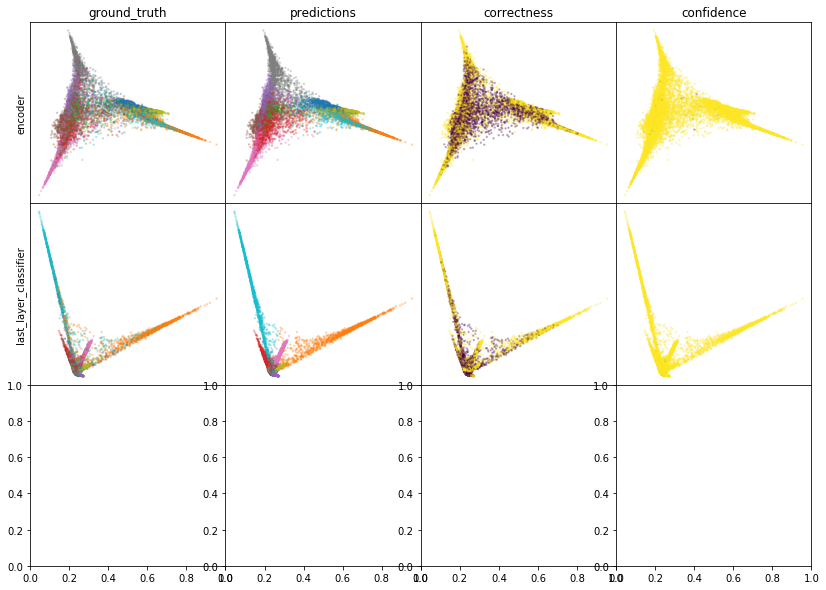

W0807 20:37:47.780634 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:37:48.916410 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:37:49.971369 140001524946752 legend.py:1282] No handles with labels found to put in legend.


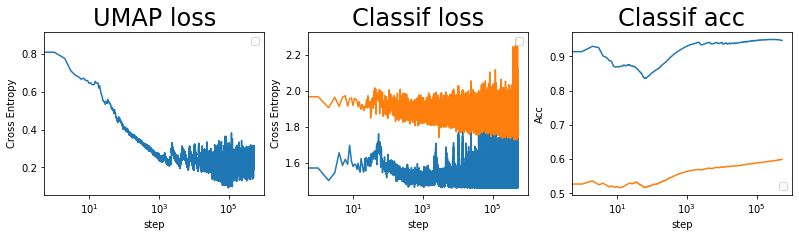

batch: 533000 | train acc: 0.9466 | val acc: 0.5995


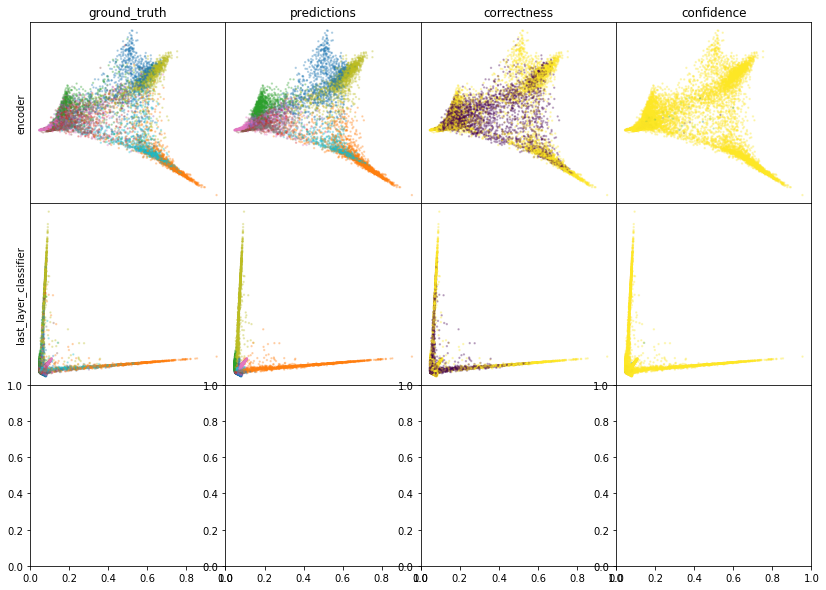

W0807 20:40:43.337993 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:40:44.480995 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:40:45.541887 140001524946752 legend.py:1282] No handles with labels found to put in legend.


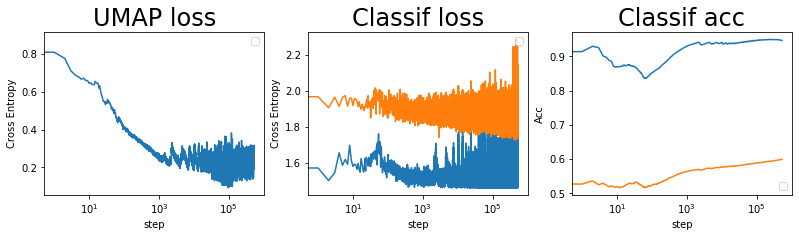

batch: 534000 | train acc: 0.9466 | val acc: 0.5995


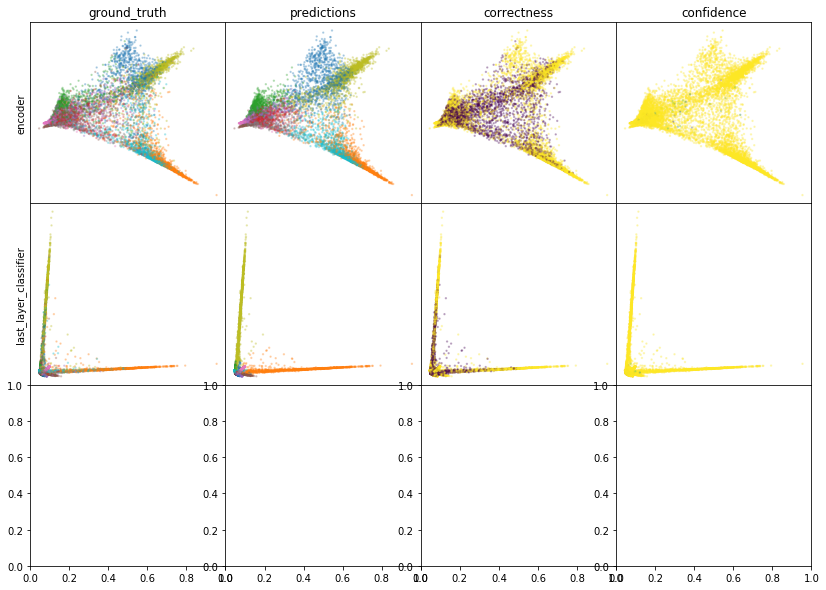

W0807 20:43:38.535263 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:43:39.687135 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:43:40.752227 140001524946752 legend.py:1282] No handles with labels found to put in legend.


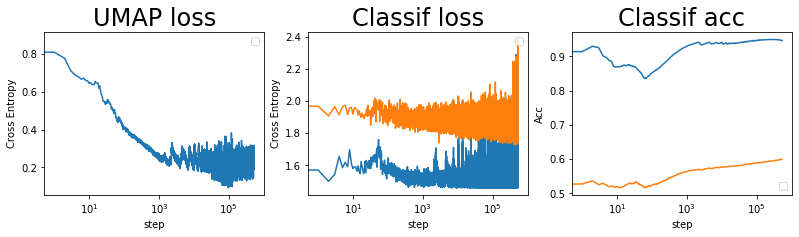

batch: 535000 | train acc: 0.9466 | val acc: 0.5995


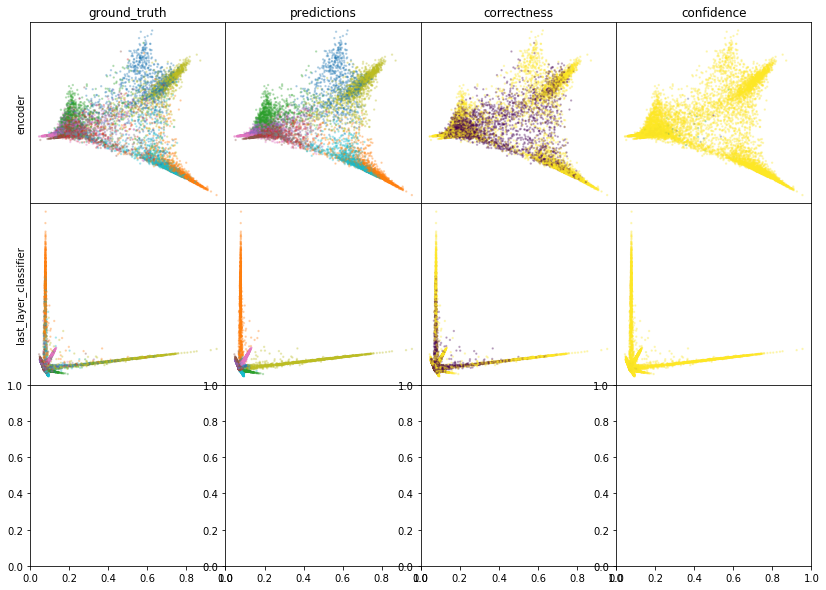

W0807 20:46:32.035098 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:46:33.168796 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:46:34.225669 140001524946752 legend.py:1282] No handles with labels found to put in legend.


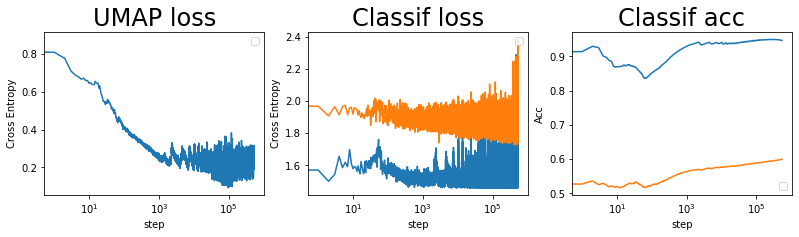

batch: 536000 | train acc: 0.9466 | val acc: 0.5995


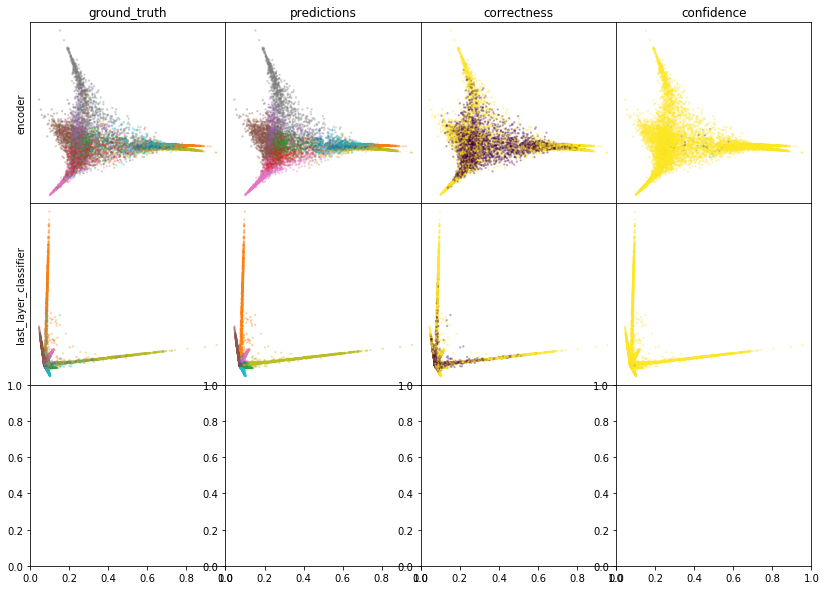

W0807 20:49:27.037536 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:49:28.192890 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:49:29.256612 140001524946752 legend.py:1282] No handles with labels found to put in legend.


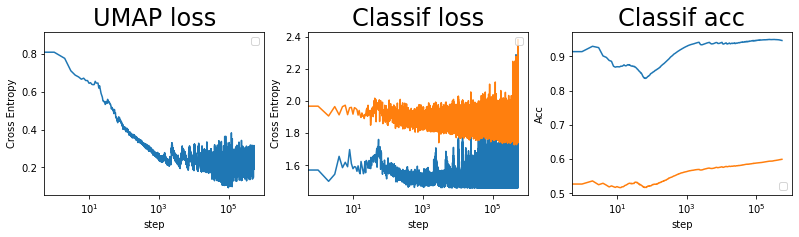

batch: 537000 | train acc: 0.9466 | val acc: 0.5996


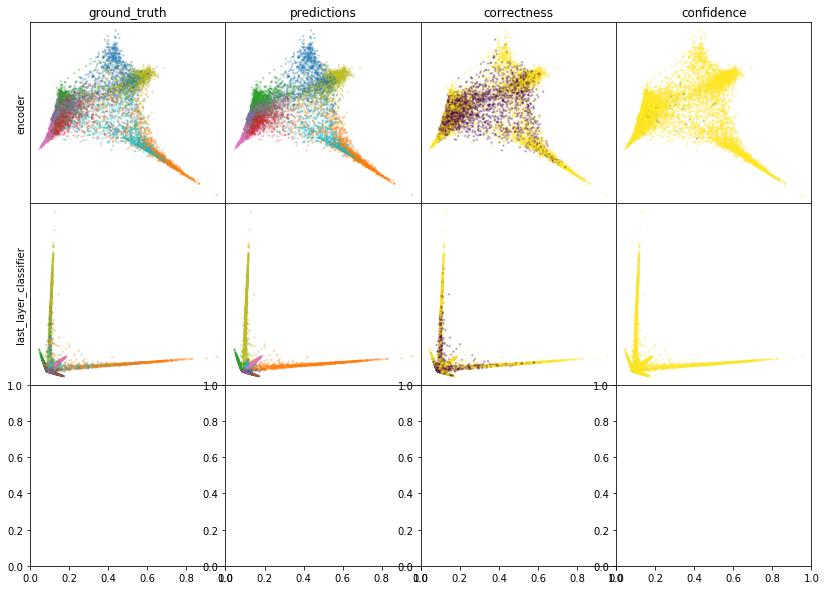

W0807 20:52:20.285593 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:52:21.450515 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:52:22.519010 140001524946752 legend.py:1282] No handles with labels found to put in legend.


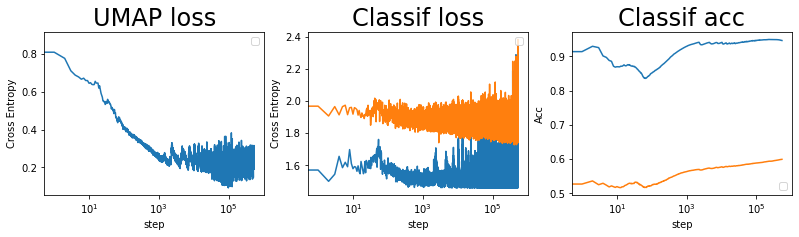

batch: 538000 | train acc: 0.9466 | val acc: 0.5996


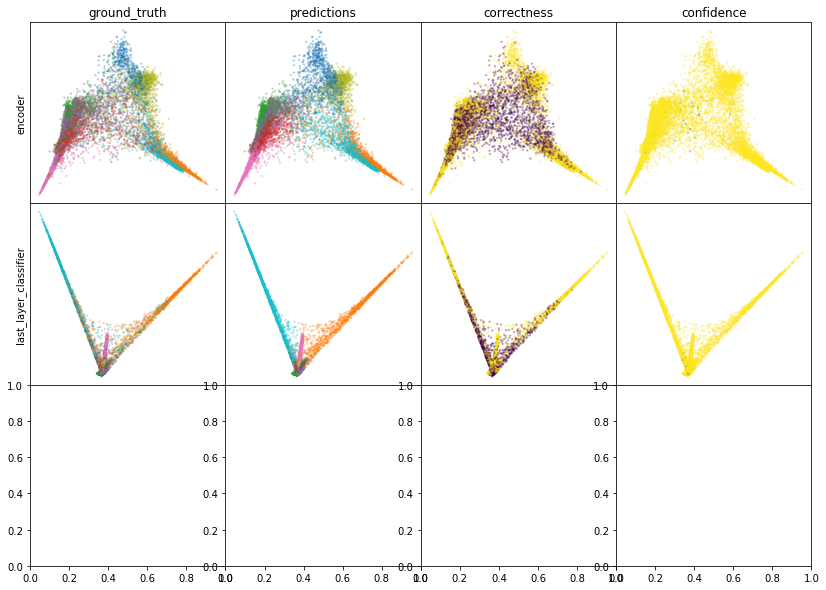

W0807 20:55:16.210679 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:55:17.352894 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:55:18.423288 140001524946752 legend.py:1282] No handles with labels found to put in legend.


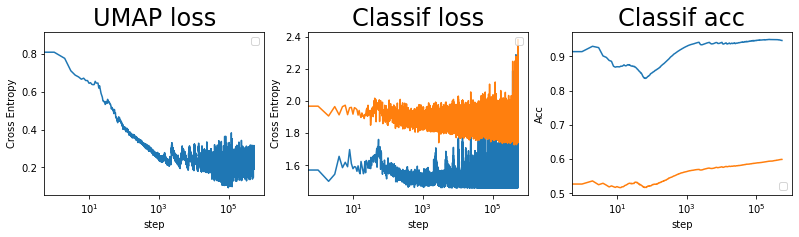

batch: 539000 | train acc: 0.9466 | val acc: 0.5996


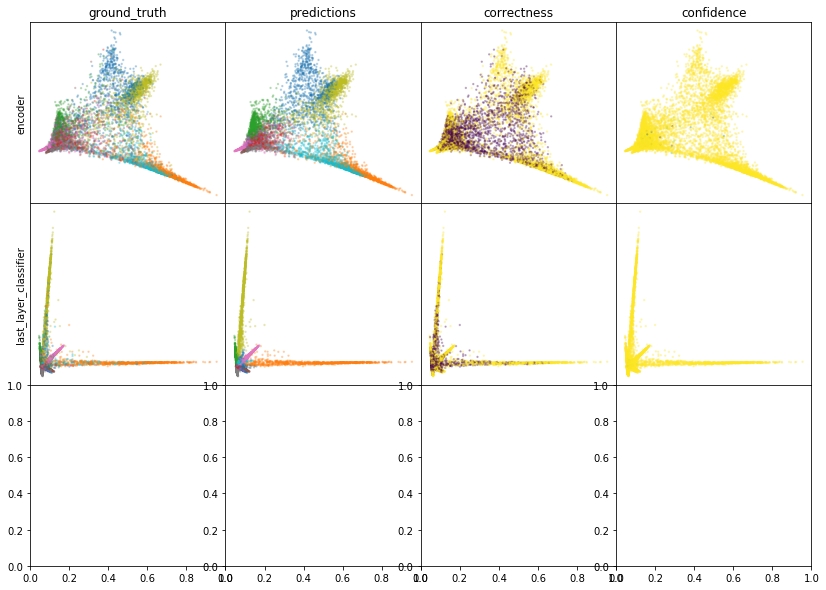

W0807 20:58:11.966063 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:58:13.105324 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 20:58:14.168761 140001524946752 legend.py:1282] No handles with labels found to put in legend.


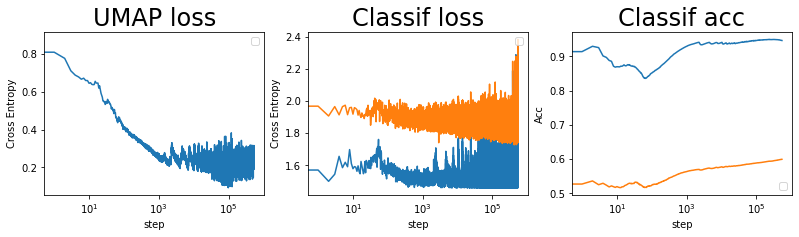

batch: 540000 | train acc: 0.9466 | val acc: 0.5996


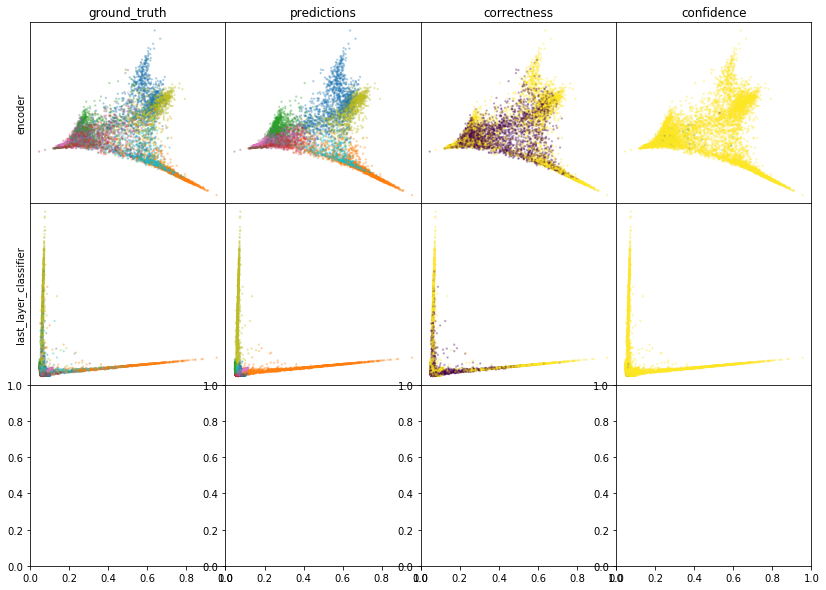

W0807 21:01:10.643883 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:01:11.783946 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:01:12.844305 140001524946752 legend.py:1282] No handles with labels found to put in legend.


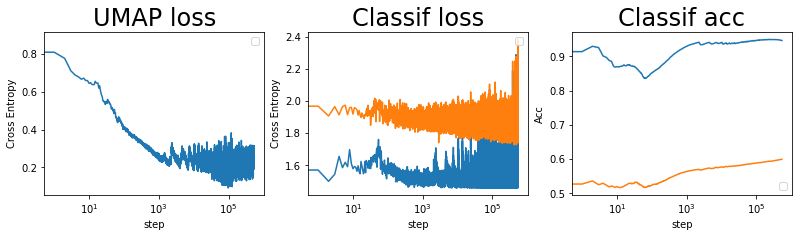

batch: 541000 | train acc: 0.9466 | val acc: 0.5996


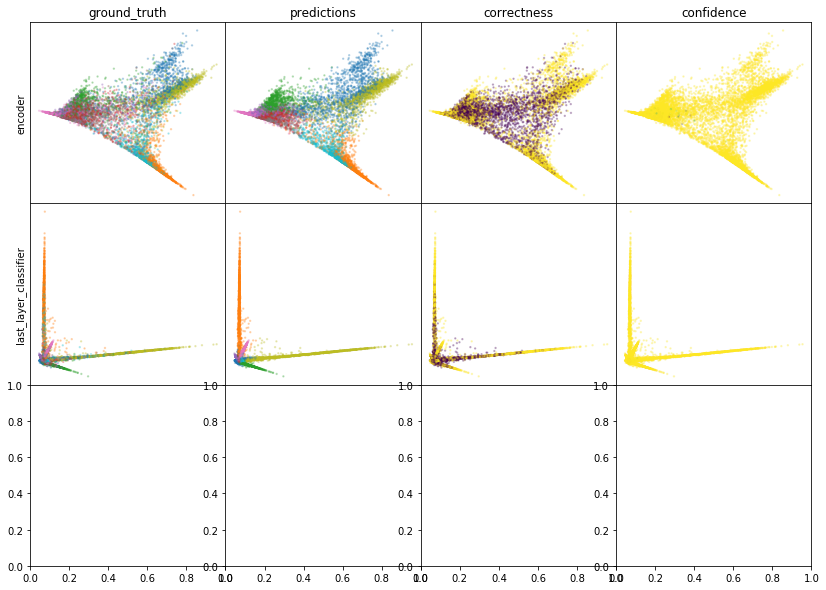

W0807 21:04:05.817595 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:04:06.961830 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:04:08.027546 140001524946752 legend.py:1282] No handles with labels found to put in legend.


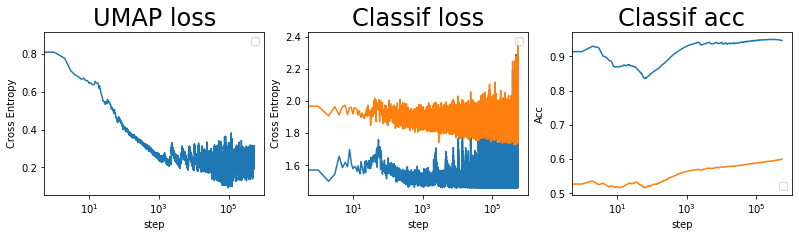

batch: 542000 | train acc: 0.9465 | val acc: 0.5997


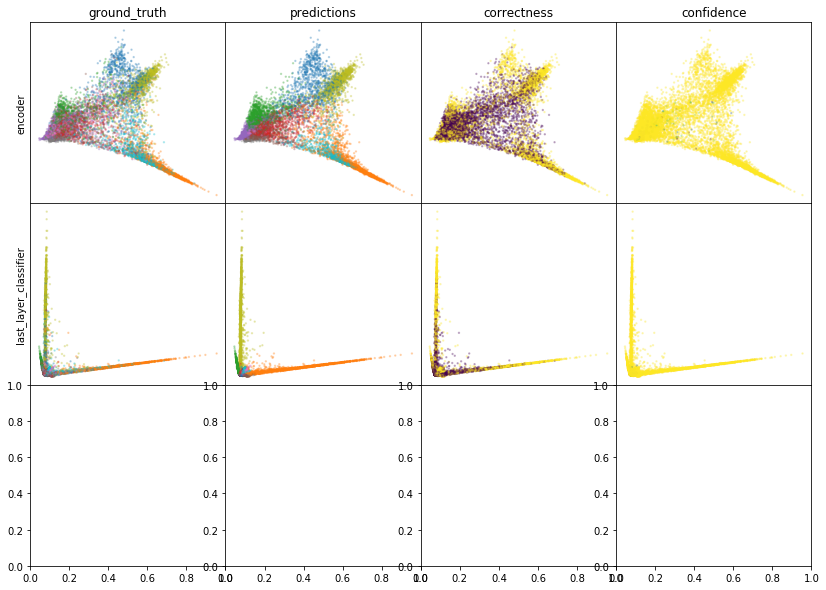

W0807 21:07:01.561591 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:07:02.716533 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:07:03.787040 140001524946752 legend.py:1282] No handles with labels found to put in legend.


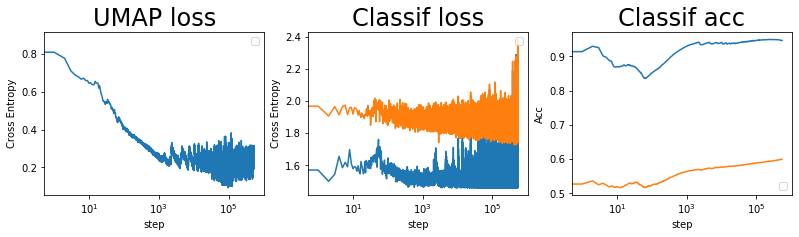

batch: 543000 | train acc: 0.9465 | val acc: 0.5997


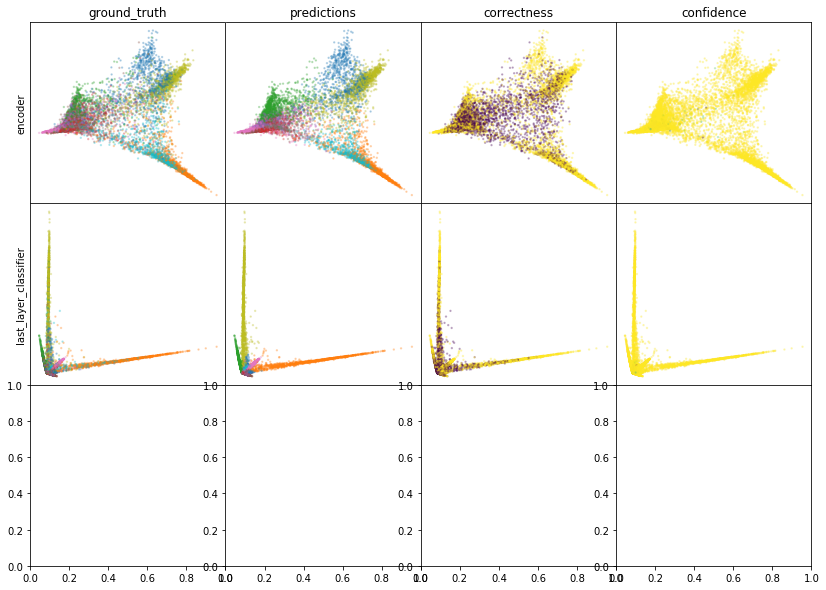

W0807 21:09:56.625031 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:09:57.774893 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:09:58.848918 140001524946752 legend.py:1282] No handles with labels found to put in legend.


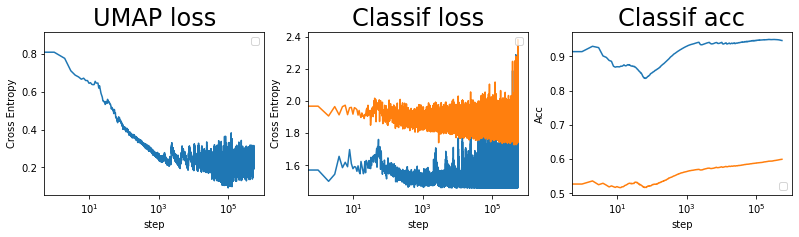

batch: 544000 | train acc: 0.9465 | val acc: 0.5997


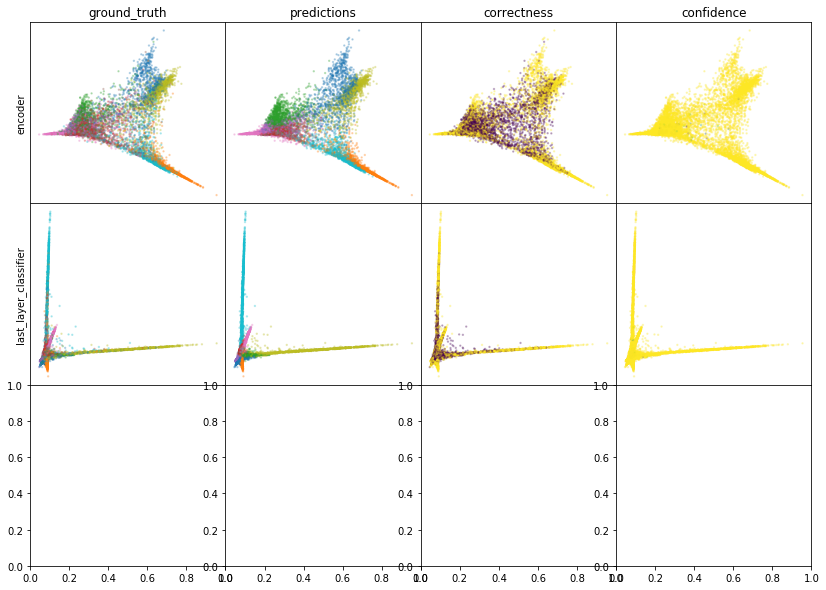

W0807 21:13:06.431041 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:13:07.602512 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:13:08.685788 140001524946752 legend.py:1282] No handles with labels found to put in legend.


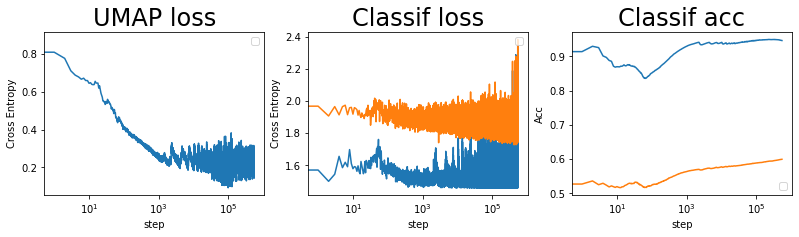

batch: 545000 | train acc: 0.9465 | val acc: 0.5997


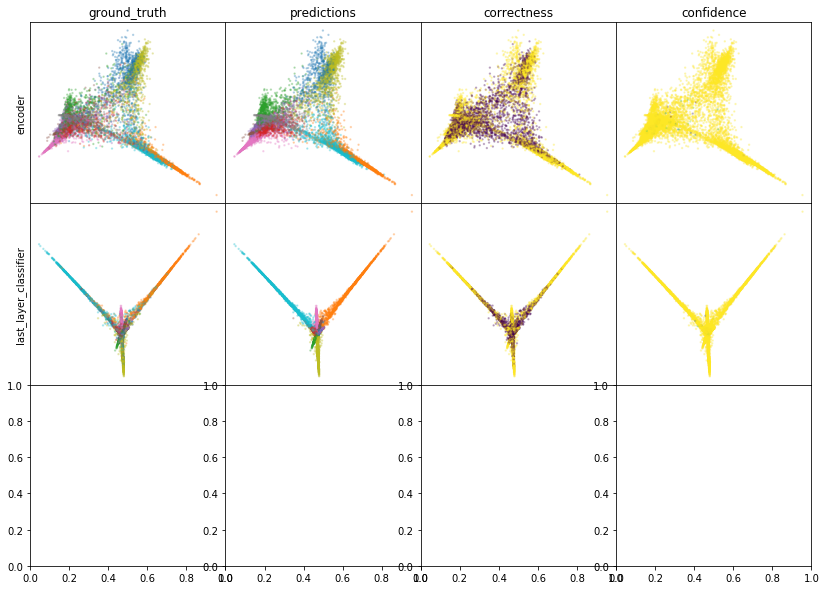

W0807 21:16:01.678180 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:16:02.846999 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:16:03.933284 140001524946752 legend.py:1282] No handles with labels found to put in legend.


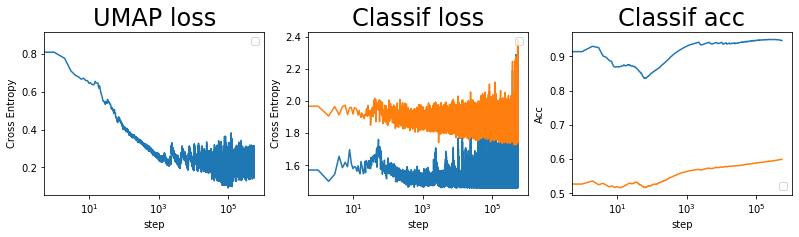

batch: 546000 | train acc: 0.9465 | val acc: 0.5997


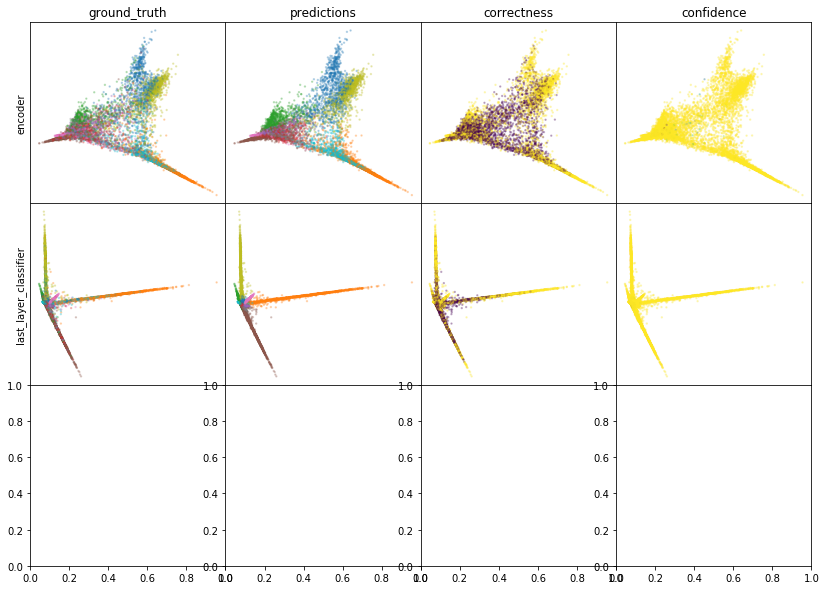

W0807 21:18:58.187132 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:18:59.338603 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:19:00.415961 140001524946752 legend.py:1282] No handles with labels found to put in legend.


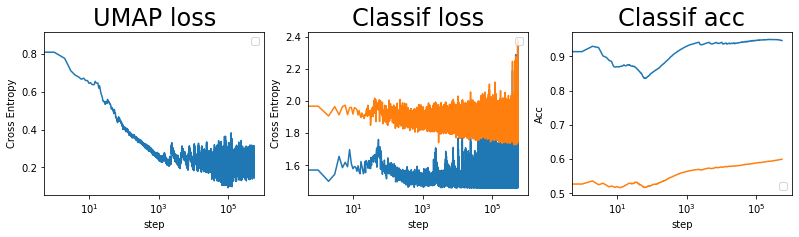

batch: 547000 | train acc: 0.9465 | val acc: 0.5997


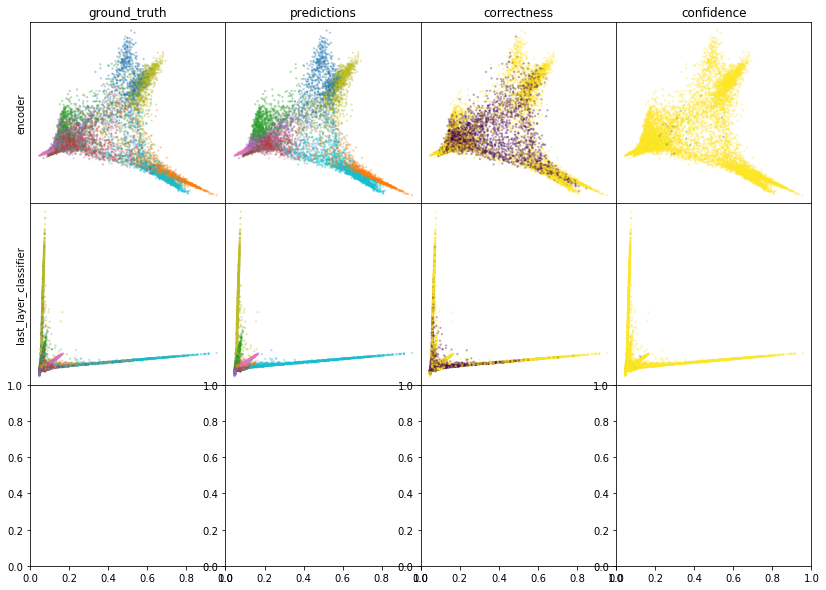

W0807 21:21:53.922329 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:21:55.104438 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:21:56.185691 140001524946752 legend.py:1282] No handles with labels found to put in legend.


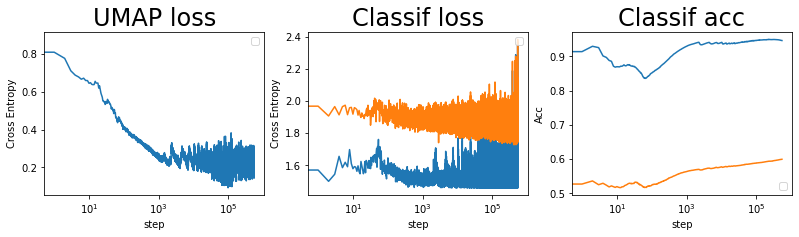

batch: 548000 | train acc: 0.9465 | val acc: 0.5997


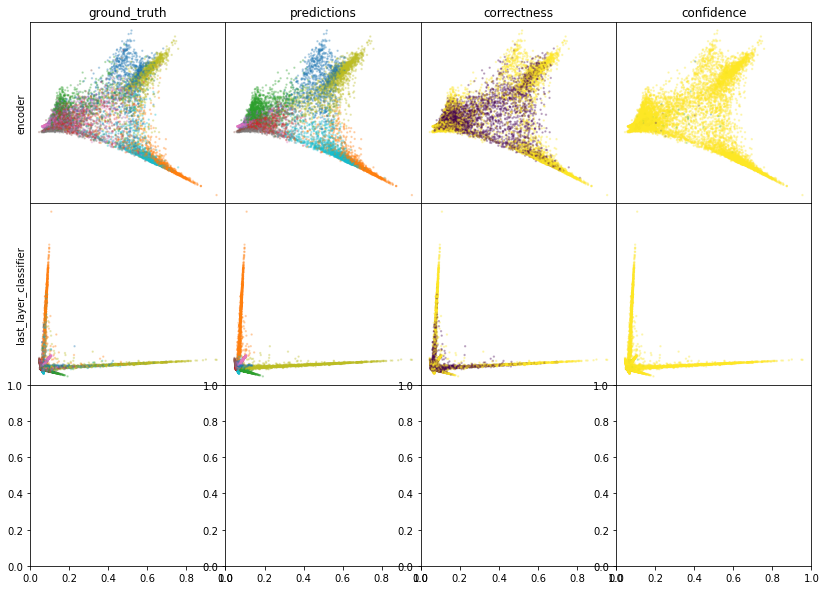

W0807 21:24:50.199037 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:24:51.375979 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:24:52.473031 140001524946752 legend.py:1282] No handles with labels found to put in legend.


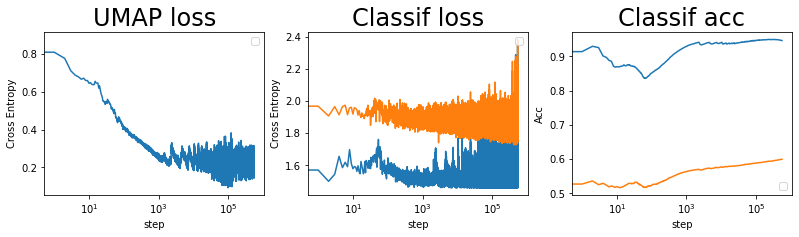

batch: 549000 | train acc: 0.9464 | val acc: 0.5997


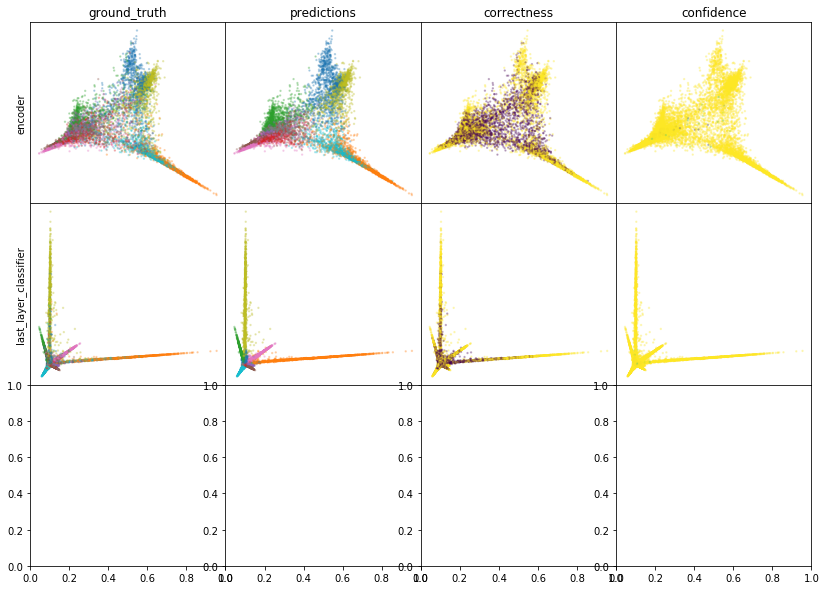

W0807 21:27:46.414698 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:27:47.589282 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:27:48.667350 140001524946752 legend.py:1282] No handles with labels found to put in legend.


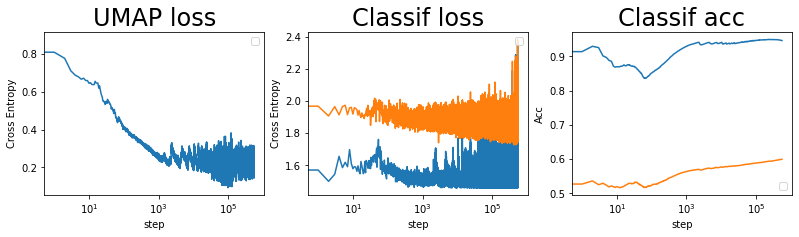

batch: 550000 | train acc: 0.9464 | val acc: 0.5998


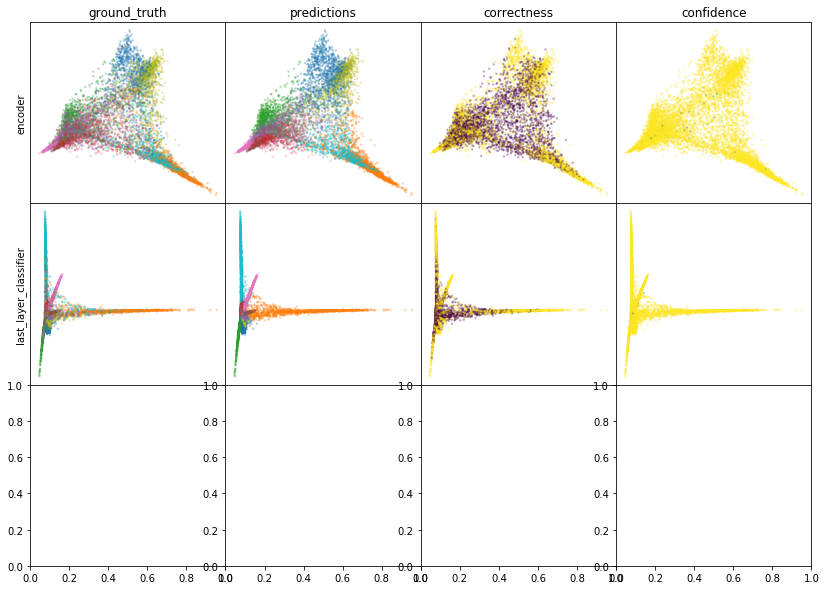

W0807 21:30:42.922327 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:30:44.095407 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:30:45.188015 140001524946752 legend.py:1282] No handles with labels found to put in legend.


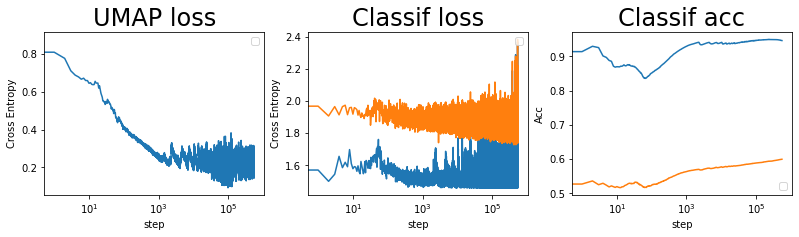

batch: 551000 | train acc: 0.9464 | val acc: 0.5998


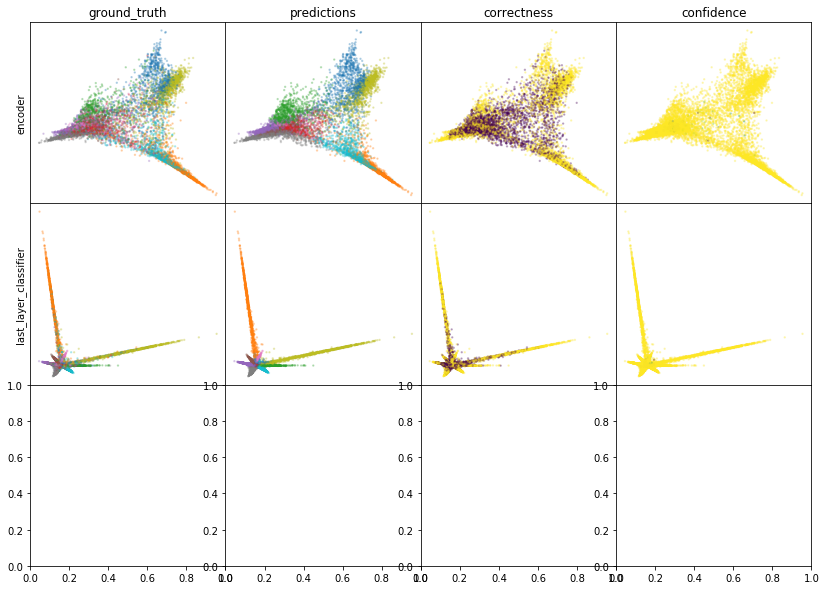

W0807 21:33:39.779742 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:33:40.968601 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:33:42.073273 140001524946752 legend.py:1282] No handles with labels found to put in legend.


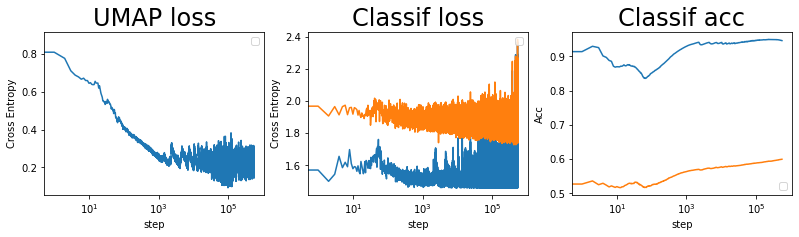

batch: 552000 | train acc: 0.9464 | val acc: 0.5998


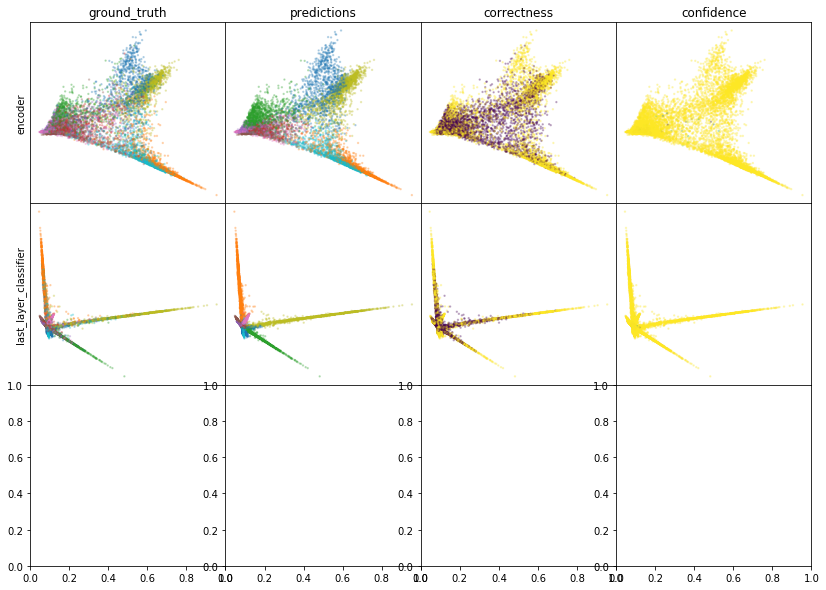

W0807 21:36:38.233046 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:36:39.413748 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:36:40.532081 140001524946752 legend.py:1282] No handles with labels found to put in legend.


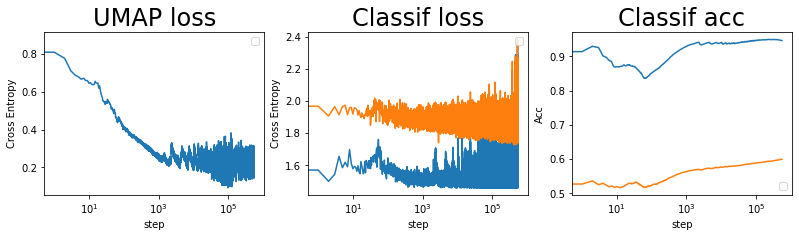

batch: 553000 | train acc: 0.9464 | val acc: 0.5998


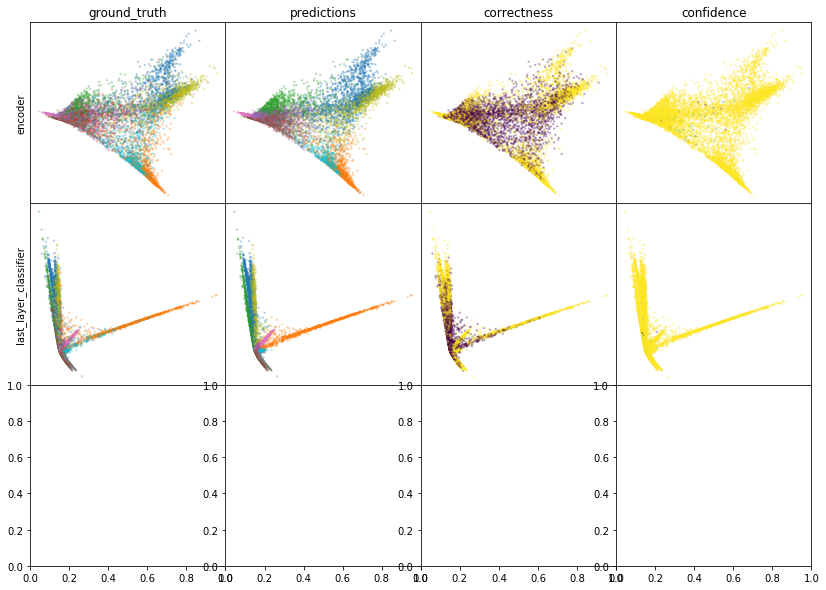

W0807 21:39:35.336948 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:39:36.532256 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:39:37.649125 140001524946752 legend.py:1282] No handles with labels found to put in legend.


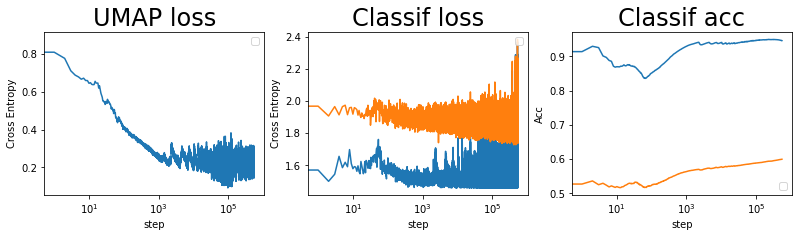

batch: 554000 | train acc: 0.9463 | val acc: 0.5998


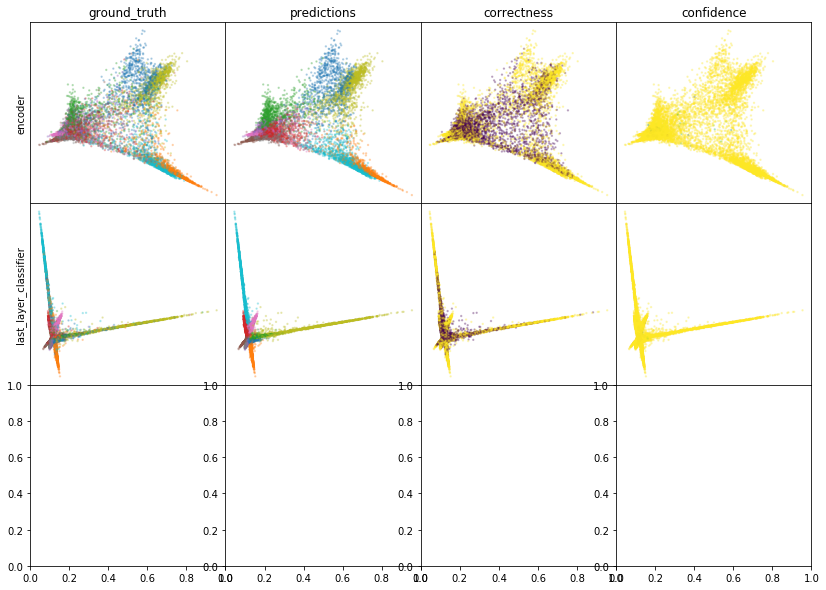

W0807 21:42:32.498114 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:42:33.686104 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:42:34.796894 140001524946752 legend.py:1282] No handles with labels found to put in legend.


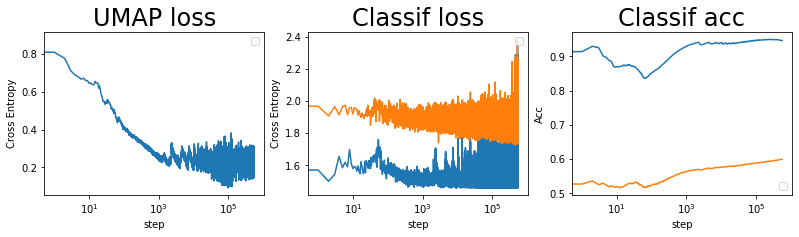

batch: 555000 | train acc: 0.9463 | val acc: 0.5998


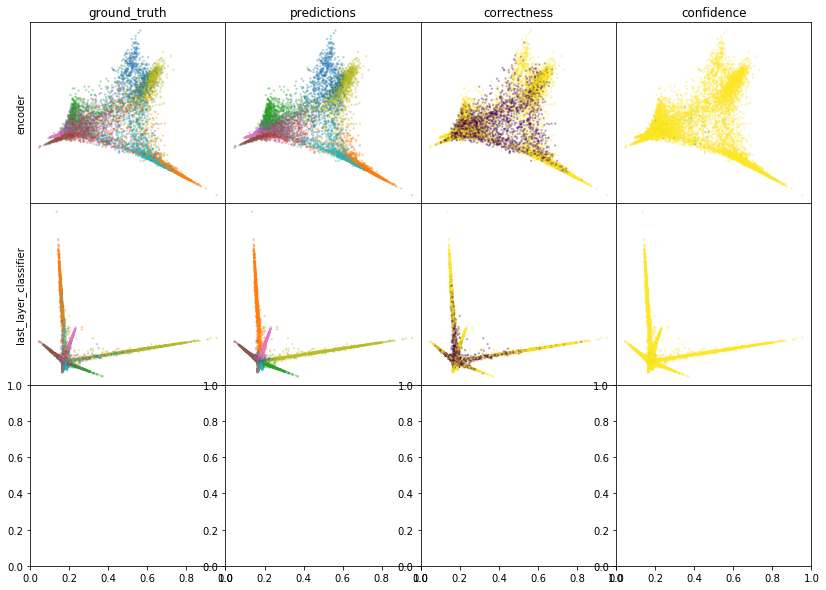

W0807 21:45:30.120446 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:45:31.313095 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:45:32.428308 140001524946752 legend.py:1282] No handles with labels found to put in legend.


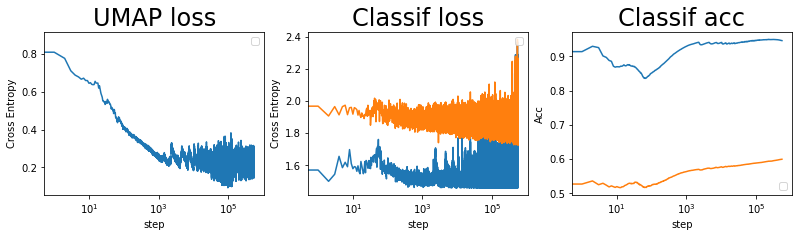

batch: 556000 | train acc: 0.9463 | val acc: 0.5998


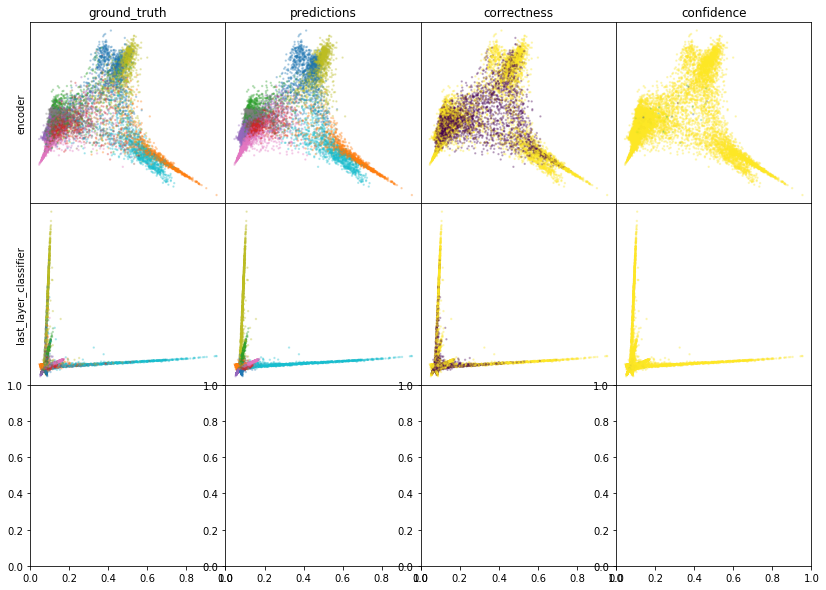

W0807 21:48:29.841030 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:48:31.029393 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:48:32.124926 140001524946752 legend.py:1282] No handles with labels found to put in legend.


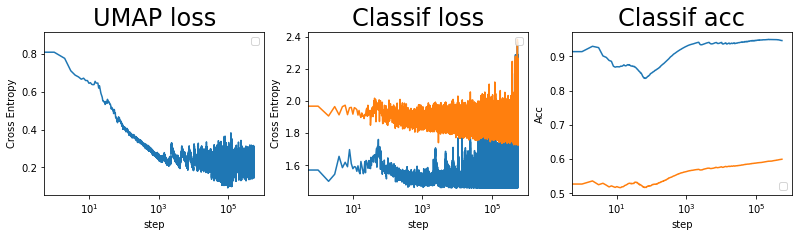

batch: 557000 | train acc: 0.9463 | val acc: 0.5998
leaving epoch because no improvement in 10000 batches


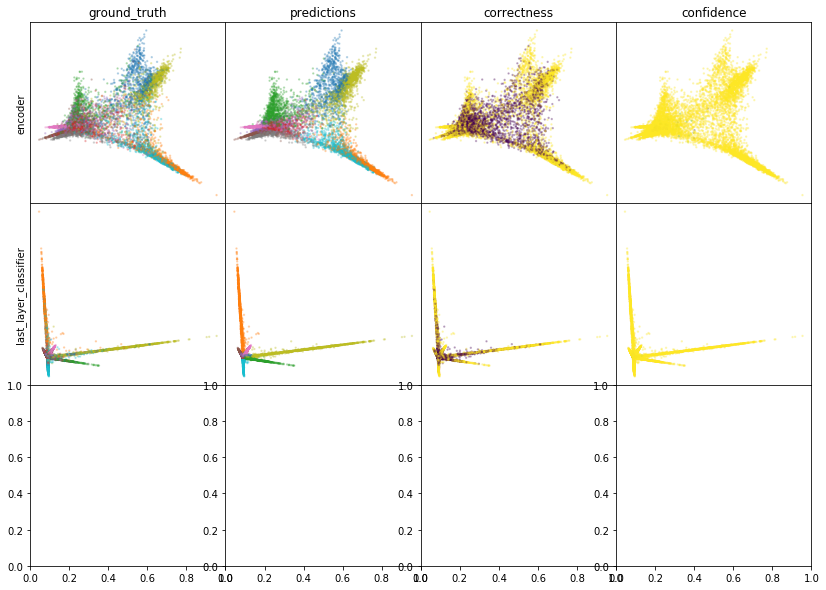

W0807 21:51:41.647101 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:51:42.840016 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:51:43.951203 140001524946752 legend.py:1282] No handles with labels found to put in legend.


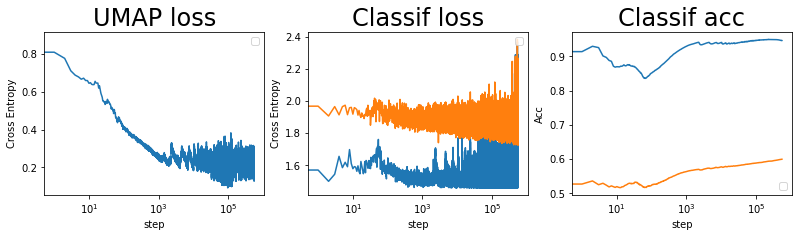

batch: 558000 | train acc: 0.9463 | val acc: 0.5998


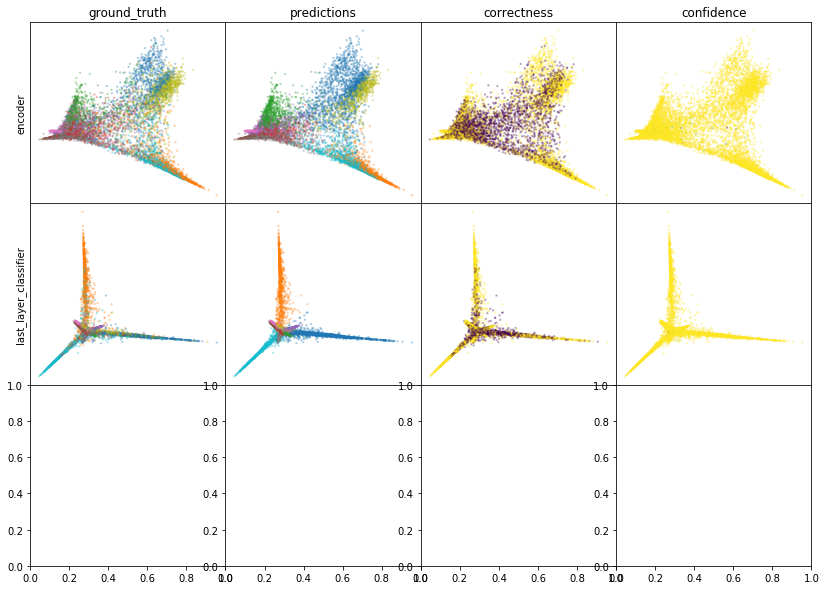

W0807 21:54:38.914317 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:54:40.107673 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:54:41.201504 140001524946752 legend.py:1282] No handles with labels found to put in legend.


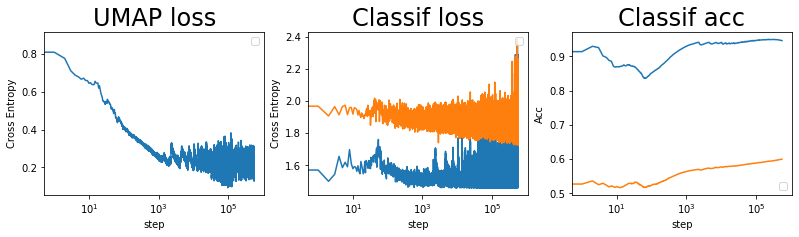

batch: 559000 | train acc: 0.9462 | val acc: 0.5998


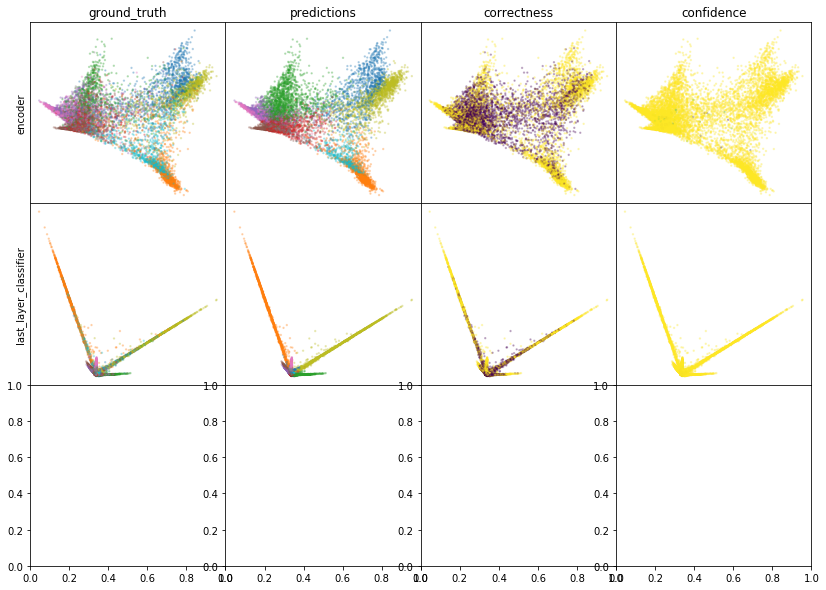

W0807 21:57:34.599401 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:57:35.783470 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 21:57:36.894378 140001524946752 legend.py:1282] No handles with labels found to put in legend.


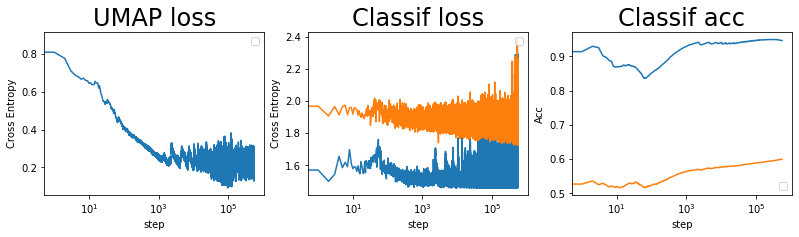

batch: 560000 | train acc: 0.9462 | val acc: 0.5999


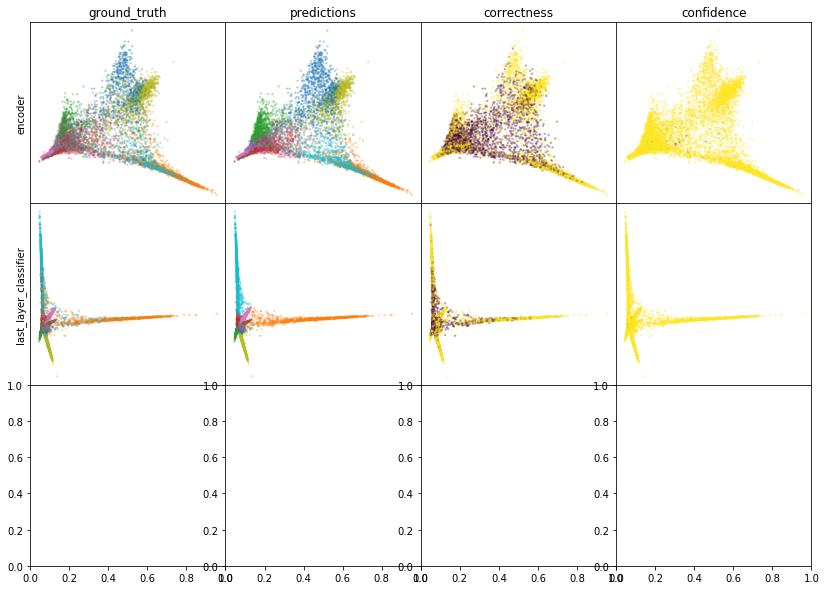

W0807 22:00:33.124671 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:00:34.342568 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:00:35.450929 140001524946752 legend.py:1282] No handles with labels found to put in legend.


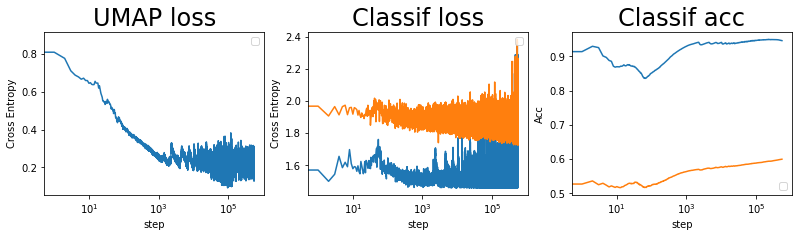

batch: 561000 | train acc: 0.9462 | val acc: 0.5999


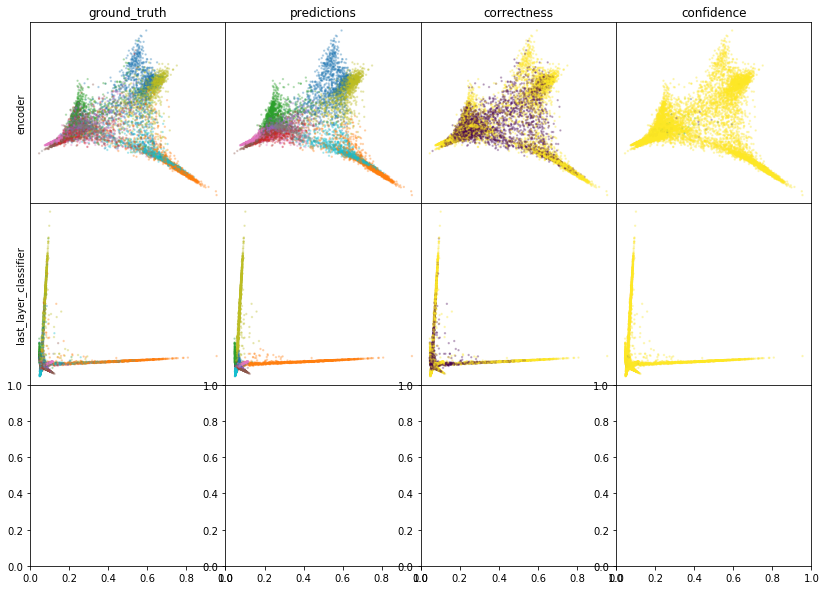

W0807 22:03:31.607558 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:03:32.795341 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:03:33.901621 140001524946752 legend.py:1282] No handles with labels found to put in legend.


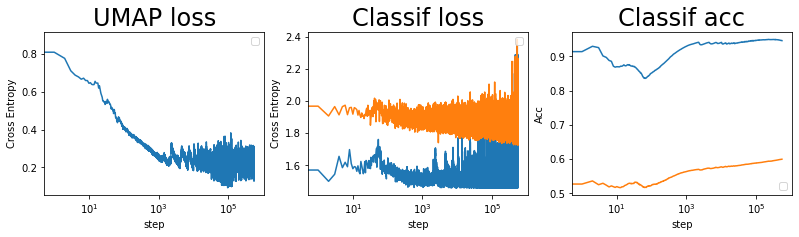

batch: 562000 | train acc: 0.9462 | val acc: 0.5999


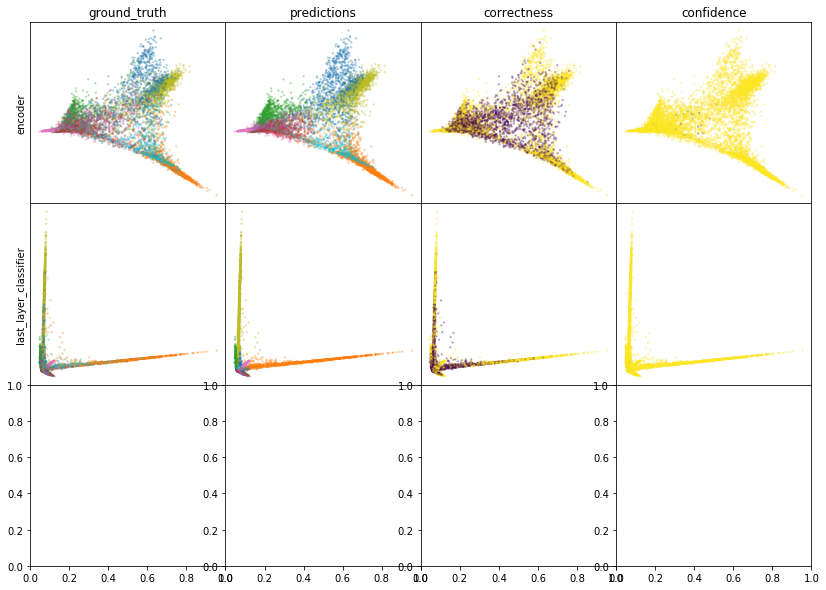

W0807 22:06:29.939305 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:06:31.128867 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:06:32.235374 140001524946752 legend.py:1282] No handles with labels found to put in legend.


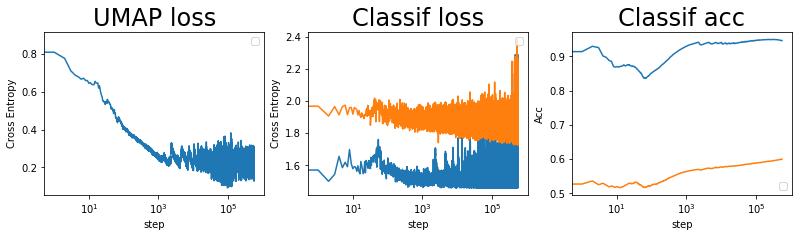

batch: 563000 | train acc: 0.9462 | val acc: 0.5999


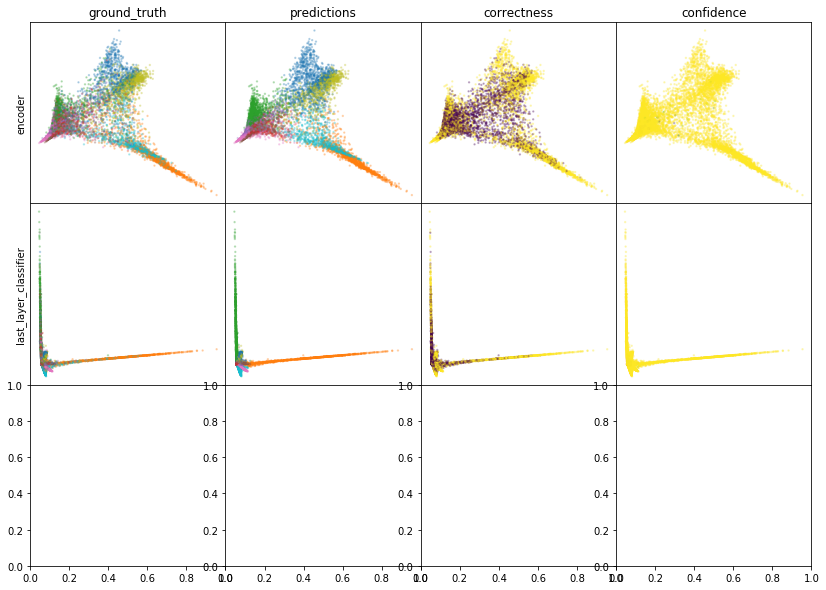

W0807 22:09:28.689803 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:09:29.889688 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:09:30.994784 140001524946752 legend.py:1282] No handles with labels found to put in legend.


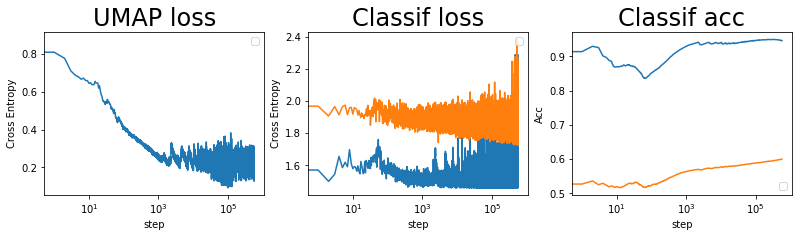

batch: 564000 | train acc: 0.9462 | val acc: 0.5999


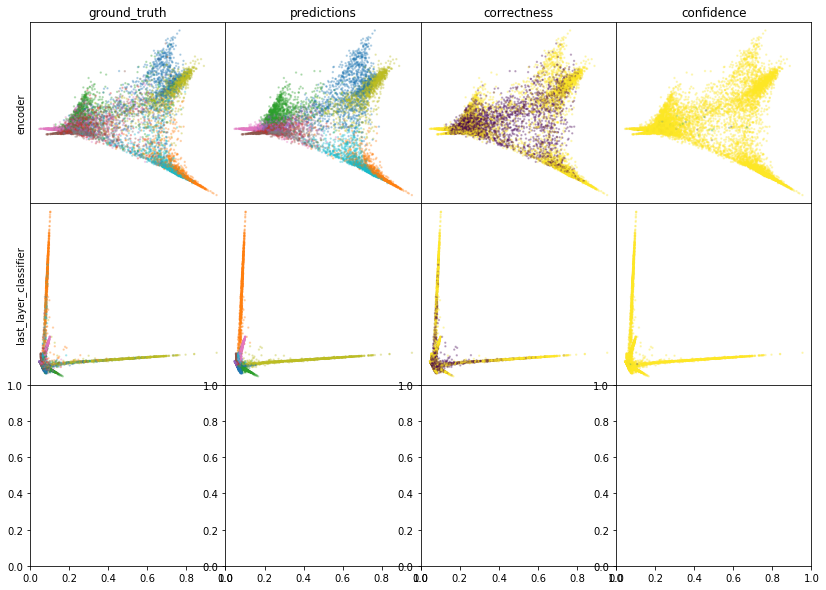

W0807 22:12:27.847182 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:12:29.050175 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:12:30.160070 140001524946752 legend.py:1282] No handles with labels found to put in legend.


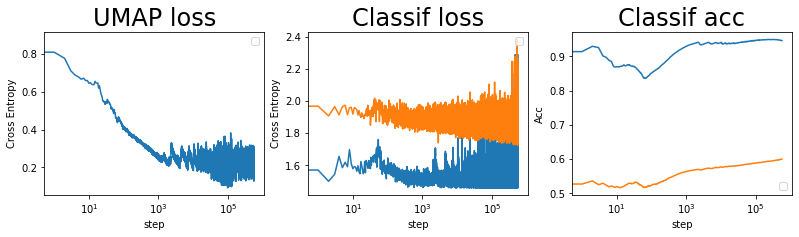

batch: 565000 | train acc: 0.9462 | val acc: 0.5999


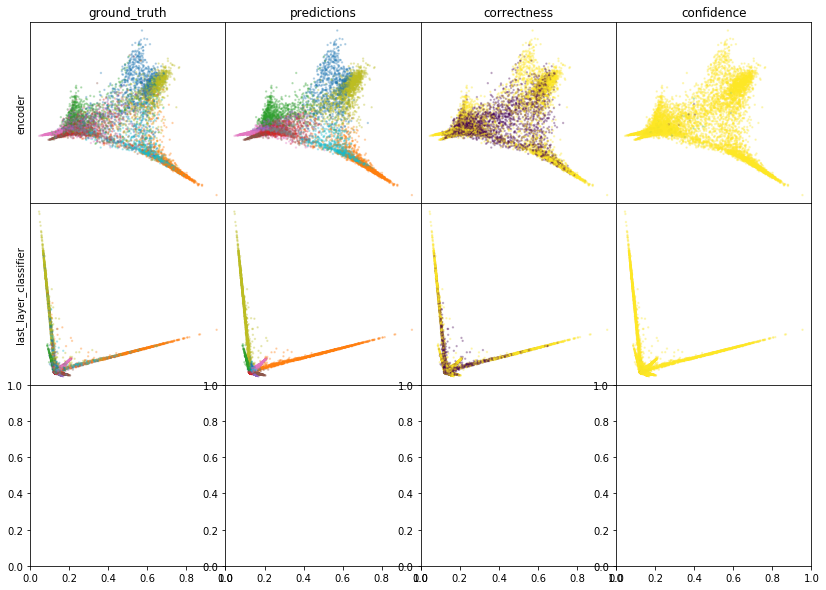

W0807 22:15:29.974670 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:15:31.173838 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:15:32.293960 140001524946752 legend.py:1282] No handles with labels found to put in legend.


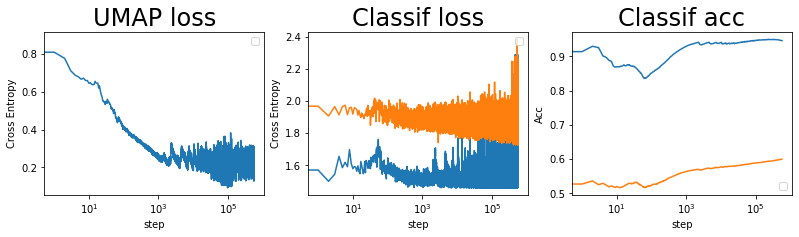

batch: 566000 | train acc: 0.9462 | val acc: 0.6


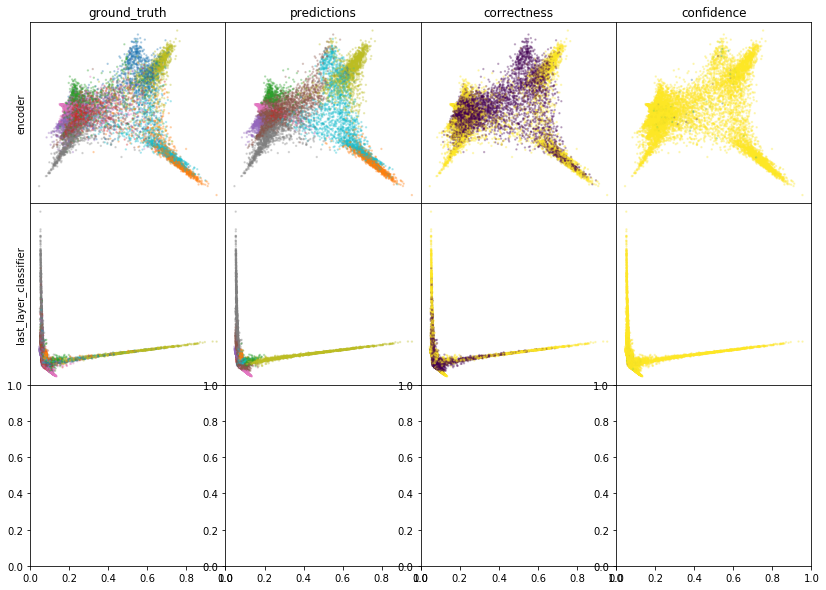

W0807 22:18:29.893972 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:18:31.099949 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:18:32.223694 140001524946752 legend.py:1282] No handles with labels found to put in legend.


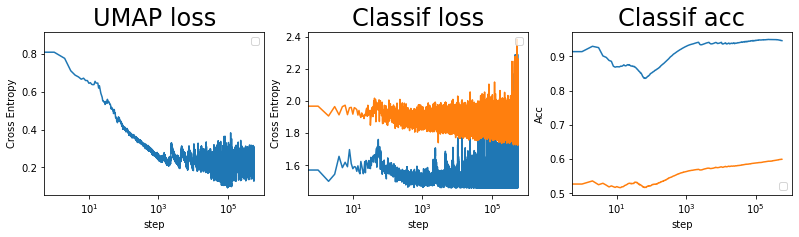

batch: 567000 | train acc: 0.9461 | val acc: 0.5999


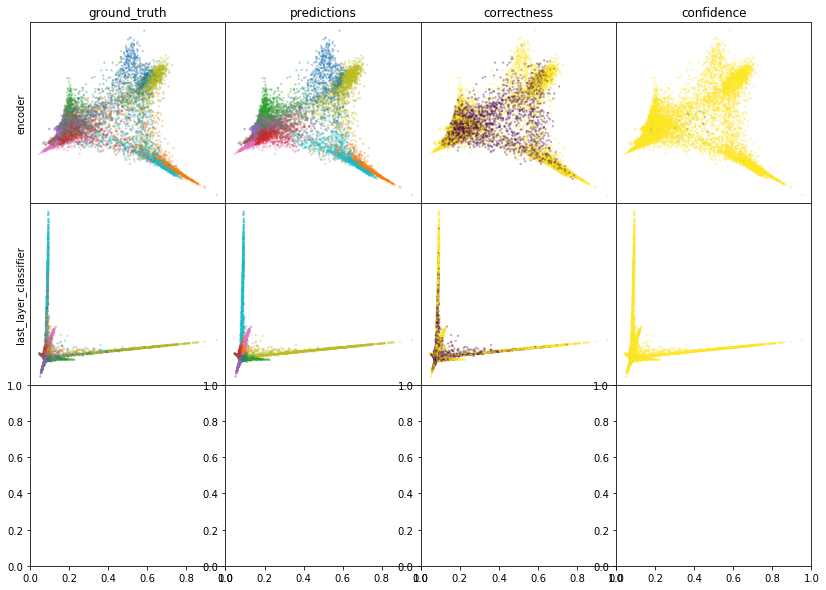

W0807 22:21:29.808830 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:21:31.008934 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:21:32.127182 140001524946752 legend.py:1282] No handles with labels found to put in legend.


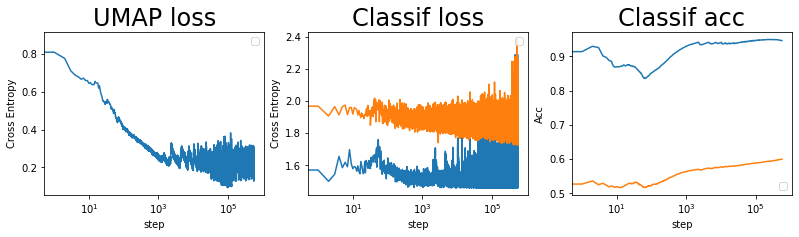

batch: 568000 | train acc: 0.9461 | val acc: 0.6


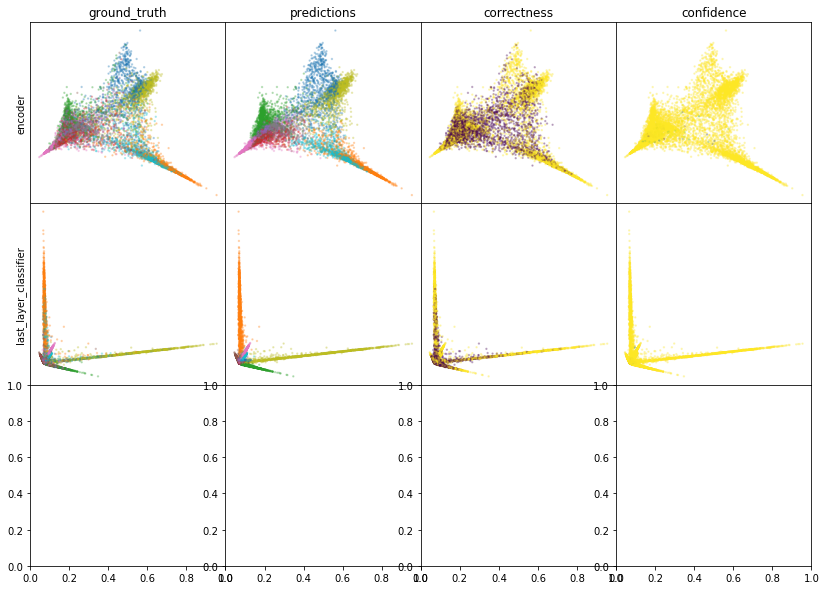

W0807 22:24:28.494170 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:24:29.710363 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:24:30.842168 140001524946752 legend.py:1282] No handles with labels found to put in legend.


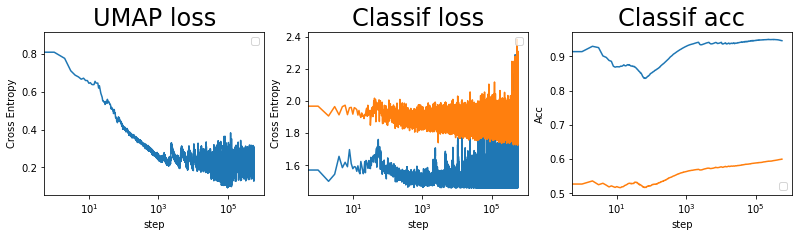

batch: 569000 | train acc: 0.9461 | val acc: 0.6
saving weights | batch = 569340 | acc = 59.998


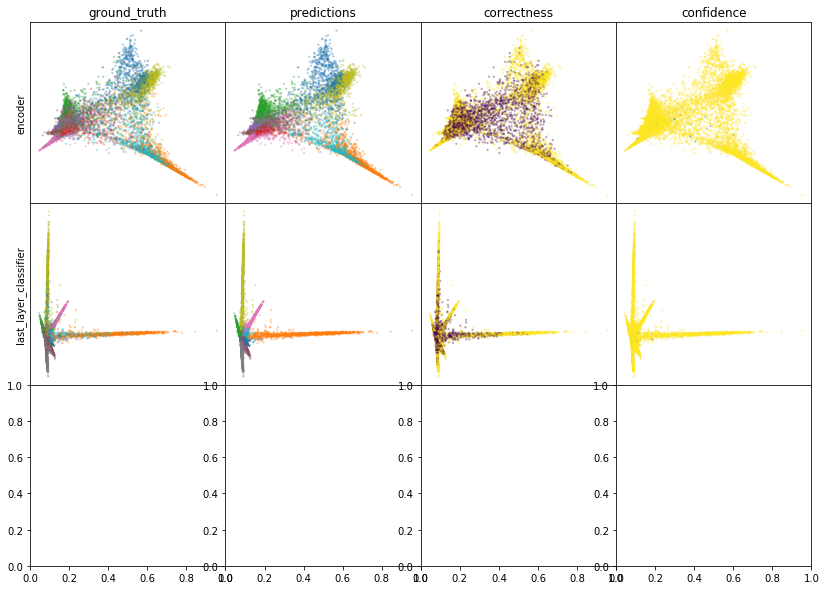

W0807 22:27:29.029702 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:27:30.240937 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 22:27:31.377700 140001524946752 legend.py:1282] No handles with labels found to put in legend.


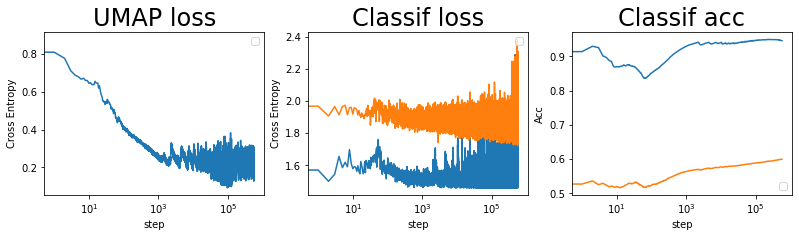

batch: 570000 | train acc: 0.9461 | val acc: 0.6


KeyboardInterrupt: 

In [79]:
improved_this_epoch = True
for epoch in tqdm(zip(np.arange(N_EPOCHS)), total=N_EPOCHS, desc="epoch"):

    if not improved_this_epoch:
        epochs_without_improvement += 1

    if epochs_without_improvement > max_epochs_without_improvement:
        print(
            "Early stopping because no improvement in {} epochs".format(
                max_epochs_without_improvement
            )
        )
        break

    # reset improvement information
    improved_this_epoch = False
    last_improvement = (
        0  # delta between current batch, and the last batch that was an improvement
    )
    n_reloads = 0
    batches_since_last_reload = 0

    ####  build graph
    # embed data
    train_enc = model_data(X_train, 100, model.encoder)
    train_last_layer = model_data(train_enc, 100, pred_model)

    # construct graph
    umap_graph = build_fuzzy_simplicial_set(
        train_last_layer, y=Y_masked, n_neighbors=n_neighbors,
    )
    # get graph elements
    graph, epochs_per_sample, head, tail, weight, n_vertices = get_graph_elements(
        umap_graph, n_epochs=200
    )

    # create edge iterator
    edge_epoch, n_edges_per_epoch = create_edge_iterator(
        head,
        tail,
        weight,
        batch_size=batch_size,
        max_sample_repeats_per_epoch=max_sample_repeats_per_epoch,
    )

    BATCHES_PER_EPOCH = int(n_edges_per_epoch / batch_size)
    
    samples_left = 0

    pbar = tqdm(total=BATCHES_PER_EPOCH, leave=False, desc="loss")

    for (batch_to, batch_from), (X, y), (X_val, y_val) in zip(next(edge_epoch), labeled_iter, data_valid):
        
        
        # train
        (
            attraction_loss,
            repellant_loss,
            umap_loss,
            classifier_loss,
            classifier_acc,
        ) = model.train(batch_to=X_train[np.array(batch_to)], batch_from=X_train[np.array(batch_from)], X=X, y=y, umap_prop = umap_prop)
        
        
        # compute validation loss
        val_loss, val_acc = compute_classifier_loss(
            X_val,
            y_val,
            model.encoder,
            model.classifier,
            model.sparse_ce,
            model.class_acc_val,
        )
        
        pbar.update()
        pbar.set_description("val acc: {}".format(str(round(val_acc.numpy(), 5))))

        # save losses
        model.write_losses(
            tf.convert_to_tensor(batch, dtype=tf.int64),
            classifier_acc,
            classifier_loss,
            umap_loss,
            val_loss,
            val_acc,
        )

        # plot results
        if batch % plot_frequency == 0:
            plot_umap_classif_results(
                model,
                X_valid,
                Y_valid,
                X_train,
                X_labeled,
                Y_labeled,
                batch_size,
                cmap="tab10",
                cmap2="tab10",
            )
            print(
                "batch: {} | train acc: {} | val acc: {}".format(
                    str(batch),
                    str(round(classifier_acc.numpy(), 4)),
                    str(round(val_acc.numpy(), 4)),
                )
            )

        # make any improvement isn't a fluke of small batch size
        if batches_since_last_reload >= reload_tolerance:

            # save if validation accuracy went up
            if val_acc > best_saved_acc + max_save_delta:
                # save weights
                print(
                    "saving weights | batch = {} | acc = {}".format(
                        batch, round(val_acc.numpy() * 100, 3)
                    )
                )
                model.encoder.save_weights((cpt_path / "encoder").as_posix())
                model.classifier.save_weights((cpt_path / "classifier").as_posix())
                best_saved_acc = val_acc.numpy()
                # save batch number
                best_saved_batch = copy.deepcopy(batch)

            # reinitialize if validation accuracy went down
            if val_acc < (best_saved_acc - max_reinitialize_delta):
                # if
                if batches_since_last_reload >= reload_tolerance:
                    batches_since_last_reload = 0
                    lr = model.optimizer.lr.numpy()
                    print(
                        "batch {} | acc = {} | learn rate = {} | reloading weights from batch {} at acc {} | n reloads = {}".format(
                            batch,
                            str(round(val_acc.numpy(), 3)),
                            lr,
                            best_saved_batch,
                            int(best_saved_acc * 100),
                            n_reloads,
                        )
                    )
                    # reload weights
                    model.encoder.load_weights((cpt_path / "encoder").as_posix())
                    model.classifier.load_weights((cpt_path / "classifier").as_posix())

                    # set new learning rate
                    model.optimizer.lr.assign(lr / 2)

                    batch += 1
                    n_reloads += 1

                    # stop if reloaded too many times
                    if n_reloads >= max_reloads:
                        break

            # if there is an imporovement, set new best score
            if val_acc > best_acc + min_delta:
                improved_this_epoch = True
                last_improvement = 0
                best_acc = val_acc
            # if the model has not improved in patience batches, end epoch
            elif last_improvement >= patience:
                last_improvement = 0
                print(
                    "leaving epoch because no improvement in {} batches".format(
                        patience
                    )
                )
                break
            else:
                last_improvement += 1

        # up the ticker
        batch += 1
        batches_since_last_reload += 1
    pbar.close()

In [85]:
test_valid = model_data(X_valid, batch_size, model.encoder)
y_pred = model_data(test_valid, batch_size, model.classifier)
valid_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_valid, y_pred
).numpy()
print(np.mean(valid_acc))

0.5919


In [82]:
test_enc = model_data(X_test, batch_size, model.encoder)
y_pred = model_data(test_enc, batch_size, model.classifier)
test_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_test, y_pred
).numpy()
print(np.mean(test_acc))

0.5851


In [74]:
np.save(cpt_path / 'test_acc.npy', test_acc)

In [70]:
z_enc = model_data(X_train, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)
umap_class = UMAP(verbose=True).fit_transform(last_layer_class, Y_masked)
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_train
np.save(cpt_path / 'train_last_layer_class.npy', last_layer_class)
np.save(cpt_path / 'train_z_enc.npy', z_enc)
np.save(cpt_path / 'train_last_layer_class_umap.npy', umap_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Fri Aug  7 10:18:28 2020 Finding Nearest Neighbors
Fri Aug  7 10:18:28 2020 Building RP forest with 15 trees
Fri Aug  7 10:18:28 2020 parallel NN descent for 15 iterations
	 0  /  15
	 1  /  15
	 2  /  15
Fri Aug  7 10:18:29 2020 Finished Nearest Neighbor Search
Fri Aug  7 10:18:29 2020 Construct embedding
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Fri Aug  7 10:19:11 2020 Finished embedding


In [64]:
batch_to

<tf.Tensor: shape=(256,), dtype=int32, numpy=
array([18128, 32658, 15611, 11061,  3194, 31610,  6684, 30090, 17237,
        8651,  3233, 29562,  3181, 39793,  6135,  8190,  2870, 35426,
       15661, 26399, 14671,  3115,  1574, 29293,  9735, 16642, 34119,
        1518,  4866, 30921, 20154, 34759, 28471, 30526, 26709, 16849,
       39675, 30679, 21809,  7938,  8254,  5526, 29039, 19861, 17047,
       25264, 33783,  6937,  3731, 29131,  1553, 17873, 38551, 24051,
        8495, 18921,  7451, 37182, 38389, 15319, 30015, 10947, 13724,
       34789, 19638, 17972, 38068, 21775, 37312, 28805,  6678, 32446,
       25255, 22653,  9917,  3050, 13481, 13226,  9487, 15994,   980,
        3768, 35842, 19625, 16996, 38971, 17294, 33308, 14693, 27780,
        8121, 26952,   849, 24847, 32316, 13927, 32689,  6925, 30058,
        8849,  8797,  7597, 39713, 32666,  5558, 16984, 15772, 39503,
        8627, 28606, 35546, 32105, 23521, 35150, 30446, 21601, 37116,
        7843, 37240,  2343, 38868, 18214, 17

In [67]:
z_enc = model_data(X_valid, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)

valid_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_valid, z_pred
).numpy()
print(np.mean(valid_acc))

0.5771


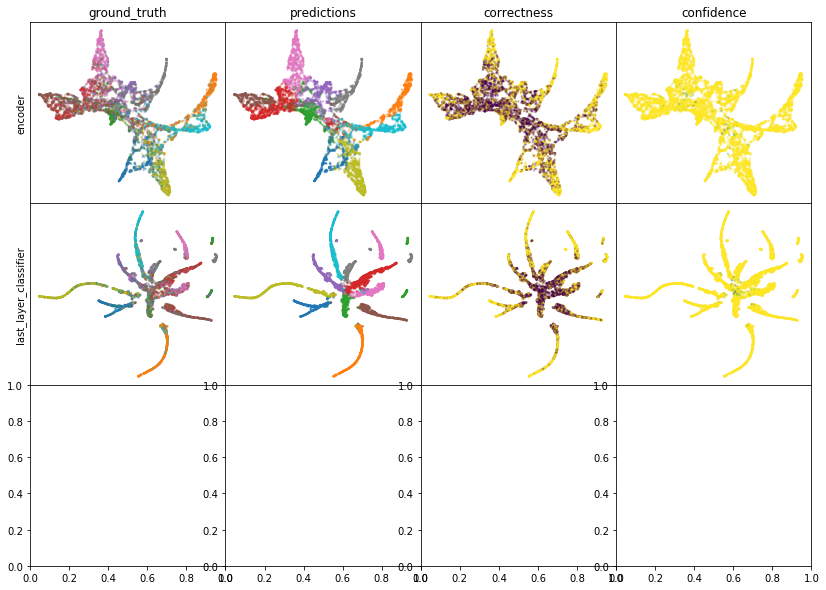

W0807 08:08:44.833458 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 08:08:45.392621 140001524946752 legend.py:1282] No handles with labels found to put in legend.
W0807 08:08:45.903376 140001524946752 legend.py:1282] No handles with labels found to put in legend.


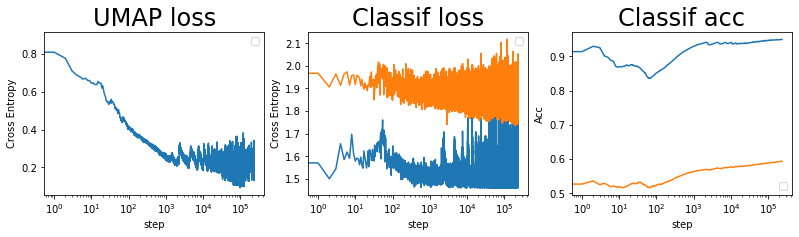

In [68]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=UMAP, cmap='tab10', cmap2='tab10')